In [1]:
#Import package pandas for data analysis
import pandas as pd
# Import package numpy for numeric computing
import numpy as np
from numpy import int64
from numpy import float64
from numpy import datetime64
# Import package matplotlib for visualisation/plotting
import matplotlib.pyplot as plt
import matplotlib.dates as dates
# Allows plots to appear directly in the notebook.
%matplotlib inline
# For dealing with some Accented characters (in Irish Place names)
import unidecode
# Date/time functionality
import datetime
import time
# Check if files exist
from os.path import exists
from os import makedirs
# System specific parameters and functions
import sys
# look at some z-scores for inspecting outliers.
from scipy import stats
import seaborn as sb
# lookup lat/long and convert lat/long to national grid references.
#import geopy
#import pyproj

from patsy import dmatrices
from sklearn import metrics

from sklearn.datasets import make_classification
from sklearn.ensemble import RandomForestClassifier
from sklearn.ensemble import RandomForestRegressor

from sklearn.linear_model import LinearRegression
from sklearn.tree import DecisionTreeClassifier
from sklearn.tree import DecisionTreeRegressor
from sklearn.tree import export_graphviz
#from sklearn.tree import export_text

from sklearn.metrics import mean_absolute_error, make_scorer
from sklearn.preprocessing import LabelEncoder

from sklearn.model_selection import cross_validate
from sklearn.model_selection import cross_val_score 
from sklearn.model_selection import RepeatedStratifiedKFold
from sklearn.model_selection import train_test_split

#import graphviz
#from graphviz import Source
#to read all CSV files in a folder
import os
import glob
import statistics
from statistics import mean

#### Functions generated at notebooks that might be useful

In [2]:
#method to read chunks from a file and create a dataframe list.
def get_chunks(x):
    """x=[location, dtypes, datecolumns ,date_parser_func]
    exp:mydateparser = lambda x: pd.to_datetime(x, format="%Y-%m-%d %H:%M:%S")
    exp:dtypes={'TRIPID' :'category','PROGRNUMBER':'int16','STOPPOINTID':'category','PLANNEDTIME_ARR':'int64','PLANNEDTIME_DEP':'int64','ACTUALTIME_ARR':'int64','ACTUALTIME_DEP':'int64','DIFFERENCETIME_ARR':'int64','DIFFERENCETIME_DEP':'int64','LINEID':'category','ROUTEID':'category','DIRECTION':'category','TRIPS_TIME_PROPORTION':'float32','TOTAL_JOURNEY_TIME':'int16','TIME_OF_DAY':'category','DAY_OF_WEEK':'category'}
    exp:x=['/Chunks/DBUS/QP_Implementation',dtypes,['ACTUALTIME_ARR_DATETIME'],mydateparser]"""
    cwd=os.getcwd()
    path = cwd+x[0]
    chunk_folder = glob.glob(os.path.join(path, "*.csv"))
    chunk_list=[]
    counter=0
    for filename in chunk_folder:
        # read the csv file
        df_chunk = pd.read_csv(filename, low_memory=False, dtype=x[1],parse_dates=x[2],date_parser=x[3])
        chunk_list.append(df_chunk)
        print('Index at chunk_list',counter,' is ', filename, ': ',df_chunk.shape)
        counter+=1
    return chunk_list
#chunk_dbus_list=get_chunks(arg_list)

In [3]:
#method to parse dates
mydateparser = lambda x: pd.to_datetime(x, format="%Y-%m-%d %H:%M:%S")

In [4]:
#method that mathes list index in a dataframe list with id information in dataframe's column. 
#for this method to work id column should be constant. 
def id_list_index_matcher(df_list, column_name):
    df_id_list_index = pd.DataFrame()
    index_count=0
    for df in df_list:
        a=df[column_name].unique()
        df_id_list_index=df_id_list_index.append({'List_index':index_count,column_name:a[0]},ignore_index=True)
        index_count+=1
    return df_id_list_index

In [5]:
#methods that create csv files from dataframe list by naming them with unique value in id column.
#for this method to work id column should be constant. 
def write_to_csv(adress,df_list,id_column ):
    cwd=os.getcwd()
    path = cwd+adress
    for df in df_list:
        a=df[id_column].unique()
        file_name=a[0]
        saved_file_name=file_name+'.csv'
        my_file_bool=os.path.exists(path+saved_file_name)
        if my_file_bool==False:
            df.to_csv(path+saved_file_name,index=False)
            print('Location:', path+saved_file_name)

In [6]:
def write_to_csv_n_r_p(adress,df_list,id_column ):
    """without relative path input"""
    path = adress
    for df in df_list:
        a=df[id_column].unique()
        file_name=a[0]
        saved_file_name=file_name+'.csv'
        my_file_bool=os.path.exists(path+saved_file_name)
        if my_file_bool==False:
            df.to_csv(path+saved_file_name,index=False)
            print('Location:', path+saved_file_name)

In [7]:
#method that takes a dataframe list and prints list lenght and sum of all rows in all dataframes
def df_list_checker(dflist):
    print("number of df in list: ",len(dflist))
    row_count=0
    for df in dflist:
        row_count+=df.shape[0]
    print("number of rows of data in list: ", row_count)

In [8]:
#method to yield(return generator object) dfs for memory efficent concat( to avoid expotential memory use)
#https://stackoverflow.com/questions/70911236/how-can-i-concat-the-huge-pandas-dataframes-into-one
def yield_dfs(x):
    """x=[location, dtypes, datecolumns ,date_parser_func]
    exp:mydateparser = lambda x: pd.to_datetime(x, format="%Y-%m-%d %H:%M:%S")
    exp:dtypes={'TRIPID' :'category','PROGRNUMBER':'int16','STOPPOINTID':'category','PLANNEDTIME_ARR':'int64','PLANNEDTIME_DEP':'int64','ACTUALTIME_ARR':'int64','ACTUALTIME_DEP':'int64','DIFFERENCETIME_ARR':'int64','DIFFERENCETIME_DEP':'int64','LINEID':'category','ROUTEID':'category','DIRECTION':'category','TRIPS_TIME_PROPORTION':'float32','TOTAL_JOURNEY_TIME':'int16','TIME_OF_DAY':'category','DAY_OF_WEEK':'category'}
    exp:x=['/Chunks/DBUS/QP_Implementation',dtypes,['ACTUALTIME_ARR_DATETIME'],mydateparser]"""
    cwd=os.getcwd()
    path = cwd+x[0]
    file_list = glob.glob(os.path.join(path, "*.csv"))
    """generator function to yield dataframes."""
    for filename in file_list:
        df = pd.read_csv(filename, low_memory=False, dtype=x[1],parse_dates=x[2],date_parser=x[3],index_col=False)
        print(df.shape)
        yield df

#df_dbus = pd.concat(yield_dfs(x), axis=0,ignore_index=True)

In [9]:
#method that takes a directory and reads all files inside that directory and its subdirectories 
#creates a dataframe from them and add to dataframe list
def get_chunks_subdirectory(location):
    cwd=os.getcwd()
    adress=location
    path = cwd+adress
    chunk_list=[]
    for root, dirnames, files in os.walk(path):
        print(dirnames)
        print('='*66)
        for mfile in files:
            # read the csv file
            df_chunk = pd.read_csv(os.path.join(root, mfile), low_memory=False)
            chunk_list.append(df_chunk)
            print('Location:', mfile)
    return chunk_list
#chunk_dbus_list_v2=get_chunks_subdirectory('/Chunks/DBUS/LINEID_CHUNKS/')

In [10]:
dtype={'TRIPID' :'category','PROGRNUMBER':'int16','STOPPOINTID':'category','PLANNEDTIME_ARR':'int64','PLANNEDTIME_DEP':'int64','ACTUALTIME_ARR':'int64','ACTUALTIME_DEP':'int64','DIFFERENCETIME_ARR':'int64','DIFFERENCETIME_DEP':'int64','LINEID':'category','ROUTEID':'category','DIRECTION':'category','TRIPS_TIME_PROPORTION':'float32','TOTAL_JOURNEY_TIME':'int16','TIME_OF_DAY':'category','DAY_OF_WEEK':'category'}
arg_list=['/Chunks/DBUS/ROUTEID_CHUNKS_CVS',dtype,['ACTUALTIME_ARR_DATETIME'],mydateparser]
dbus_df_list=get_chunks(arg_list)

Index at chunk_list 0  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/33D_61.csv :  (4575, 17)
Index at chunk_list 1  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/15B_56.csv :  (2821, 17)
Index at chunk_list 2  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/18_3.csv :  (826557, 17)
Index at chunk_list 3  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/67_6.csv :  (775062, 17)
Index at chunk_list 4  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/75_20.csv :  (15926, 17)
Index at chunk_list 5  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/142_9.csv :  (23881, 17)
Index at chunk_list 6  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/145_107.csv :  (5463, 17)
Index at chunk_list 7  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/17_16.csv :  (29666, 17)
Index at chunk_list 8  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/46A_74.csv :  (2094278, 17)
Index 

Index at chunk_list 74  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/41_6.csv :  (10461, 17)
Index at chunk_list 75  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/15B_64.csv :  (190587, 17)
Index at chunk_list 76  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/4_13.csv :  (10257, 17)
Index at chunk_list 77  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/77A_29.csv :  (930359, 17)
Index at chunk_list 78  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/44_40.csv :  (439568, 17)
Index at chunk_list 79  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/47_138.csv :  (51263, 17)
Index at chunk_list 80  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/40D_102.csv :  (368973, 17)
Index at chunk_list 81  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/83_16.csv :  (980052, 17)
Index at chunk_list 82  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/68A_86.csv :  (176

Index at chunk_list 148  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/142_13.csv :  (41024, 17)
Index at chunk_list 149  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/111_10.csv :  (3552, 17)
Index at chunk_list 150  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/14_16.csv :  (1290699, 17)
Index at chunk_list 151  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/15A_83.csv :  (614112, 17)
Index at chunk_list 152  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/84X_59.csv :  (931, 17)
Index at chunk_list 153  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/51D_51.csv :  (28730, 17)
Index at chunk_list 154  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/49_29.csv :  (11382, 17)
Index at chunk_list 155  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/39_21.csv :  (971904, 17)
Index at chunk_list 156  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/140_16.csv 

Index at chunk_list 221  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/7A_89.csv :  (90863, 17)
Index at chunk_list 222  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/111_7.csv :  (178931, 17)
Index at chunk_list 223  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/27X_43.csv :  (20061, 17)
Index at chunk_list 224  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/40_29.csv :  (14442, 17)
Index at chunk_list 225  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/41X_131.csv :  (141, 17)
Index at chunk_list 226  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/185_50.csv :  (31278, 17)
Index at chunk_list 227  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/26_24.csv :  (80338, 17)
Index at chunk_list 228  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/40_32.csv :  (29196, 17)
Index at chunk_list 229  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/84_28.csv :  (

Index at chunk_list 295  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/54A_11.csv :  (407360, 17)
Index at chunk_list 296  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/15_20.csv :  (6359, 17)
Index at chunk_list 297  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/84_29.csv :  (11649, 17)
Index at chunk_list 298  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/83_27.csv :  (9770, 17)
Index at chunk_list 299  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/47_139.csv :  (263370, 17)
Index at chunk_list 300  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/41C_84.csv :  (56880, 17)
Index at chunk_list 301  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/27B_27.csv :  (15243, 17)
Index at chunk_list 302  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/185_53.csv :  (40228, 17)
Index at chunk_list 303  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/9_5.csv :  (

Index at chunk_list 369  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/31A_25.csv :  (215339, 17)
Index at chunk_list 370  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/65_72.csv :  (140796, 17)
Index at chunk_list 371  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/33B_58.csv :  (166054, 17)
Index at chunk_list 372  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/41X_108.csv :  (996, 17)
Index at chunk_list 373  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/33X_48.csv :  (12340, 17)
Index at chunk_list 374  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/69X_59.csv :  (5001, 17)
Index at chunk_list 375  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/31_16.csv :  (10559, 17)
Index at chunk_list 376  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/41_7.csv :  (808766, 17)
Index at chunk_list 377  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/41X_117.csv

Index at chunk_list 442  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/104_16.csv :  (135076, 17)
Index at chunk_list 443  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/69_45.csv :  (176777, 17)
Index at chunk_list 444  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/41_22.csv :  (51534, 17)
Index at chunk_list 445  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/17A_15.csv :  (590993, 17)
Index at chunk_list 446  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/185_51.csv :  (8122, 17)
Index at chunk_list 447  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/83_28.csv :  (931, 17)
Index at chunk_list 448  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/220_14.csv :  (20354, 17)
Index at chunk_list 449  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/68_66.csv :  (30610, 17)
Index at chunk_list 450  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/185_52.csv : 

Index at chunk_list 516  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/61_107.csv :  (22480, 17)
Index at chunk_list 517  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/17_13.csv :  (24030, 17)
Index at chunk_list 518  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/40E_91.csv :  (16571, 17)
Index at chunk_list 519  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/46A_64.csv :  (12831, 17)
Index at chunk_list 520  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/142_10.csv :  (8248, 17)
Index at chunk_list 521  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/13_61.csv :  (596998, 17)
Index at chunk_list 522  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/7A_88.csv :  (244252, 17)
Index at chunk_list 523  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/66X_99.csv :  (1295, 17)
Index at chunk_list 524  is  /home/team8/notebook/Pelin/Chunks/DBUS/ROUTEID_CHUNKS_CVS/41C_80.csv :

In [14]:
df_list_checker(dbus_df_list)

number of df in list:  588
number of rows of data in list:  116798953


In [15]:
dbus_df_list[10].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,LINEID,ROUTEID,DIRECTION,ACTUALTIME_ARR_DATETIME,TRIPS_TIME_PROPORTION,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK
0,6397095,1,4320,34500,34500,34626,34626,126,126,145,145_95,1,2018-03-07 09:37:06,0.083588,2943,09,07
1,6403303,1,4320,33600,33600,33418,33418,-182,-182,145,145_95,1,2018-03-07 09:16:58,0.037432,3286,09,07
2,6396194,1,4320,33900,33900,33908,33908,8,8,145,145_95,1,2018-03-07 09:25:08,0.125274,3193,09,07
3,6397095,2,1476,34600,34600,34891,34891,291,291,145,145_95,1,2018-03-07 09:41:31,0.173632,2943,09,07
4,6386715,2,1476,33476,33476,33134,33134,-342,-342,145,145_95,1,2018-03-07 09:12:14,0.306679,4327,09,07


Check interactions STOPPOINTID PROGRNUMBER for each ROUTEID 

In [20]:
PROGRNUMBER_GB_STOPPOINTID=[]
Comb_counter_STOPPOINTID_ROUTEID=0
DIRECTION_list=[]
for df in dbus_df_list:
    print('='*66)
    print("ROUTEID is ",df['ROUTEID'].unique()[0])
    y=df['STOPPOINTID'].nunique()
    print("There is ",y , " STOPPOINTID for this ROUTEID.")    
    Comb_counter_STOPPOINTID_ROUTEID+=y
    print("There is ", df['TRIPID'].nunique(), " TRIPID for this ROUTEID.") 
    z=df['DIRECTION'].nunique()
    DIRECTION_list.append(z)
    print("There is ", df['DIRECTION'].nunique(), " DIRECTION for this ROUTEID.")  
    x=(df.groupby(['STOPPOINTID']))['PROGRNUMBER'].nunique().max()
    PROGRNUMBER_GB_STOPPOINTID.append(x)
    print("'STOPPOINTID',have maksimum ",x," unique 'PROGRNUMBER' value for this ROUTEID." )
    print("'STOPPOINTID','DIRECTION' combinations have maksimum ",(df.groupby(['STOPPOINTID','DIRECTION']))['PROGRNUMBER'].nunique().max()," unique 'PROGRNUMBER' value for this ROUTEID." )

print('='*66)
print("Maksimum unique number of PROGRNUMBER grouped by STOPPOINTID and ROUTEID is ", max(PROGRNUMBER_GB_STOPPOINTID))
print("Maksimum unique number of  DIRECTION grouped by STOPPOINTID and ROUTEID is ", max(DIRECTION_list))
print("Total number of STOPPOINTID+ROUTEID combination is ", Comb_counter_STOPPOINTID_ROUTEID)

ROUTEID is  33D_61
There is  23  STOPPOINTID for this ROUTEID.
There is  35  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  15B_56
There is  49  STOPPOINTID for this ROUTEID.
There is  21  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  18_3
There is  64  STOPPOINTID for this ROUTEID.
There is  3904  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  67_6
There is  65  STO

'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  51X_64
There is  48  STOPPOINTID for this ROUTEID.
There is  36  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  102_8
There is  53  STOPPOINTID for this ROUTEID.
There is  2870  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  41X_121
There is  52  STOPPOINTID for this ROUTEID.
There is  66  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  2  

'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  13_68
There is  90  STOPPOINTID for this ROUTEID.
There is  2163  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  46A_71
There is  32  STOPPOINTID for this ROUTEID.
There is  33  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  70D_70
There is  36  STOPPOINTID for this ROUTEID.
There is  33  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combina

'STOPPOINTID','DIRECTION' combinations have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  25X_11
There is  41  STOPPOINTID for this ROUTEID.
There is  72  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  41_10
There is  32  STOPPOINTID for this ROUTEID.
There is  75  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  41_6
There is  50  STOPPOINTID for this ROUTEID.
There is  39  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combination

There is  44  STOPPOINTID for this ROUTEID.
There is  6559  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  40E_90
There is  32  STOPPOINTID for this ROUTEID.
There is  220  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  41X_130
There is  39  STOPPOINTID for this ROUTEID.
There is  3  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  38_10
There is  61  STOPPOINTID for th

'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  15_17
There is  71  STOPPOINTID for this ROUTEID.
There is  8118  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  123_36
There is  47  STOPPOINTID for this ROUTEID.
There is  7205  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  40D_101
There is  46  STOPPOINTID for this ROUTEID.
There is  2018  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum 

'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  140_22
There is  19  STOPPOINTID for this ROUTEID.
There is  120  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  142_13
There is  55  STOPPOINTID for this ROUTEID.
There is  155  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  111_10
There is  15  STOPPOINTID for this ROUTEID.
There is  64  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  

There is  289  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  66_13
There is  53  STOPPOINTID for this ROUTEID.
There is  1456  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  41X_129
There is  48  STOPPOINTID for this ROUTEID.
There is  6  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  185_56
There is  18  STOPPOINTID for this ROUTEID.
There is  846  TRIPID for this R

'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  239_28
There is  30  STOPPOINTID for this ROUTEID.
There is  976  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  38A_20
There is  46  STOPPOINTID for this ROUTEID.
There is  2674  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  46A_69
There is  32  STOPPOINTID for this ROUTEID.
There is  42  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1 

'STOPPOINTID','DIRECTION' combinations have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  270_42
There is  17  STOPPOINTID for this ROUTEID.
There is  1872  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  7A_89
There is  65  STOPPOINTID for this ROUTEID.
There is  238  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  111_7
There is  46  STOPPOINTID for this ROUTEID.
There is  1132  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combi

There is  51  STOPPOINTID for this ROUTEID.
There is  1780  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  44B_61
There is  26  STOPPOINTID for this ROUTEID.
There is  209  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  77X_62
There is  65  STOPPOINTID for this ROUTEID.
There is  8  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  45A_64
There is  61  STOPPOINTID for th

'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  140_21
There is  47  STOPPOINTID for this ROUTEID.
There is  5960  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  145_104
There is  51  STOPPOINTID for this ROUTEID.
There is  68  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  25B_274
There is  40  STOPPOINTID for this ROUTEID.
There is  4367  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum 

'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  47_139
There is  52  STOPPOINTID for this ROUTEID.
There is  1846  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  41C_84
There is  60  STOPPOINTID for this ROUTEID.
There is  351  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  27B_27
There is  33  STOPPOINTID for this ROUTEID.
There is  84  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1 

'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  151_17
There is  51  STOPPOINTID for this ROUTEID.
There is  4355  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  70_60
There is  47  STOPPOINTID for this ROUTEID.
There is  1871  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  4_11
There is  25  STOPPOINTID for this ROUTEID.
There is  159  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combin

There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  66_16
There is  54  STOPPOINTID for this ROUTEID.
There is  35  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  39A_42
There is  50  STOPPOINTID for this ROUTEID.
There is  238  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  61_108
There is  49  STOPPOINTID for this ROUTEID.
There is  1837  TRIPID for this ROUTEID.
There is  1  DIRECTION for this 

'STOPPOINTID',have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  33_69
There is  103  STOPPOINTID for this ROUTEID.
There is  37  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  27B_39
There is  31  STOPPOINTID for this ROUTEID.
There is  42  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  31A_25
There is  74  STOPPOINTID for this ROUTEID.
There is  841  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  u

There is  2431  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  17_12
There is  14  STOPPOINTID for this ROUTEID.
There is  42  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  43_84
There is  51  STOPPOINTID for this ROUTEID.
There is  2255  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  16_22
There is  60  STOPPOINTID for this ROUTEID.
There is  42  TRIPID for this ROU

'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  33A_22
There is  64  STOPPOINTID for this ROUTEID.
There is  503  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  122_18
There is  50  STOPPOINTID for this ROUTEID.
There is  1628  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  7B_91
There is  53  STOPPOINTID for this ROUTEID.
There is  168  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combi

'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  185_51
There is  8  STOPPOINTID for this ROUTEID.
There is  228  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  83_28
There is  37  STOPPOINTID for this ROUTEID.
There is  11  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  220_14
There is  85  STOPPOINTID for this ROUTEID.
There is  42  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinati

There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  17_11
There is  66  STOPPOINTID for this ROUTEID.
There is  302  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  17A_18
There is  59  STOPPOINTID for this ROUTEID.
There is  229  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  185_62
There is  24  STOPPOINTID for this ROUTEID.
There is  34  TRIPID for this ROUTEID.
There is  1  DIRECTION for this R

'STOPPOINTID','DIRECTION' combinations have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  25X_10
There is  50  STOPPOINTID for this ROUTEID.
There is  72  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  40D_105
There is  45  STOPPOINTID for this ROUTEID.
There is  126  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  75_17
There is  79  STOPPOINTID for this ROUTEID.
There is  2717  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  2  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combi

'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  7A_88
There is  64  STOPPOINTID for this ROUTEID.
There is  1281  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  66X_99
There is  42  STOPPOINTID for this ROUTEID.
There is  6  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  41C_80
There is  42  STOPPOINTID for this ROUTEID.
There is  360  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combina

'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  37_13
There is  53  STOPPOINTID for this ROUTEID.
There is  124  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  45A_69
There is  65  STOPPOINTID for this ROUTEID.
There is  63  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  111_9
There is  48  STOPPOINTID for this ROUTEID.
There is  191  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinat

'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  77A_31
There is  69  STOPPOINTID for this ROUTEID.
There is  972  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  120_12
There is  26  STOPPOINTID for this ROUTEID.
There is  940  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
'STOPPOINTID','DIRECTION' combinations have maksimum  1  unique 'PROGRNUMBER' value for this ROUTEID.
ROUTEID is  7_71
There is  57  STOPPOINTID for this ROUTEID.
There is  1152  TRIPID for this ROUTEID.
There is  1  DIRECTION for this ROUTEID.
'STOPPOINTID',have maksimum  1  

"Maksimum unique number of  DIRECTION grouped by STOPPOINTID and ROUTEID is 1" from this we verified routeid represents directions therefore we can drop this category column as now it become constant, we will also drop lineid column as it is also constant now.

In [21]:
for df in dbus_df_list:
    df.drop(['DIRECTION','LINEID'],axis=1,inplace=True)

In [22]:
dbus_df_list[40].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,ACTUALTIME_ARR_DATETIME,TRIPS_TIME_PROPORTION,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK
0,6403305,1,767,63000,63000,62989,62989,-11,-11,145_99,2018-03-07 17:29:49,0.014165,3671,17,07
1,6401942,1,767,57600,57600,57686,57686,86,86,145_99,2018-03-07 16:01:26,0.028846,4368,16,07
2,6401943,1,767,63600,63600,63608,63608,8,8,145_99,2018-03-07 17:40:08,0.019427,4221,17,07
3,6403304,1,767,56700,56700,56945,56945,245,245,145_99,2018-03-07 15:49:05,0.062595,4601,15,07
4,6403305,2,2007,63155,63155,63175,63240,20,85,145_99,2018-03-07 17:32:55,0.064832,3671,17,07


In [23]:
write_to_csv('/Chunks/DBUS/Merging_implementation/',dbus_df_list,'ROUTEID' )

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33D_61.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_56.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/18_3.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67_6.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/75_20.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/142_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/145_107.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/46A_74.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/122_14.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/145_95.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/150_8.csv
Location: /

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/120_8.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/38B_45.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66X_92.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/51X_63.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31D_50.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/1_38.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/46A_72.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_39.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27B_23.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_72.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/47_137.csv
Location:

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/40D_104.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/68A_87.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/53_21.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41X_125.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/102_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/38B_40.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84A_2.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/185_60.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/185_58.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27A_7.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41X_128.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_25.csv
Locati

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/185_53.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/9_5.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/4_12.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31B_46.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27B_36.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/46A_70.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/43_89.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/1_40.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/69_44.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/26_26.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/63_29.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7D_120.csv
Location: /home

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/38_13.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/69_43.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_3.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/75_19.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27_17.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/40B_64.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33A_25.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/120_11.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/47_135.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/76_36.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/118_4.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25_269.csv
Location: /h

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_67.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_45.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66_17.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41X_127.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31A_26.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25D_277.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/70D_71.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/43_88.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/161_52.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/145_102.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/77A_28.csv
Locat

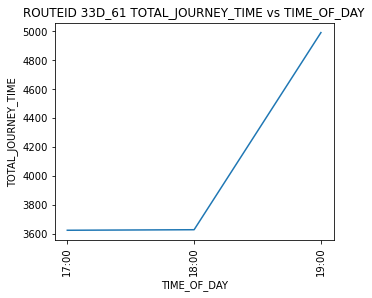

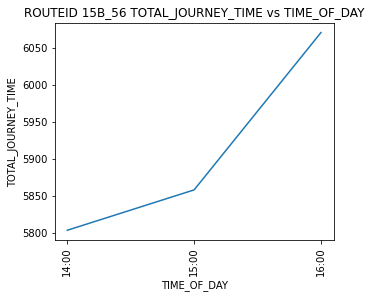

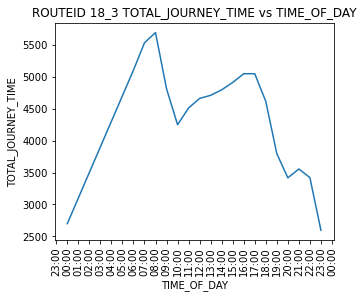

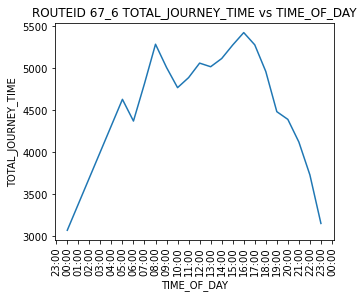

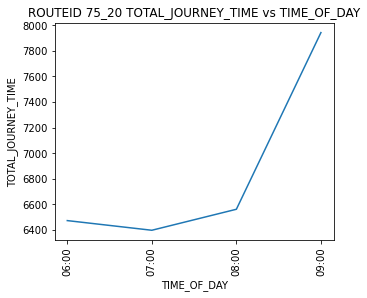

...

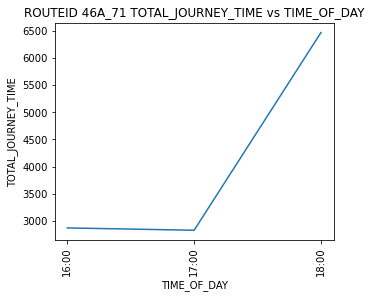

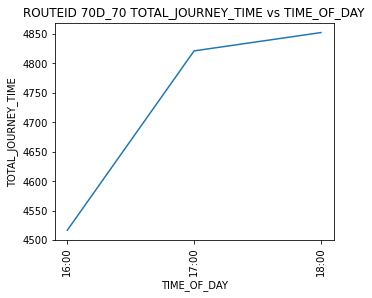

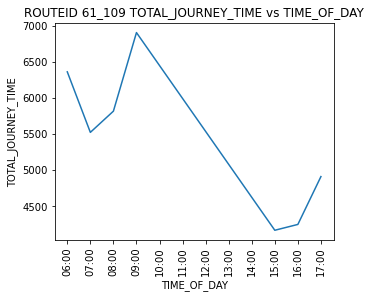

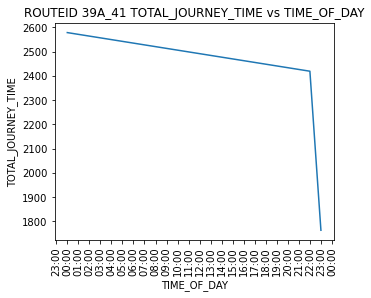

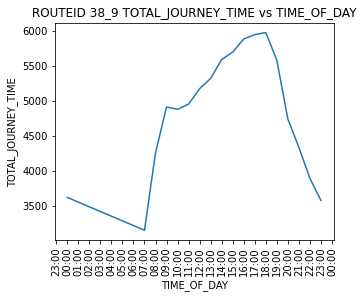

Locator attempting to generate 38545 ticks ([-26369.041666666668, ..., -24763.041666666668]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 38545 ticks ([-26369.041666666668, ..., -24763.041666666668]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 38545 ticks ([-26369.041666666668, ..., -24763.041666666668]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 38545 ticks ([-26369.041666666668, ..., -24763.041666666668]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 38545 ticks ([-26369.041666666668, ..., -24763.041666666668]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 38545 ticks ([-26369.041666666668, ..., -24763.041666666668]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 38545 ticks ([-26369.041666666668, ..., -24763.041666666668]), which exceeds Locator.MAXTICKS (1000).
Locator attempting to generate 38545 ticks ([-26369.041666666668, ...

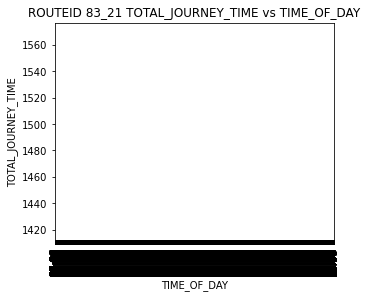

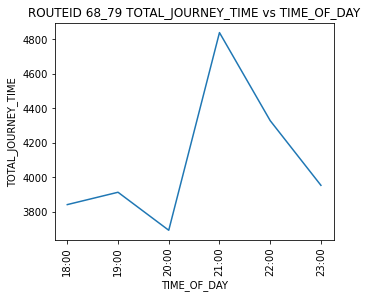

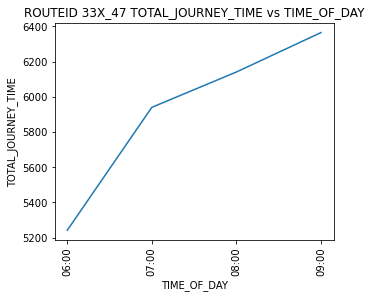

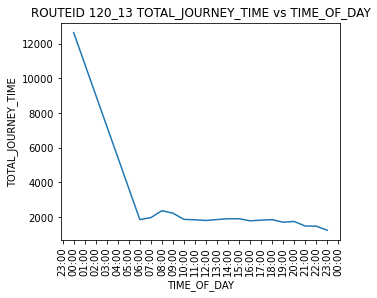

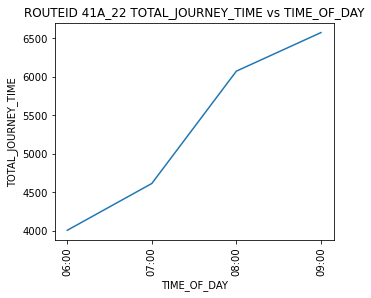

...

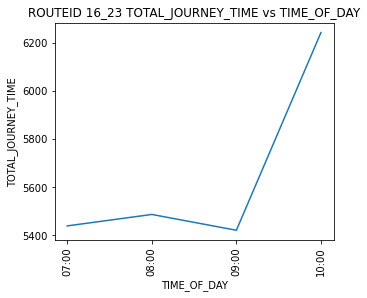

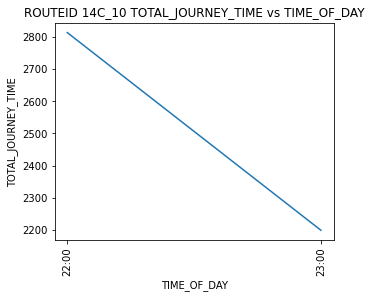

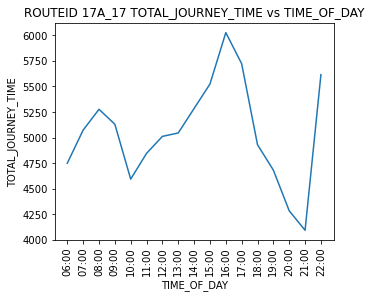

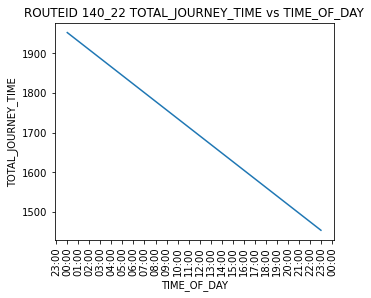

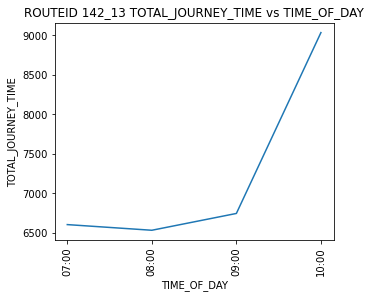

Locator attempting to generate 38545 ticks ([-26369.041666666668, ..., -24763.041666666668]), which exceeds Locator.MAXTICKS (1000).


KeyboardInterrupt: 

In [83]:
for df in dbus_df_list:
    a=df['ROUTEID'].unique()[0]
    b=pd.DataFrame(df['TOTAL_JOURNEY_TIME'].groupby(df['TIME_OF_DAY']).mean()).reset_index()
    b['TIME_OF_DAY']=pd.to_datetime(b['TIME_OF_DAY'], format='%H')
    plt.figure(figsize=(5,4)) 
    title="ROUTEID "+a+" TOTAL_JOURNEY_TIME vs TIME_OF_DAY"
    plt.title(title)
    plt.plot(b['TIME_OF_DAY'], b['TOTAL_JOURNEY_TIME'])
    plt.xticks(rotation=90)
    plt.xlabel("TIME_OF_DAY")
    plt.ylabel("TOTAL_JOURNEY_TIME")
    plt.gca().xaxis.set_major_locator(dates.HourLocator())
    plt.gca().xaxis.set_major_formatter(dates.DateFormatter('%H:%M'))
    plt.show()

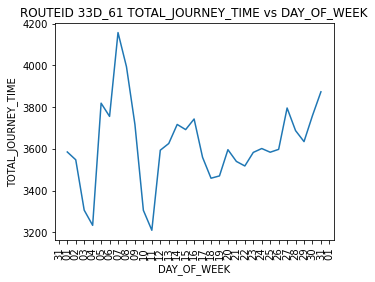

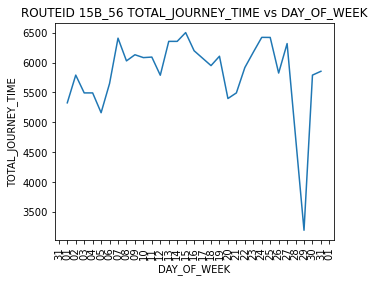

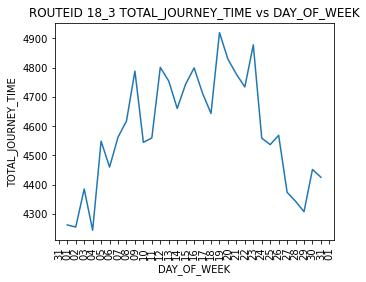

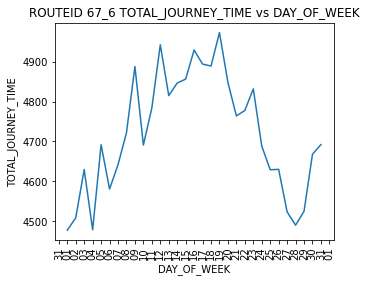

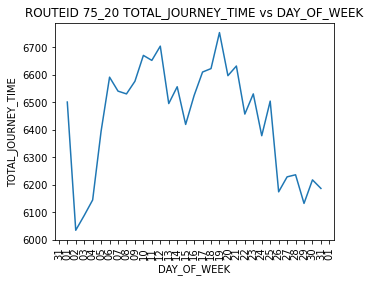

...

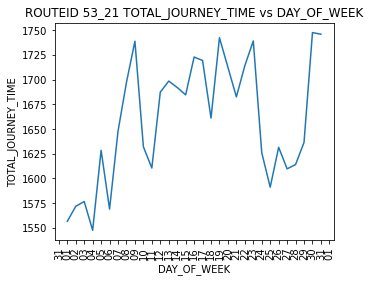

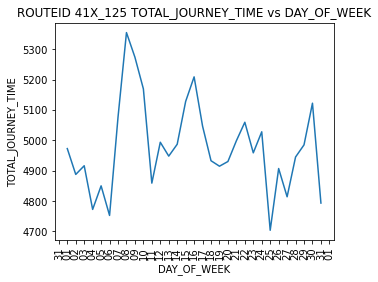

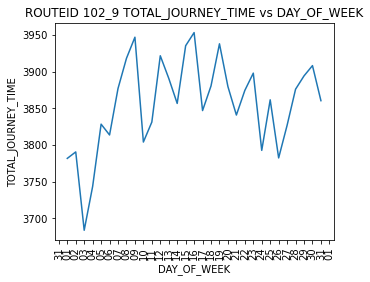

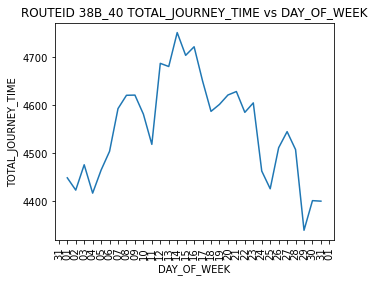

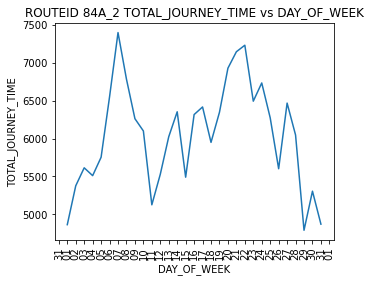

KeyboardInterrupt: 

In [86]:
for df in dbus_df_list:
    a=df['ROUTEID'].unique()[0]
    b=pd.DataFrame(df['TOTAL_JOURNEY_TIME'].groupby(df['DAY_OF_WEEK']).mean()).reset_index()
    b['DAY_OF_WEEK']=pd.to_datetime(b['DAY_OF_WEEK'], format='%d')
    plt.figure(figsize=(5,4)) 
    title="ROUTEID "+a+" TOTAL_JOURNEY_TIME vs DAY_OF_WEEK"
    plt.title(title)
    plt.plot(b['DAY_OF_WEEK'], b['TOTAL_JOURNEY_TIME'])
    plt.xticks(rotation=90)
    plt.xlabel("DAY_OF_WEEK")
    plt.ylabel("TOTAL_JOURNEY_TIME")
    plt.gca().xaxis.set_major_locator(dates.DayLocator())
    plt.gca().xaxis.set_major_formatter(dates.DateFormatter('%d'))
    plt.show()

#### fixing format of day of week column as it was previously incorrectly extracted to be day of month. 

In [4]:
dtype={'TRIPID' :'category','PROGRNUMBER':'int16','STOPPOINTID':'category','PLANNEDTIME_ARR':'int64','PLANNEDTIME_DEP':'int64','ACTUALTIME_ARR':'int64','ACTUALTIME_DEP':'int64','DIFFERENCETIME_ARR':'int64','DIFFERENCETIME_DEP':'int64','ROUTEID':'category','TRIPS_TIME_PROPORTION':'float32','TOTAL_JOURNEY_TIME':'int16','TIME_OF_DAY':'category','DAY_OF_WEEK':'category'}
arg_list=['/Chunks/DBUS/Merging_implementation',dtype,['ACTUALTIME_ARR_DATETIME'],mydateparser]
dbus_df_list=get_chunks(arg_list)

Index at chunk_list 0  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33D_61.csv :  (4575, 15)
Index at chunk_list 1  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_56.csv :  (2821, 15)
Index at chunk_list 2  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/18_3.csv :  (826557, 15)
Index at chunk_list 3  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67_6.csv :  (775062, 15)
Index at chunk_list 4  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/75_20.csv :  (15926, 15)
Index at chunk_list 5  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/142_9.csv :  (23881, 15)
Index at chunk_list 6  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/145_107.csv :  (5463, 15)
Index at chunk_list 7  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17_16.csv :  (29666, 15)
Index at chunk_list 8  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementatio

Index at chunk_list 71  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84A_3.csv :  (54410, 15)
Index at chunk_list 72  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25X_11.csv :  (16282, 15)
Index at chunk_list 73  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_10.csv :  (7605, 15)
Index at chunk_list 74  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_6.csv :  (10461, 15)
Index at chunk_list 75  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_64.csv :  (190587, 15)
Index at chunk_list 76  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/4_13.csv :  (10257, 15)
Index at chunk_list 77  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/77A_29.csv :  (930359, 15)
Index at chunk_list 78  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/44_40.csv :  (439568, 15)
Index at chunk_list 79  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_im

Index at chunk_list 144  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/16_23.csv :  (54287, 15)
Index at chunk_list 145  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/14C_10.csv :  (161, 15)
Index at chunk_list 146  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17A_17.csv :  (587575, 15)
Index at chunk_list 147  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/140_22.csv :  (6591, 15)
Index at chunk_list 148  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/142_13.csv :  (41024, 15)
Index at chunk_list 149  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/111_10.csv :  (3552, 15)
Index at chunk_list 150  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/14_16.csv :  (1290699, 15)
Index at chunk_list 151  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15A_83.csv :  (614112, 15)
Index at chunk_list 152  is  /home/team8/notebook/Pelin/Chunks/DBU

Index at chunk_list 215  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/114_6.csv :  (141552, 15)
Index at chunk_list 216  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15D_65.csv :  (1811, 15)
Index at chunk_list 217  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84X_62.csv :  (45909, 15)
Index at chunk_list 218  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/77X_61.csv :  (12738, 15)
Index at chunk_list 219  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7A_86.csv :  (180619, 15)
Index at chunk_list 220  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/270_42.csv :  (95202, 15)
Index at chunk_list 221  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7A_89.csv :  (90863, 15)
Index at chunk_list 222  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/111_7.csv :  (178931, 15)
Index at chunk_list 223  is  /home/team8/notebook/Pelin/Chunks/DBU

Index at chunk_list 288  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66B_57.csv :  (85059, 15)
Index at chunk_list 289  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/239_26.csv :  (105100, 15)
Index at chunk_list 290  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_65.csv :  (131825, 15)
Index at chunk_list 291  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84X_57.csv :  (40425, 15)
Index at chunk_list 292  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_8.csv :  (45702, 15)
Index at chunk_list 293  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/63_31.csv :  (8154, 15)
Index at chunk_list 294  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_42.csv :  (7079, 15)
Index at chunk_list 295  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/54A_11.csv :  (407360, 15)
Index at chunk_list 296  is  /home/team8/notebook/Pelin/Chunks/DBUS

Index at chunk_list 359  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_60.csv :  (804882, 15)
Index at chunk_list 360  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25X_7.csv :  (3135, 15)
Index at chunk_list 361  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/151_19.csv :  (14181, 15)
Index at chunk_list 362  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/185_54.csv :  (5892, 15)
Index at chunk_list 363  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/79_10.csv :  (359176, 15)
Index at chunk_list 364  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_40.csv :  (2489, 15)
Index at chunk_list 365  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15A_84.csv :  (501677, 15)
Index at chunk_list 366  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/16_20.csv :  (1533552, 15)
Index at chunk_list 367  is  /home/team8/notebook/Pelin/Chunks/DB

Index at chunk_list 431  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33A_26.csv :  (21346, 15)
Index at chunk_list 432  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27_12.csv :  (52888, 15)
Index at chunk_list 433  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7A_85.csv :  (526150, 15)
Index at chunk_list 434  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33_70.csv :  (410226, 15)
Index at chunk_list 435  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/238_11.csv :  (98449, 15)
Index at chunk_list 436  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15_10.csv :  (9388, 15)
Index at chunk_list 437  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66X_96.csv :  (4752, 15)
Index at chunk_list 438  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/46E_93.csv :  (4100, 15)
Index at chunk_list 439  is  /home/team8/notebook/Pelin/Chunks/DBUS/M

Index at chunk_list 502  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_67.csv :  (767187, 15)
Index at chunk_list 503  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_45.csv :  (15202, 15)
Index at chunk_list 504  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66_17.csv :  (403689, 15)
Index at chunk_list 505  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41X_127.csv :  (1756, 15)
Index at chunk_list 506  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31_15.csv :  (595586, 15)
Index at chunk_list 507  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31A_26.csv :  (217823, 15)
Index at chunk_list 508  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25D_277.csv :  (24270, 15)
Index at chunk_list 509  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/70D_71.csv :  (7204, 15)
Index at chunk_list 510  is  /home/team8/notebook/Pelin/Chunks/

Index at chunk_list 573  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_62.csv :  (36018, 15)
Index at chunk_list 574  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/83A_20.csv :  (48092, 15)
Index at chunk_list 575  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/39_20.csv :  (802676, 15)
Index at chunk_list 576  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/63_26.csv :  (230720, 15)
Index at chunk_list 577  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66B_58.csv :  (161625, 15)
Index at chunk_list 578  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/42D_50.csv :  (5484, 15)
Index at chunk_list 579  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/236_10.csv :  (14681, 15)
Index at chunk_list 580  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17_10.csv :  (508784, 15)
Index at chunk_list 581  is  /home/team8/notebook/Pelin/Chunks/DB

In [5]:
for df in dbus_df_list:
    df.drop(['DAY_OF_WEEK'],axis=1,inplace=True)

In [7]:
for df in dbus_df_list:
    df['DAY_OF_WEEK']=df['ACTUALTIME_ARR_DATETIME'].dt.strftime('%A')

In [10]:
dbus_df_list[36].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,ACTUALTIME_ARR_DATETIME,TRIPS_TIME_PROPORTION,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK
0,7657352,72,1518,52215,52215,52702,52714,487,499,40_31,2018-09-03 14:38:22,0.891644,6331,14,Monday
1,7657352,77,4546,52425,52425,52888,52897,463,472,40_31,2018-09-03 14:41:28,0.921024,6331,14,Monday
2,7657352,79,987,52676,52676,53047,53072,371,396,40_31,2018-09-03 14:44:07,0.946138,6331,14,Monday
3,7657352,84,6348,52972,52972,53388,53388,416,416,40_31,2018-09-03 14:49:48,1.000000,6331,14,Monday
4,7657354,4,4410,61828,61828,61874,61874,46,46,40_31,2018-09-03 17:11:14,0.071602,6592,17,Monday


In [13]:
write_to_csv('/Chunks/DBUS/Merging_implementation_backup/',dbus_df_list,'ROUTEID' )

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33D_61.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/15B_56.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/18_3.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67_6.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/75_20.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/142_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_107.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/46A_74.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/122_14.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_95.csv
Location: /home/

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/7_70.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/184_28.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/140_19.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/40E_90.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_130.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38_10.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/46A_67.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/83A_26.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27B_38.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/120_8.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38B_45.csv
Location: /ho

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/11_40.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/83_22.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66X_97.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/151_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84_31.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66A_37.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_61.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67X_43.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41B_51.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_71.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/150_10.csv
Location: /hom

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/31_18.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67X_38.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/39A_43.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/56A_30.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33B_56.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_17.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_14.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/9_6.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_64.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66B_57.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/239_26.csv
Location: /home/t

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33B_58.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_108.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33X_48.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/69X_59.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/31_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_7.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_117.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_93.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/7A_87.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27_21.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_70.csv
Location: /hom

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33_44.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_64.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25B_271.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/151_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17A_13.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25A_273.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_11.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17A_18.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/185_62.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_67.csv
Location: /h

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38D_68.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25B_276.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_60.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_65.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/220_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/32X_76.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/16D_30.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/16C_26.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_68.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_60.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/77A_31.csv
Location: 

In [6]:
dtype={'TRIPID' :'category','PROGRNUMBER':'int16','STOPPOINTID':'category','PLANNEDTIME_ARR':'int64','PLANNEDTIME_DEP':'int64','ACTUALTIME_ARR':'int64','ACTUALTIME_DEP':'int64','DIFFERENCETIME_ARR':'int64','DIFFERENCETIME_DEP':'int64','ROUTEID':'category','TRIPS_TIME_PROPORTION':'float32','TOTAL_JOURNEY_TIME':'int16','TIME_OF_DAY':'category','DAY_OF_WEEK':'category'}
arg_list=['/Chunks/DBUS/Merging_implementation_backup',dtype,['ACTUALTIME_ARR_DATETIME'],mydateparser]
dbus_df_list=get_chunks(arg_list)

Index at chunk_list 0  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33D_61.csv :  (4575, 15)
Index at chunk_list 1  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/15B_56.csv :  (2821, 15)
Index at chunk_list 2  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/18_3.csv :  (826557, 15)
Index at chunk_list 3  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67_6.csv :  (775062, 15)
Index at chunk_list 4  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/75_20.csv :  (15926, 15)
Index at chunk_list 5  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/142_9.csv :  (23881, 15)
Index at chunk_list 6  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_107.csv :  (5463, 15)
Index at chunk_list 7  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_16.csv :  (29666, 15)
Index at chunk_list 8  is  /hom

Index at chunk_list 68  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/69_46.csv :  (10009, 15)
Index at chunk_list 69  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/16C_28.csv :  (27325, 15)
Index at chunk_list 70  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/40_28.csv :  (13184, 15)
Index at chunk_list 71  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84A_3.csv :  (54410, 15)
Index at chunk_list 72  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25X_11.csv :  (16282, 15)
Index at chunk_list 73  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_10.csv :  (7605, 15)
Index at chunk_list 74  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_6.csv :  (10461, 15)
Index at chunk_list 75  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/15B_64.csv :  (190587, 15)
Index at chunk_list 76

Index at chunk_list 135  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66B_55.csv :  (98266, 15)
Index at chunk_list 136  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/4_14.csv :  (136436, 15)
Index at chunk_list 137  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/9_7.csv :  (1391972, 15)
Index at chunk_list 138  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/79A_28.csv :  (266196, 15)
Index at chunk_list 139  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/75_18.csv :  (86250, 15)
Index at chunk_list 140  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/142_12.csv :  (46872, 15)
Index at chunk_list 141  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_4.csv :  (8579, 15)
Index at chunk_list 142  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_63.csv :  (3258, 15)
Index at chunk

Index at chunk_list 202  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/40D_104.csv :  (350989, 15)
Index at chunk_list 203  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/68A_87.csv :  (13154, 15)
Index at chunk_list 204  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/53_21.csv :  (74765, 15)
Index at chunk_list 205  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_125.csv :  (15664, 15)
Index at chunk_list 206  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/102_9.csv :  (478863, 15)
Index at chunk_list 207  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38B_40.csv :  (58460, 15)
Index at chunk_list 208  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84A_2.csv :  (8218, 15)
Index at chunk_list 209  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/185_60.csv :  (4953, 15)
Index at 

Index at chunk_list 269  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_73.csv :  (55435, 15)
Index at chunk_list 270  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/120_10.csv :  (4106, 15)
Index at chunk_list 271  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/184_29.csv :  (336262, 15)
Index at chunk_list 272  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/140_21.csv :  (903010, 15)
Index at chunk_list 273  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_104.csv :  (8649, 15)
Index at chunk_list 274  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25B_274.csv :  (555506, 15)
Index at chunk_list 275  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/220_10.csv :  (208084, 15)
Index at chunk_list 276  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/15_18.csv :  (31950, 15)
Index 

Index at chunk_list 336  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/44_36.csv :  (448610, 15)
Index at chunk_list 337  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/61_106.csv :  (246711, 15)
Index at chunk_list 338  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33A_23.csv :  (12277, 15)
Index at chunk_list 339  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41C_78.csv :  (740820, 15)
Index at chunk_list 340  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/1_39.csv :  (8045, 15)
Index at chunk_list 341  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/65B_66.csv :  (347417, 15)
Index at chunk_list 342  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/49_27.csv :  (475452, 15)
Index at chunk_list 343  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38_14.csv :  (527184, 15)
Index at

Index at chunk_list 403  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/69_43.csv :  (134787, 15)
Index at chunk_list 404  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_3.csv :  (707418, 15)
Index at chunk_list 405  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/75_19.csv :  (665283, 15)
Index at chunk_list 406  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27_17.csv :  (1978947, 15)
Index at chunk_list 407  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/40B_64.csv :  (7002, 15)
Index at chunk_list 408  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33A_25.csv :  (97788, 15)
Index at chunk_list 409  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/120_11.csv :  (20512, 15)
Index at chunk_list 410  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/47_135.csv :  (63728, 15)
Index at 

Index at chunk_list 471  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17A_18.csv :  (67955, 15)
Index at chunk_list 472  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/185_62.csv :  (3729, 15)
Index at chunk_list 473  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_67.csv :  (12996, 15)
Index at chunk_list 474  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27X_42.csv :  (21397, 15)
Index at chunk_list 475  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_63.csv :  (149993, 15)
Index at chunk_list 476  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_21.csv :  (2063, 15)
Index at chunk_list 477  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66B_59.csv :  (139636, 15)
Index at chunk_list 478  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/37_15.csv :  (963643, 15)
Index at c

Index at chunk_list 538  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/76A_28.csv :  (27788, 15)
Index at chunk_list 539  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_70.csv :  (136336, 15)
Index at chunk_list 540  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66X_105.csv :  (8189, 15)
Index at chunk_list 541  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/1_37.csv :  (596367, 15)
Index at chunk_list 542  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/114_5.csv :  (139632, 15)
Index at chunk_list 543  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/77A_30.csv :  (209523, 15)
Index at chunk_list 544  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_60.csv :  (332975, 15)
Index at chunk_list 545  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/37_13.csv :  (26307, 15)
Index a

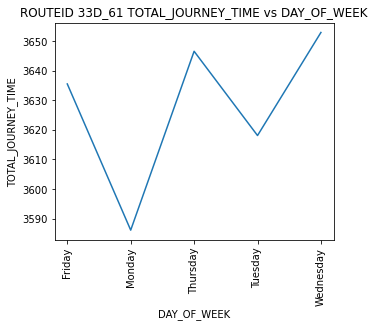

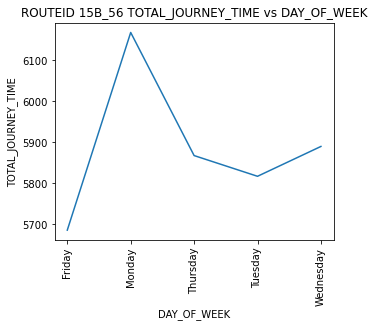

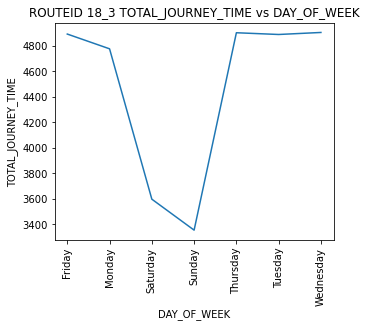

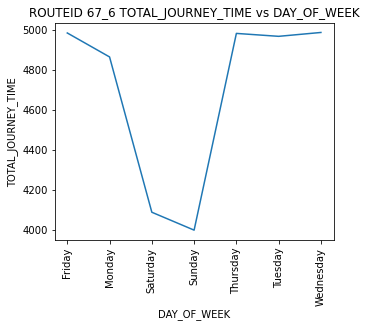

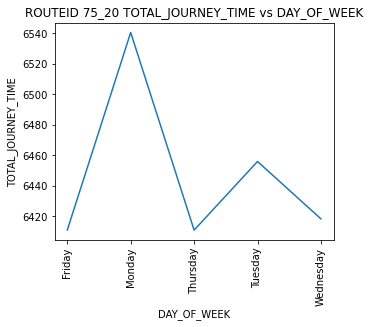

...

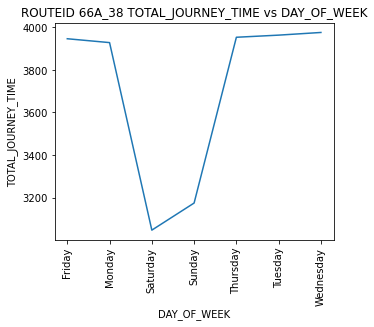

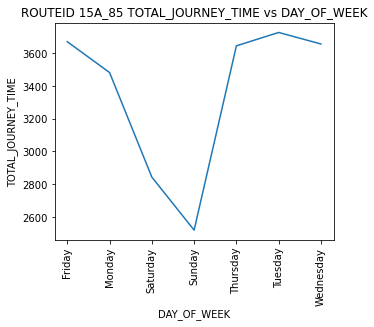

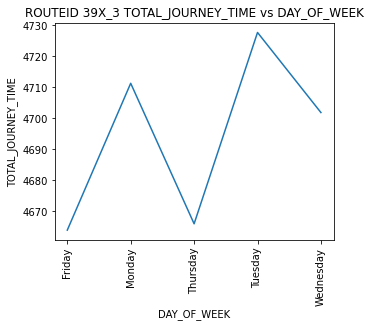

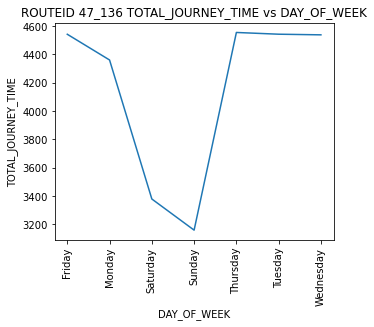

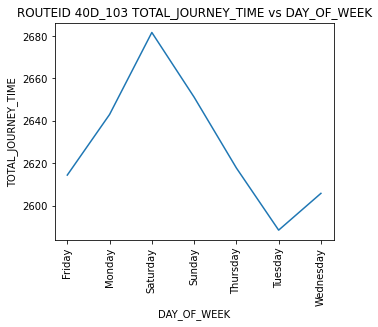

In [16]:
for df in dbus_df_list:
    a=df['ROUTEID'].unique()[0]
    b=pd.DataFrame(df['TOTAL_JOURNEY_TIME'].groupby(df['DAY_OF_WEEK']).mean()).reset_index()
    plt.figure(figsize=(5,4)) 
    title="ROUTEID "+a+" TOTAL_JOURNEY_TIME vs DAY_OF_WEEK"
    plt.title(title)
    plt.plot(b['DAY_OF_WEEK'], b['TOTAL_JOURNEY_TIME'])
    plt.xticks(rotation=90)
    plt.xlabel("DAY_OF_WEEK")
    plt.ylabel("TOTAL_JOURNEY_TIME")
    plt.show()

### Merging with weather dataframe

In [7]:
wdtypes={'Temperature':'float16','Wind Speed':'float16','Precipitation':'float16','Cloud Cover':'float16'}
wdateparser = lambda x: pd.to_datetime(x, format="%m/%d/%Y")
cols=['Date time','Temperature','Wind Speed','Precipitation','Cloud Cover']

In [8]:
df_weather = pd.read_csv('Cleaned_Weather_2018-Copy1.csv', low_memory=False, usecols=cols, dtype=wdtypes, parse_dates=['Date time'],date_parser=wdateparser)

In [25]:
df_weather.shape

(365, 5)

In [26]:
df_weather.head()

,Date time,Temperature,Wind Speed,Precipitation,Cloud Cover
0,2018-01-01,5.000000,45.81250,0.500000,60.09375
1,2018-01-02,7.300781,64.00000,9.000000,84.37500
2,2018-01-03,6.500000,53.59375,3.000000,67.62500
3,2018-01-04,5.500000,58.09375,8.898438,80.68750
4,2018-01-05,3.199219,21.09375,0.199951,76.62500


In [9]:
for df in dbus_df_list:
    df['date']=df['ACTUALTIME_ARR_DATETIME'].dt.date
dbus_df_list[30].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,ACTUALTIME_ARR_DATETIME,TRIPS_TIME_PROPORTION,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date
0,7321652,3,7667,19271,19271,19303,19303,32,32,7D_123,2018-08-03 05:21:43,0.032252,5085,05,Friday,2018-08-03
1,7321652,8,3536,19534,19534,19618,19618,84,84,7D_123,2018-08-03 05:26:58,0.094199,5085,05,Friday,2018-08-03
2,7321652,12,3539,19629,19629,19717,19717,88,88,7D_123,2018-08-03 05:28:37,0.113668,5085,05,Friday,2018-08-03
3,7321652,17,3141,19745,19745,19880,19880,135,135,7D_123,2018-08-03 05:31:20,0.145723,5085,05,Friday,2018-08-03
4,7321652,22,3227,20074,20074,20329,20343,255,269,7D_123,2018-08-03 05:38:49,0.234022,5085,05,Friday,2018-08-03


In [10]:
df_weather.rename(columns={'Date time': 'date', 'Wind Speed': 'Wind_Speed','Cloud Cover': 'Cloud_Cover'}, inplace=True)

In [31]:
df_weather.head(5)

,date,Temperature,Wind_Speed,Precipitation,Cloud_Cover
0,2018-01-01,5.000000,45.81250,0.500000,60.09375
1,2018-01-02,7.300781,64.00000,9.000000,84.37500
2,2018-01-03,6.500000,53.59375,3.000000,67.62500
3,2018-01-04,5.500000,58.09375,8.898438,80.68750
4,2018-01-05,3.199219,21.09375,0.199951,76.62500


In [11]:
for df in dbus_df_list:
    df['date'] =  pd.to_datetime(df['date'], format="%Y-%m-%d")

In [12]:
dbus_df_list_v2=[]

In [ ]:
for df in dbus_df_list:
    df=df.merge(df_weather, on='date',how='left')
    dbus_df_list_v2.append(df)
    print(df.shape)

(4575, 20)
(2821, 20)
(826557, 20)
(775062, 20)
(15926, 20)
(23881, 20)
(5463, 20)
(29666, 20)
(2094278, 20)
(427306, 20)
(13601, 20)
(524122, 20)
(1715, 20)
(56923, 20)
(96394, 20)
(14807, 20)
(100767, 20)
(359700, 20)
(997446, 20)
(1508, 20)
(12075, 20)
(18995, 20)
(4973, 20)
(85098, 20)
(44682, 20)
(9641, 20)
(486179, 20)
(17283, 20)
(7744, 20)
(226074, 20)
(15818, 20)
(252443, 20)
(131001, 20)
(6172, 20)
(130509, 20)
(12111, 20)
(2216469, 20)
(375915, 20)
(1285, 20)
(15925, 20)
(32521, 20)
(42056, 20)
(396068, 20)
(8982, 20)
(10593, 20)
(19484, 20)
(795613, 20)
(563968, 20)
(4090, 20)
(6380, 20)
(35786, 20)
(7762, 20)
(476258, 20)
(1707, 20)
(50986, 20)
(9161, 20)
(69999, 20)
(24588, 20)
(88895, 20)
(112324, 20)
(178623, 20)
(367325, 20)
(74284, 20)
(19439, 20)
(2623, 20)
(8689, 20)
(995087, 20)
(3330, 20)
(10009, 20)
(27325, 20)
(13184, 20)
(54410, 20)
(16282, 20)
(7605, 20)
(10461, 20)
(190587, 20)
(10257, 20)
(930359, 20)
(439568, 20)
(51263, 20)
(368973, 20)


In [43]:
dbus_df_list_v2[30].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,ACTUALTIME_ARR_DATETIME,TRIPS_TIME_PROPORTION,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date,Temperature,Wind_Speed,Precipitation,Cloud_Cover
0,7321652,3,7667,19271,19271,19303,19303,32,32,7D_123,2018-08-03 05:21:43,0.032252,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875
1,7321652,8,3536,19534,19534,19618,19618,84,84,7D_123,2018-08-03 05:26:58,0.094199,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875
2,7321652,12,3539,19629,19629,19717,19717,88,88,7D_123,2018-08-03 05:28:37,0.113668,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875
3,7321652,17,3141,19745,19745,19880,19880,135,135,7D_123,2018-08-03 05:31:20,0.145723,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875
4,7321652,22,3227,20074,20074,20329,20343,255,269,7D_123,2018-08-03 05:38:49,0.234022,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875


Note for data integrity: last doc created at first run was 75_19.csv after getting all erase this and rewrite 

In [ ]:
write_to_csv('/Chunks/DBUS/Merging_implementation/',dbus_df_list_v2,'ROUTEID' )

In [5]:
dtype={'TRIPID' :'category','PROGRNUMBER':'int16','STOPPOINTID':'category','PLANNEDTIME_ARR':'int64','PLANNEDTIME_DEP':'int64','ACTUALTIME_ARR':'int64','ACTUALTIME_DEP':'int64','DIFFERENCETIME_ARR':'int64','DIFFERENCETIME_DEP':'int64','ROUTEID':'category','TRIPS_TIME_PROPORTION':'float32','TOTAL_JOURNEY_TIME':'int16','TIME_OF_DAY':'category','DAY_OF_WEEK':'category','Temperature':'float16','Wind_Speed':'float16','Precipitation':'float16','Cloud_Cover':'float16'}
arg_list=['/Chunks/DBUS/Merging_implementation',dtype,['ACTUALTIME_ARR_DATETIME', 'date'],mydateparser]
dbus_df_list=get_chunks(arg_list)

Index at chunk_list 0  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33D_61.csv :  (4575, 20)
Index at chunk_list 1  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_56.csv :  (2821, 20)
Index at chunk_list 2  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/18_3.csv :  (826557, 20)
Index at chunk_list 3  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67_6.csv :  (775062, 20)
Index at chunk_list 4  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/75_20.csv :  (15926, 20)
Index at chunk_list 5  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/142_9.csv :  (23881, 20)
Index at chunk_list 6  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/145_107.csv :  (5463, 20)
Index at chunk_list 7  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17_16.csv :  (29666, 20)
Index at chunk_list 8  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementatio

Index at chunk_list 71  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84A_3.csv :  (54410, 20)
Index at chunk_list 72  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25X_11.csv :  (16282, 20)
Index at chunk_list 73  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_10.csv :  (7605, 20)
Index at chunk_list 74  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_6.csv :  (10461, 20)
Index at chunk_list 75  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_64.csv :  (190587, 20)
Index at chunk_list 76  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/4_13.csv :  (10257, 20)
Index at chunk_list 77  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/77A_29.csv :  (930359, 20)
Index at chunk_list 78  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/44_40.csv :  (439568, 20)
Index at chunk_list 79  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_im

Index at chunk_list 142  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84X_63.csv :  (3258, 20)
Index at chunk_list 143  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27_18.csv :  (14334, 20)
Index at chunk_list 144  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/16_23.csv :  (54287, 20)
Index at chunk_list 145  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/14C_10.csv :  (161, 20)
Index at chunk_list 146  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17A_17.csv :  (587575, 20)
Index at chunk_list 147  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/140_22.csv :  (6591, 20)
Index at chunk_list 148  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/142_13.csv :  (41024, 20)
Index at chunk_list 149  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/111_10.csv :  (3552, 20)
Index at chunk_list 150  is  /home/team8/notebook/Pelin/Chunks/DBUS/Me

Index at chunk_list 214  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/26_29.csv :  (115602, 20)
Index at chunk_list 215  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/114_6.csv :  (141552, 20)
Index at chunk_list 216  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15D_65.csv :  (1811, 20)
Index at chunk_list 217  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84X_62.csv :  (45909, 20)
Index at chunk_list 218  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/77X_61.csv :  (12738, 20)
Index at chunk_list 219  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7A_86.csv :  (180619, 20)
Index at chunk_list 220  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/270_42.csv :  (95202, 20)
Index at chunk_list 221  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7A_89.csv :  (90863, 20)
Index at chunk_list 222  is  /home/team8/notebook/Pelin/Chunks/DBU

Index at chunk_list 286  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/9_6.csv :  (11096, 20)
Index at chunk_list 287  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_64.csv :  (9338, 20)
Index at chunk_list 288  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66B_57.csv :  (85059, 20)
Index at chunk_list 289  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/239_26.csv :  (105100, 20)
Index at chunk_list 290  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_65.csv :  (131825, 20)
Index at chunk_list 291  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84X_57.csv :  (40425, 20)
Index at chunk_list 292  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_8.csv :  (45702, 20)
Index at chunk_list 293  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/63_31.csv :  (8154, 20)
Index at chunk_list 294  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merg

Index at chunk_list 357  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17A_12.csv :  (34244, 20)
Index at chunk_list 358  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/46A_73.csv :  (5151, 20)
Index at chunk_list 359  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_60.csv :  (804882, 20)
Index at chunk_list 360  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25X_7.csv :  (3135, 20)
Index at chunk_list 361  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/151_19.csv :  (14181, 20)
Index at chunk_list 362  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/185_54.csv :  (5892, 20)
Index at chunk_list 363  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/79_10.csv :  (359176, 20)
Index at chunk_list 364  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_40.csv :  (2489, 20)
Index at chunk_list 365  is  /home/team8/notebook/Pelin/Chunks/DBUS/

Index at chunk_list 428  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66A_34.csv :  (92192, 20)
Index at chunk_list 429  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7D_121.csv :  (13279, 20)
Index at chunk_list 430  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66X_106.csv :  (7957, 20)
Index at chunk_list 431  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33A_26.csv :  (21346, 20)
Index at chunk_list 432  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27_12.csv :  (52888, 20)
Index at chunk_list 433  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7A_85.csv :  (526150, 20)
Index at chunk_list 434  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33_70.csv :  (410226, 20)
Index at chunk_list 435  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/238_11.csv :  (98449, 20)
Index at chunk_list 436  is  /home/team8/notebook/Pelin/Chunks/DB

Index at chunk_list 499  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/40D_105.csv :  (31311, 20)
Index at chunk_list 500  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/75_17.csv :  (622089, 20)
Index at chunk_list 501  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/44B_60.csv :  (32940, 20)
Index at chunk_list 502  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_67.csv :  (767187, 20)
Index at chunk_list 503  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_45.csv :  (15202, 20)
Index at chunk_list 504  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66_17.csv :  (403689, 20)
Index at chunk_list 505  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41X_127.csv :  (1756, 20)
Index at chunk_list 506  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31_15.csv :  (595586, 20)
Index at chunk_list 507  is  /home/team8/notebook/Pelin/Chunks/

Index at chunk_list 570  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7_71.csv :  (193075, 20)
Index at chunk_list 571  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/43_85.csv :  (12226, 20)
Index at chunk_list 572  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41C_79.csv :  (651371, 20)
Index at chunk_list 573  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_62.csv :  (36018, 20)
Index at chunk_list 574  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/83A_20.csv :  (48092, 20)
Index at chunk_list 575  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/39_20.csv :  (802676, 20)
Index at chunk_list 576  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/63_26.csv :  (230720, 20)
Index at chunk_list 577  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66B_58.csv :  (161625, 20)
Index at chunk_list 578  is  /home/team8/notebook/Pelin/Chunks/DB

In [15]:
dbus_df_list[38].tail(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,ACTUALTIME_ARR_DATETIME,TRIPS_TIME_PROPORTION,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date,Temperature,Wind_Speed,Precipitation,Cloud_Cover
1280,6254994,29,752,33082,33082,32903,32915,-179,-167,66X_100,2018-02-16 09:08:23,0.787375,5592,09,Friday,2018-02-16,4.898438,32.6875,0.799805,72.0000
1281,6254994,11,2239,30000,30000,29694,29712,-306,-288,66X_100,2018-02-08 08:14:54,0.213519,5592,08,Thursday,2018-02-08,6.601562,31.5000,1.400391,87.6875
1282,6254994,33,756,33288,33288,32962,32962,-326,-326,66X_100,2018-02-08 09:09:22,0.797926,5592,09,Thursday,2018-02-08,6.601562,31.5000,1.400391,87.6875
1283,6254994,39,762,33481,33481,33305,33305,-176,-176,66X_100,2018-02-07 09:15:05,0.859263,5592,09,Wednesday,2018-02-07,1.299805,32.0000,0.099976,68.5000
1284,6254994,11,2239,30000,30000,29691,29734,-309,-266,66X_100,2018-02-07 08:14:51,0.212983,5592,08,Wednesday,2018-02-07,1.299805,32.0000,0.099976,68.5000


In [9]:
hdtypes={'HOLIDAY':'category'}
hdateparser = lambda x: pd.to_datetime(x, format="%d/%m/%Y")
hcols=['DATE','HOLIDAY']

In [10]:
df_holiday = pd.read_csv('Holidays2018-Copy1.csv', low_memory=False, usecols=hcols, dtype=hdtypes, parse_dates=['DATE'],date_parser=hdateparser)

In [11]:
df_holiday.rename(columns={'DATE': 'date'}, inplace=True)

In [12]:
df_holiday.head(5)

,date,HOLIDAY
0,2018-01-01,1
1,2018-03-11,1
2,2018-03-19,1
3,2018-03-30,1
4,2018-04-02,1


In [16]:
dbus_df_list_v3=[]

In [17]:
for df in dbus_df_list:
    df=df.merge(df_holiday, on='date',how='left')
    dbus_df_list_v3.append(df)
    print(df.shape)

(4575, 21)
(2821, 21)
(826557, 21)
(775062, 21)
(15926, 21)
(23881, 21)
(5463, 21)
(29666, 21)
(2094278, 21)
(427306, 21)
(13601, 21)
(524122, 21)
(1715, 21)
(56923, 21)
(96394, 21)
(14807, 21)
(100767, 21)
(359700, 21)
(997446, 21)
(1508, 21)
(12075, 21)
(18995, 21)
(4973, 21)
(85098, 21)
(44682, 21)
(9641, 21)
(486179, 21)
(17283, 21)
(7744, 21)
(226074, 21)
(15818, 21)
(252443, 21)
(131001, 21)
(6172, 21)
(130509, 21)
(12111, 21)
(2216469, 21)
(375915, 21)
(1285, 21)
(15925, 21)
(32521, 21)
(42056, 21)
(396068, 21)
(8982, 21)
(10593, 21)
(19484, 21)
(795613, 21)
(563968, 21)
(4090, 21)
(6380, 21)
(35786, 21)
(7762, 21)
(476258, 21)
(1707, 21)
(50986, 21)
(9161, 21)
(69999, 21)
(24588, 21)
(88895, 21)
(112324, 21)
(178623, 21)
(367325, 21)
(74284, 21)
(19439, 21)
(2623, 21)
(8689, 21)
(995087, 21)
(3330, 21)
(10009, 21)
(27325, 21)
(13184, 21)
(54410, 21)
(16282, 21)
(7605, 21)
(10461, 21)
(190587, 21)
(10257, 21)
(930359, 21)
(439568, 21)
(51263, 21)
(368973, 21)
(980052, 21)
(17666

In [18]:
dbus_df_list_v3[30].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,...,TRIPS_TIME_PROPORTION,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date,Temperature,Wind_Speed,Precipitation,Cloud_Cover,HOLIDAY
0,7321652,3,7667,19271,19271,19303,19303,32,32,7D_123,...,0.032252,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875,NaN
1,7321652,8,3536,19534,19534,19618,19618,84,84,7D_123,...,0.094199,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875,NaN
2,7321652,12,3539,19629,19629,19717,19717,88,88,7D_123,...,0.113668,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875,NaN
3,7321652,17,3141,19745,19745,19880,19880,135,135,7D_123,...,0.145723,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875,NaN
4,7321652,22,3227,20074,20074,20329,20343,255,269,7D_123,...,0.234022,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875,NaN


In [23]:
dbus_df_list_v3[30]['HOLIDAY'].unique()

[NaN, '1']
Categories (1, object): ['1']

In [24]:
write_to_csv('/Chunks/DBUS/Merging_implementation_backup/',dbus_df_list_v3,'ROUTEID' )

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33D_61.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/15B_56.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/18_3.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67_6.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/75_20.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/142_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_107.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/46A_74.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/122_14.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_95.csv
Location: /home/

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/7_70.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/184_28.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/140_19.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/40E_90.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_130.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38_10.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/46A_67.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/83A_26.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27B_38.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/120_8.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38B_45.csv
Location: /ho

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/11_40.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/83_22.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66X_97.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/151_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84_31.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66A_37.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_61.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67X_43.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41B_51.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_71.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/150_10.csv
Location: /hom

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/31_18.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67X_38.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/39A_43.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/56A_30.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33B_56.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_17.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_14.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/9_6.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_64.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66B_57.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/239_26.csv
Location: /home/t

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33B_58.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_108.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33X_48.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/69X_59.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/31_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_7.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_117.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_93.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/7A_87.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27_21.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_70.csv
Location: /hom

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33_44.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_64.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25B_271.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/151_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17A_13.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25A_273.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_11.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17A_18.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/185_62.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_67.csv
Location: /h

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/83_24.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_124.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66X_93.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38D_68.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25B_276.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_60.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_65.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/220_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/32X_76.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/16D_30.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/16C_26.csv
Location:

In [37]:
corr_df_temp=[]
for df in dbus_df_list_v3:
    corr_dict1 = {}

    # create temp df to merge column and target
    df_temp1 = pd.concat([df['Temperature'],df['TOTAL_JOURNEY_TIME'] ], axis=1)
    # store correlation in variable
    correlation = df_temp1[['Temperature', "TOTAL_JOURNEY_TIME"]].corr().values[0,1]

    yp=df_temp1['TOTAL_JOURNEY_TIME'].groupby(df_temp1['Temperature']).mean().reset_index()

    #add correlation to dict
    corr_dict1['Temperature'] = correlation

    # dataframe holding sorted correlation values to aid in interpreting results
    corr_df = pd.DataFrame.from_dict(corr_dict1, orient='index', columns=['TOTAL_JOURNEY_TIME']).sort_values('TOTAL_JOURNEY_TIME',ascending=False)
    corr_df_temp.append(correlation)
    print('='*66)
    print("ROUTEID is ",df['ROUTEID'].unique()[0])
    print(corr_df)
print('='*66)
print("Average correlation of temperature vs total journey time is "+str(mean(corr_df_temp)) )
print("Max correlation of temperature vs total journey time is "+str(max(corr_df_temp)) )
print("Min correlation of temperature vs total journey time is "+str(min(corr_df_temp)) )

ROUTEID is  33D_61
             TOTAL_JOURNEY_TIME
Temperature           -0.121013
ROUTEID is  15B_56
             TOTAL_JOURNEY_TIME
Temperature           -0.052743
ROUTEID is  18_3
             TOTAL_JOURNEY_TIME
Temperature           -0.036773
ROUTEID is  67_6
             TOTAL_JOURNEY_TIME
Temperature           -0.006383
ROUTEID is  75_20
             TOTAL_JOURNEY_TIME
Temperature           -0.432264
ROUTEID is  142_9
             TOTAL_JOURNEY_TIME
Temperature           -0.161373
ROUTEID is  145_107
             TOTAL_JOURNEY_TIME
Temperature            0.030518
ROUTEID is  17_16
             TOTAL_JOURNEY_TIME
Temperature            0.059729
ROUTEID is  46A_74
             TOTAL_JOURNEY_TIME
Temperature            0.000372
ROUTEID is  122_14
             TOTAL_JOURNEY_TIME
Temperature           -0.326713
ROUTEID is  145_95
             TOTAL_JOURNEY_TIME
Temperature           -0.111229
ROUTEID is  150_8
             TOTAL_JOURNEY_TIME
Temperature           -0.025158
ROUTEID is 

ROUTEID is  16_21
             TOTAL_JOURNEY_TIME
Temperature           -0.101717
ROUTEID is  65_74
             TOTAL_JOURNEY_TIME
Temperature           -0.044231
ROUTEID is  38A_32
             TOTAL_JOURNEY_TIME
Temperature             0.05264
ROUTEID is  40B_65
             TOTAL_JOURNEY_TIME
Temperature            0.006048
ROUTEID is  51D_50
             TOTAL_JOURNEY_TIME
Temperature           -0.143843
ROUTEID is  33B_57
             TOTAL_JOURNEY_TIME
Temperature           -0.022505
ROUTEID is  69_30
             TOTAL_JOURNEY_TIME
Temperature           -0.492208
ROUTEID is  4_10
             TOTAL_JOURNEY_TIME
Temperature            0.007307
ROUTEID is  39X_2
             TOTAL_JOURNEY_TIME
Temperature           -0.010427
ROUTEID is  69_46
             TOTAL_JOURNEY_TIME
Temperature           -0.033422
ROUTEID is  16C_28
             TOTAL_JOURNEY_TIME
Temperature            0.160605
ROUTEID is  40_28
             TOTAL_JOURNEY_TIME
Temperature            0.057905
ROUTEID is  

ROUTEID is  15_17
             TOTAL_JOURNEY_TIME
Temperature           -0.006149
ROUTEID is  123_36
             TOTAL_JOURNEY_TIME
Temperature             0.01615
ROUTEID is  40D_101
             TOTAL_JOURNEY_TIME
Temperature            0.145119
ROUTEID is  14C_17
             TOTAL_JOURNEY_TIME
Temperature            0.250871
ROUTEID is  66X_95
             TOTAL_JOURNEY_TIME
Temperature           -0.102289
ROUTEID is  14_15
             TOTAL_JOURNEY_TIME
Temperature           -0.002874
ROUTEID is  185_61
             TOTAL_JOURNEY_TIME
Temperature            0.053242
ROUTEID is  40D_106
             TOTAL_JOURNEY_TIME
Temperature           -0.283901
ROUTEID is  111_8
             TOTAL_JOURNEY_TIME
Temperature            0.025212
ROUTEID is  84A_1
             TOTAL_JOURNEY_TIME
Temperature            -0.03724
ROUTEID is  54A_12
             TOTAL_JOURNEY_TIME
Temperature           -0.039687
ROUTEID is  44_39
             TOTAL_JOURNEY_TIME
Temperature           -0.294933
ROUTEID

ROUTEID is  145_86
             TOTAL_JOURNEY_TIME
Temperature           -0.000342
ROUTEID is  145_91
             TOTAL_JOURNEY_TIME
Temperature            0.101011
ROUTEID is  66_13
             TOTAL_JOURNEY_TIME
Temperature           -0.010742
ROUTEID is  41X_129
             TOTAL_JOURNEY_TIME
Temperature           -0.018652
ROUTEID is  185_56
             TOTAL_JOURNEY_TIME
Temperature            0.152267
ROUTEID is  14_12
             TOTAL_JOURNEY_TIME
Temperature            -0.03569
ROUTEID is  145_87
             TOTAL_JOURNEY_TIME
Temperature            0.246226
ROUTEID is  83A_23
             TOTAL_JOURNEY_TIME
Temperature            0.023681
ROUTEID is  53_20
             TOTAL_JOURNEY_TIME
Temperature            0.035493
ROUTEID is  31B_44
             TOTAL_JOURNEY_TIME
Temperature           -0.032163
ROUTEID is  16C_27
             TOTAL_JOURNEY_TIME
Temperature           -0.385864
ROUTEID is  11_40
             TOTAL_JOURNEY_TIME
Temperature            0.012604
ROUTEID

ROUTEID is  38B_44
             TOTAL_JOURNEY_TIME
Temperature           -0.128278
ROUTEID is  27_19
             TOTAL_JOURNEY_TIME
Temperature           -0.012953
ROUTEID is  84_27
             TOTAL_JOURNEY_TIME
Temperature            0.023192
ROUTEID is  7_66
             TOTAL_JOURNEY_TIME
Temperature           -0.042791
ROUTEID is  15B_61
             TOTAL_JOURNEY_TIME
Temperature           -0.032686
ROUTEID is  123_37
             TOTAL_JOURNEY_TIME
Temperature           -0.210012
ROUTEID is  27_20
             TOTAL_JOURNEY_TIME
Temperature            0.084581
ROUTEID is  69X_60
             TOTAL_JOURNEY_TIME
Temperature           -0.287608
ROUTEID is  39A_45
             TOTAL_JOURNEY_TIME
Temperature           -0.136626
ROUTEID is  142_8
             TOTAL_JOURNEY_TIME
Temperature           -0.181732
ROUTEID is  27B_34
             TOTAL_JOURNEY_TIME
Temperature            0.031875
ROUTEID is  33B_59
             TOTAL_JOURNEY_TIME
Temperature           -0.120626
ROUTEID is

ROUTEID is  47_139
             TOTAL_JOURNEY_TIME
Temperature           -0.021832
ROUTEID is  41C_84
             TOTAL_JOURNEY_TIME
Temperature            -0.08759
ROUTEID is  27B_27
             TOTAL_JOURNEY_TIME
Temperature            0.147161
ROUTEID is  185_53
             TOTAL_JOURNEY_TIME
Temperature            0.157805
ROUTEID is  9_5
             TOTAL_JOURNEY_TIME
Temperature           -0.039247
ROUTEID is  4_12
             TOTAL_JOURNEY_TIME
Temperature            0.010382
ROUTEID is  31B_46
             TOTAL_JOURNEY_TIME
Temperature           -0.023371
ROUTEID is  27B_36
             TOTAL_JOURNEY_TIME
Temperature            -0.15905
ROUTEID is  46A_70
             TOTAL_JOURNEY_TIME
Temperature           -0.074304
ROUTEID is  43_89
             TOTAL_JOURNEY_TIME
Temperature           -0.172354
ROUTEID is  1_40
             TOTAL_JOURNEY_TIME
Temperature            0.030421
ROUTEID is  69_44
             TOTAL_JOURNEY_TIME
Temperature           -0.213985
ROUTEID is  2

ROUTEID is  13_75
             TOTAL_JOURNEY_TIME
Temperature            0.181229
ROUTEID is  17A_12
             TOTAL_JOURNEY_TIME
Temperature            0.056998
ROUTEID is  46A_73
             TOTAL_JOURNEY_TIME
Temperature            0.018604
ROUTEID is  15B_60
             TOTAL_JOURNEY_TIME
Temperature           -0.007664
ROUTEID is  25X_7
             TOTAL_JOURNEY_TIME
Temperature             0.02109
ROUTEID is  151_19
             TOTAL_JOURNEY_TIME
Temperature            0.227861
ROUTEID is  185_54
             TOTAL_JOURNEY_TIME
Temperature            0.124042
ROUTEID is  79_10
             TOTAL_JOURNEY_TIME
Temperature            0.007754
ROUTEID is  67X_40
             TOTAL_JOURNEY_TIME
Temperature           -0.364756
ROUTEID is  15A_84
             TOTAL_JOURNEY_TIME
Temperature            -0.04717
ROUTEID is  16_20
             TOTAL_JOURNEY_TIME
Temperature            0.040679
ROUTEID is  33_69
             TOTAL_JOURNEY_TIME
Temperature           -0.023332
ROUTEID i

ROUTEID is  25_269
             TOTAL_JOURNEY_TIME
Temperature           -0.010616
ROUTEID is  150_9
             TOTAL_JOURNEY_TIME
Temperature           -0.008006
ROUTEID is  220_12
             TOTAL_JOURNEY_TIME
Temperature           -0.122465
ROUTEID is  67X_46
             TOTAL_JOURNEY_TIME
Temperature            -0.26319
ROUTEID is  27B_26
             TOTAL_JOURNEY_TIME
Temperature           -0.186445
ROUTEID is  46A_63
             TOTAL_JOURNEY_TIME
Temperature            0.118032
ROUTEID is  41X_110
             TOTAL_JOURNEY_TIME
Temperature            0.026311
ROUTEID is  130_11
             TOTAL_JOURNEY_TIME
Temperature            0.080253
ROUTEID is  33A_22
             TOTAL_JOURNEY_TIME
Temperature            0.129876
ROUTEID is  122_18
             TOTAL_JOURNEY_TIME
Temperature           -0.090208
ROUTEID is  7B_91
             TOTAL_JOURNEY_TIME
Temperature           -0.023275
ROUTEID is  140_20
             TOTAL_JOURNEY_TIME
Temperature            0.219208
ROUTE

ROUTEID is  37_15
             TOTAL_JOURNEY_TIME
Temperature            -0.03344
ROUTEID is  66X_103
             TOTAL_JOURNEY_TIME
Temperature            -0.52407
ROUTEID is  32X_74
             TOTAL_JOURNEY_TIME
Temperature           -0.009822
ROUTEID is  145_105
             TOTAL_JOURNEY_TIME
Temperature            0.018023
ROUTEID is  16_24
             TOTAL_JOURNEY_TIME
Temperature            0.000888
ROUTEID is  33_71
             TOTAL_JOURNEY_TIME
Temperature            0.142001
ROUTEID is  17_19
             TOTAL_JOURNEY_TIME
Temperature            -0.01925
ROUTEID is  17A_16
             TOTAL_JOURNEY_TIME
Temperature            0.286165
ROUTEID is  17_18
             TOTAL_JOURNEY_TIME
Temperature           -0.136292
ROUTEID is  33_72
             TOTAL_JOURNEY_TIME
Temperature            0.093885
ROUTEID is  38A_33
             TOTAL_JOURNEY_TIME
Temperature            0.004162
ROUTEID is  15_16
             TOTAL_JOURNEY_TIME
Temperature            0.030087
ROUTEID i

ROUTEID is  114_5
             TOTAL_JOURNEY_TIME
Temperature           -0.092392
ROUTEID is  77A_30
             TOTAL_JOURNEY_TIME
Temperature           -0.027489
ROUTEID is  45A_60
             TOTAL_JOURNEY_TIME
Temperature             0.10304
ROUTEID is  37_13
             TOTAL_JOURNEY_TIME
Temperature            0.308269
ROUTEID is  45A_69
             TOTAL_JOURNEY_TIME
Temperature            0.114161
ROUTEID is  111_9
             TOTAL_JOURNEY_TIME
Temperature            0.064868
ROUTEID is  41D_26
             TOTAL_JOURNEY_TIME
Temperature           -0.037277
ROUTEID is  122_20
             TOTAL_JOURNEY_TIME
Temperature           -0.187354
ROUTEID is  66X_104
             TOTAL_JOURNEY_TIME
Temperature           -0.429613
ROUTEID is  13_76
             TOTAL_JOURNEY_TIME
Temperature            0.264213
ROUTEID is  66_18
             TOTAL_JOURNEY_TIME
Temperature            -0.08078
ROUTEID is  39_22
             TOTAL_JOURNEY_TIME
Temperature            0.224233
ROUTEID i

In [38]:
corr_df_Wind_Speed=[]
for df in dbus_df_list_v3:
    corr_dict2 = {}

    # create temp df to merge column and target
    df_Wind_Speed = pd.concat([df['Wind_Speed'],df['TOTAL_JOURNEY_TIME'] ], axis=1)
    # store correlation in variable
    correlation = df_Wind_Speed[['Wind_Speed', "TOTAL_JOURNEY_TIME"]].corr().values[0,1]

    yp=df_Wind_Speed['TOTAL_JOURNEY_TIME'].groupby(df_Wind_Speed['Wind_Speed']).mean().reset_index()

    #add correlation to dict
    corr_dict2['Wind_Speed'] = correlation

    # dataframe holding sorted correlation values to aid in interpreting results
    corr_df2 = pd.DataFrame.from_dict(corr_dict2, orient='index', columns=['TOTAL_JOURNEY_TIME']).sort_values('TOTAL_JOURNEY_TIME',ascending=False)
    corr_df_Wind_Speed.append(correlation)
    print('='*66)
    print("ROUTEID is ",df['ROUTEID'].unique()[0])
    print(corr_df2)
print('='*66)
print("Average correlation of Wind_Speed vs total journey time is "+str(mean(corr_df_Wind_Speed)))
print("Max correlation of Wind_Speed vs total journey time is "+str(max(corr_df_Wind_Speed)) )
print("Min correlation of tWind_Speed vs total journey time is "+str(min(corr_df_Wind_Speed)) )

ROUTEID is  33D_61
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.005001
ROUTEID is  15B_56
            TOTAL_JOURNEY_TIME
Wind_Speed            0.336596
ROUTEID is  18_3
            TOTAL_JOURNEY_TIME
Wind_Speed            0.067456
ROUTEID is  67_6
            TOTAL_JOURNEY_TIME
Wind_Speed            0.054288
ROUTEID is  75_20
            TOTAL_JOURNEY_TIME
Wind_Speed            0.143898
ROUTEID is  142_9
            TOTAL_JOURNEY_TIME
Wind_Speed            0.119054
ROUTEID is  145_107
            TOTAL_JOURNEY_TIME
Wind_Speed            0.163881
ROUTEID is  17_16
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.105722
ROUTEID is  46A_74
            TOTAL_JOURNEY_TIME
Wind_Speed            0.048348
ROUTEID is  122_14
            TOTAL_JOURNEY_TIME
Wind_Speed            0.131636
ROUTEID is  145_95
            TOTAL_JOURNEY_TIME
Wind_Speed            0.142306
ROUTEID is  150_8
            TOTAL_JOURNEY_TIME
Wind_Speed            0.050128
ROUTEID is  41_20
            TOTAL

ROUTEID is  65_74
            TOTAL_JOURNEY_TIME
Wind_Speed              0.0432
ROUTEID is  38A_32
            TOTAL_JOURNEY_TIME
Wind_Speed            0.026524
ROUTEID is  40B_65
            TOTAL_JOURNEY_TIME
Wind_Speed            0.031802
ROUTEID is  51D_50
            TOTAL_JOURNEY_TIME
Wind_Speed            0.124076
ROUTEID is  33B_57
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.041229
ROUTEID is  69_30
            TOTAL_JOURNEY_TIME
Wind_Speed             0.26329
ROUTEID is  4_10
            TOTAL_JOURNEY_TIME
Wind_Speed            0.035949
ROUTEID is  39X_2
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.154663
ROUTEID is  69_46
            TOTAL_JOURNEY_TIME
Wind_Speed            0.043168
ROUTEID is  16C_28
            TOTAL_JOURNEY_TIME
Wind_Speed            0.021335
ROUTEID is  40_28
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.036407
ROUTEID is  84A_3
            TOTAL_JOURNEY_TIME
Wind_Speed             0.00614
ROUTEID is  25X_11
            TOTAL

ROUTEID is  15_17
            TOTAL_JOURNEY_TIME
Wind_Speed            0.043162
ROUTEID is  123_36
            TOTAL_JOURNEY_TIME
Wind_Speed            0.035456
ROUTEID is  40D_101
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.068775
ROUTEID is  14C_17
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.108705
ROUTEID is  66X_95
            TOTAL_JOURNEY_TIME
Wind_Speed             0.04485
ROUTEID is  14_15
            TOTAL_JOURNEY_TIME
Wind_Speed            0.053024
ROUTEID is  185_61
            TOTAL_JOURNEY_TIME
Wind_Speed            0.088052
ROUTEID is  40D_106
            TOTAL_JOURNEY_TIME
Wind_Speed            0.189048
ROUTEID is  111_8
            TOTAL_JOURNEY_TIME
Wind_Speed            0.016286
ROUTEID is  84A_1
            TOTAL_JOURNEY_TIME
Wind_Speed            0.065069
ROUTEID is  54A_12
            TOTAL_JOURNEY_TIME
Wind_Speed             0.06183
ROUTEID is  44_39
            TOTAL_JOURNEY_TIME
Wind_Speed            0.144531
ROUTEID is  63_27
            T

ROUTEID is  145_86
            TOTAL_JOURNEY_TIME
Wind_Speed            0.043325
ROUTEID is  145_91
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.009605
ROUTEID is  66_13
            TOTAL_JOURNEY_TIME
Wind_Speed            0.015447
ROUTEID is  41X_129
            TOTAL_JOURNEY_TIME
Wind_Speed            -0.18885
ROUTEID is  185_56
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.011659
ROUTEID is  14_12
            TOTAL_JOURNEY_TIME
Wind_Speed            0.038292
ROUTEID is  145_87
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.099141
ROUTEID is  83A_23
            TOTAL_JOURNEY_TIME
Wind_Speed            0.012634
ROUTEID is  53_20
            TOTAL_JOURNEY_TIME
Wind_Speed            0.056927
ROUTEID is  31B_44
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.034453
ROUTEID is  16C_27
            TOTAL_JOURNEY_TIME
Wind_Speed            0.222553
ROUTEID is  11_40
            TOTAL_JOURNEY_TIME
Wind_Speed            0.049334
ROUTEID is  83_22
            T

ROUTEID is  33D_62
            TOTAL_JOURNEY_TIME
Wind_Speed            0.110868
ROUTEID is  38B_44
            TOTAL_JOURNEY_TIME
Wind_Speed            0.098145
ROUTEID is  27_19
            TOTAL_JOURNEY_TIME
Wind_Speed            0.042703
ROUTEID is  84_27
            TOTAL_JOURNEY_TIME
Wind_Speed            0.018491
ROUTEID is  7_66
            TOTAL_JOURNEY_TIME
Wind_Speed             0.01719
ROUTEID is  15B_61
            TOTAL_JOURNEY_TIME
Wind_Speed            0.051484
ROUTEID is  123_37
            TOTAL_JOURNEY_TIME
Wind_Speed            0.122344
ROUTEID is  27_20
            TOTAL_JOURNEY_TIME
Wind_Speed             0.02116
ROUTEID is  69X_60
            TOTAL_JOURNEY_TIME
Wind_Speed            0.142206
ROUTEID is  39A_45
            TOTAL_JOURNEY_TIME
Wind_Speed             0.25182
ROUTEID is  142_8
            TOTAL_JOURNEY_TIME
Wind_Speed            0.169924
ROUTEID is  27B_34
            TOTAL_JOURNEY_TIME
Wind_Speed            0.038931
ROUTEID is  33B_59
            TOT

ROUTEID is  41C_84
            TOTAL_JOURNEY_TIME
Wind_Speed            0.022746
ROUTEID is  27B_27
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.018171
ROUTEID is  185_53
            TOTAL_JOURNEY_TIME
Wind_Speed            -0.02195
ROUTEID is  9_5
            TOTAL_JOURNEY_TIME
Wind_Speed            0.058374
ROUTEID is  4_12
            TOTAL_JOURNEY_TIME
Wind_Speed            0.043581
ROUTEID is  31B_46
            TOTAL_JOURNEY_TIME
Wind_Speed            0.096761
ROUTEID is  27B_36
            TOTAL_JOURNEY_TIME
Wind_Speed            0.092244
ROUTEID is  46A_70
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.042689
ROUTEID is  43_89
            TOTAL_JOURNEY_TIME
Wind_Speed            0.124333
ROUTEID is  1_40
            TOTAL_JOURNEY_TIME
Wind_Speed            0.037957
ROUTEID is  69_44
            TOTAL_JOURNEY_TIME
Wind_Speed            0.087624
ROUTEID is  26_26
            TOTAL_JOURNEY_TIME
Wind_Speed            0.024528
ROUTEID is  63_29
            TOTAL_JO

ROUTEID is  13_75
            TOTAL_JOURNEY_TIME
Wind_Speed            0.000813
ROUTEID is  17A_12
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.060747
ROUTEID is  46A_73
            TOTAL_JOURNEY_TIME
Wind_Speed            -0.01798
ROUTEID is  15B_60
            TOTAL_JOURNEY_TIME
Wind_Speed            0.060583
ROUTEID is  25X_7
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.011621
ROUTEID is  151_19
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.103428
ROUTEID is  185_54
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.099641
ROUTEID is  79_10
            TOTAL_JOURNEY_TIME
Wind_Speed             0.03534
ROUTEID is  67X_40
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.143051
ROUTEID is  15A_84
            TOTAL_JOURNEY_TIME
Wind_Speed            0.063939
ROUTEID is  16_20
            TOTAL_JOURNEY_TIME
Wind_Speed             0.02427
ROUTEID is  33_69
            TOTAL_JOURNEY_TIME
Wind_Speed            0.144107
ROUTEID is  27B_39
            TO

ROUTEID is  150_9
            TOTAL_JOURNEY_TIME
Wind_Speed            0.051032
ROUTEID is  220_12
            TOTAL_JOURNEY_TIME
Wind_Speed            0.079354
ROUTEID is  67X_46
            TOTAL_JOURNEY_TIME
Wind_Speed            0.215019
ROUTEID is  27B_26
            TOTAL_JOURNEY_TIME
Wind_Speed            0.177691
ROUTEID is  46A_63
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.105477
ROUTEID is  41X_110
            TOTAL_JOURNEY_TIME
Wind_Speed            -0.35979
ROUTEID is  130_11
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.004315
ROUTEID is  33A_22
            TOTAL_JOURNEY_TIME
Wind_Speed            0.003658
ROUTEID is  122_18
            TOTAL_JOURNEY_TIME
Wind_Speed            0.110406
ROUTEID is  7B_91
            TOTAL_JOURNEY_TIME
Wind_Speed            0.046666
ROUTEID is  140_20
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.095025
ROUTEID is  122_17
            TOTAL_JOURNEY_TIME
Wind_Speed            0.086193
ROUTEID is  68_78
           

ROUTEID is  37_15
            TOTAL_JOURNEY_TIME
Wind_Speed            0.074777
ROUTEID is  66X_103
            TOTAL_JOURNEY_TIME
Wind_Speed            0.302709
ROUTEID is  32X_74
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.045844
ROUTEID is  145_105
            TOTAL_JOURNEY_TIME
Wind_Speed             0.02579
ROUTEID is  16_24
            TOTAL_JOURNEY_TIME
Wind_Speed            0.048685
ROUTEID is  33_71
            TOTAL_JOURNEY_TIME
Wind_Speed            -0.20334
ROUTEID is  17_19
            TOTAL_JOURNEY_TIME
Wind_Speed            0.098732
ROUTEID is  17A_16
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.138975
ROUTEID is  17_18
            TOTAL_JOURNEY_TIME
Wind_Speed            0.084443
ROUTEID is  33_72
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.030936
ROUTEID is  38A_33
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.012428
ROUTEID is  15_16
            TOTAL_JOURNEY_TIME
Wind_Speed            0.008406
ROUTEID is  41X_126
            T

ROUTEID is  1_37
            TOTAL_JOURNEY_TIME
Wind_Speed            0.037193
ROUTEID is  114_5
            TOTAL_JOURNEY_TIME
Wind_Speed            0.100873
ROUTEID is  77A_30
            TOTAL_JOURNEY_TIME
Wind_Speed            0.093543
ROUTEID is  45A_60
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.045969
ROUTEID is  37_13
            TOTAL_JOURNEY_TIME
Wind_Speed            -0.13485
ROUTEID is  45A_69
            TOTAL_JOURNEY_TIME
Wind_Speed           -0.123394
ROUTEID is  111_9
            TOTAL_JOURNEY_TIME
Wind_Speed            0.051957
ROUTEID is  41D_26
            TOTAL_JOURNEY_TIME
Wind_Speed            0.030852
ROUTEID is  122_20
            TOTAL_JOURNEY_TIME
Wind_Speed            0.136918
ROUTEID is  66X_104
            TOTAL_JOURNEY_TIME
Wind_Speed            0.256088
ROUTEID is  13_76
            TOTAL_JOURNEY_TIME
Wind_Speed            0.001274
ROUTEID is  66_18
            TOTAL_JOURNEY_TIME
Wind_Speed            0.101734
ROUTEID is  39_22
            TOTA

In [40]:
corr_df_Precipitation=[]
for df in dbus_df_list_v3:
    corr_dict3 = {}

    # create temp df to merge column and target
    df_Precipitation = pd.concat([df['Precipitation'],df['TOTAL_JOURNEY_TIME'] ], axis=1)
    # store correlation in variable
    correlation = df_Precipitation[['Precipitation', "TOTAL_JOURNEY_TIME"]].corr().values[0,1]

    yp=df_Precipitation['TOTAL_JOURNEY_TIME'].groupby(df_Precipitation['Precipitation']).mean().reset_index()

    #add correlation to dict
    corr_dict3['Precipitation'] = correlation

    # dataframe holding sorted correlation values to aid in interpreting results
    corr_df3 = pd.DataFrame.from_dict(corr_dict3, orient='index', columns=['TOTAL_JOURNEY_TIME']).sort_values('TOTAL_JOURNEY_TIME',ascending=False)
    corr_df_Precipitation.append(correlation)
    print('='*66)
    print("ROUTEID is ",df['ROUTEID'].unique()[0])
    print(corr_df3)
print('='*66)
print("Average correlation of Precipitation vs total journey time is "+str(mean(corr_df_Precipitation)))
print("Max correlation of Precipitation vs total journey time is "+str(max(corr_df_Precipitation)) )
print("Min correlation of Precipitation vs total journey time is "+str(min(corr_df_Precipitation)) )

ROUTEID is  33D_61
               TOTAL_JOURNEY_TIME
Precipitation            0.055934
ROUTEID is  15B_56
               TOTAL_JOURNEY_TIME
Precipitation            0.037169
ROUTEID is  18_3
               TOTAL_JOURNEY_TIME
Precipitation            0.033472
ROUTEID is  67_6
               TOTAL_JOURNEY_TIME
Precipitation            0.003862
ROUTEID is  75_20
               TOTAL_JOURNEY_TIME
Precipitation            0.020223
ROUTEID is  142_9
               TOTAL_JOURNEY_TIME
Precipitation            0.082442
ROUTEID is  145_107
               TOTAL_JOURNEY_TIME
Precipitation            0.248991
ROUTEID is  17_16
               TOTAL_JOURNEY_TIME
Precipitation            0.010922
ROUTEID is  46A_74
               TOTAL_JOURNEY_TIME
Precipitation            0.009565
ROUTEID is  122_14
               TOTAL_JOURNEY_TIME
Precipitation            0.015123
ROUTEID is  145_95
               TOTAL_JOURNEY_TIME
Precipitation            0.049784
ROUTEID is  150_8
               TOTAL_JOURNEY_TI

ROUTEID is  65_74
               TOTAL_JOURNEY_TIME
Precipitation            0.000566
ROUTEID is  38A_32
               TOTAL_JOURNEY_TIME
Precipitation            0.006172
ROUTEID is  40B_65
               TOTAL_JOURNEY_TIME
Precipitation           -0.002285
ROUTEID is  51D_50
               TOTAL_JOURNEY_TIME
Precipitation            0.157722
ROUTEID is  33B_57
               TOTAL_JOURNEY_TIME
Precipitation           -0.106255
ROUTEID is  69_30
               TOTAL_JOURNEY_TIME
Precipitation            0.136399
ROUTEID is  4_10
               TOTAL_JOURNEY_TIME
Precipitation            0.018776
ROUTEID is  39X_2
               TOTAL_JOURNEY_TIME
Precipitation           -0.089628
ROUTEID is  69_46
               TOTAL_JOURNEY_TIME
Precipitation            0.080865
ROUTEID is  16C_28
               TOTAL_JOURNEY_TIME
Precipitation           -0.007476
ROUTEID is  40_28
               TOTAL_JOURNEY_TIME
Precipitation            0.013389
ROUTEID is  84A_3
               TOTAL_JOURNEY_TIM

ROUTEID is  15_17
               TOTAL_JOURNEY_TIME
Precipitation            0.005562
ROUTEID is  123_36
               TOTAL_JOURNEY_TIME
Precipitation            0.010944
ROUTEID is  40D_101
               TOTAL_JOURNEY_TIME
Precipitation           -0.029085
ROUTEID is  14C_17
               TOTAL_JOURNEY_TIME
Precipitation           -0.047708
ROUTEID is  66X_95
               TOTAL_JOURNEY_TIME
Precipitation            0.088711
ROUTEID is  14_15
               TOTAL_JOURNEY_TIME
Precipitation            0.018526
ROUTEID is  185_61
               TOTAL_JOURNEY_TIME
Precipitation            0.040478
ROUTEID is  40D_106
               TOTAL_JOURNEY_TIME
Precipitation            0.121332
ROUTEID is  111_8
               TOTAL_JOURNEY_TIME
Precipitation           -0.017959
ROUTEID is  84A_1
               TOTAL_JOURNEY_TIME
Precipitation            0.027811
ROUTEID is  54A_12
               TOTAL_JOURNEY_TIME
Precipitation            0.035085
ROUTEID is  44_39
               TOTAL_JOURNE

ROUTEID is  68X_88
               TOTAL_JOURNEY_TIME
Precipitation            0.103042
ROUTEID is  145_86
               TOTAL_JOURNEY_TIME
Precipitation           -0.024868
ROUTEID is  145_91
               TOTAL_JOURNEY_TIME
Precipitation             0.01896
ROUTEID is  66_13
               TOTAL_JOURNEY_TIME
Precipitation           -0.027689
ROUTEID is  41X_129
               TOTAL_JOURNEY_TIME
Precipitation            0.023943
ROUTEID is  185_56
               TOTAL_JOURNEY_TIME
Precipitation           -0.034661
ROUTEID is  14_12
               TOTAL_JOURNEY_TIME
Precipitation            0.117139
ROUTEID is  145_87
               TOTAL_JOURNEY_TIME
Precipitation           -0.045971
ROUTEID is  83A_23
               TOTAL_JOURNEY_TIME
Precipitation            0.016316
ROUTEID is  53_20
               TOTAL_JOURNEY_TIME
Precipitation           -0.014058
ROUTEID is  31B_44
               TOTAL_JOURNEY_TIME
Precipitation            0.014812
ROUTEID is  16C_27
               TOTAL_JOURN

ROUTEID is  16C_29
               TOTAL_JOURNEY_TIME
Precipitation            -0.05266
ROUTEID is  33D_62
               TOTAL_JOURNEY_TIME
Precipitation            0.154642
ROUTEID is  38B_44
               TOTAL_JOURNEY_TIME
Precipitation            0.026004
ROUTEID is  27_19
               TOTAL_JOURNEY_TIME
Precipitation            0.009779
ROUTEID is  84_27
               TOTAL_JOURNEY_TIME
Precipitation             0.02377
ROUTEID is  7_66
               TOTAL_JOURNEY_TIME
Precipitation            0.009851
ROUTEID is  15B_61
               TOTAL_JOURNEY_TIME
Precipitation            0.001624
ROUTEID is  123_37
               TOTAL_JOURNEY_TIME
Precipitation           -0.000516
ROUTEID is  27_20
               TOTAL_JOURNEY_TIME
Precipitation            -0.02261
ROUTEID is  69X_60
               TOTAL_JOURNEY_TIME
Precipitation            0.033248
ROUTEID is  39A_45
               TOTAL_JOURNEY_TIME
Precipitation           -0.300709
ROUTEID is  142_8
               TOTAL_JOURNEY_T

ROUTEID is  47_139
               TOTAL_JOURNEY_TIME
Precipitation            0.021723
ROUTEID is  41C_84
               TOTAL_JOURNEY_TIME
Precipitation           -0.024382
ROUTEID is  27B_27
               TOTAL_JOURNEY_TIME
Precipitation           -0.039016
ROUTEID is  185_53
               TOTAL_JOURNEY_TIME
Precipitation           -0.013417
ROUTEID is  9_5
               TOTAL_JOURNEY_TIME
Precipitation            0.025763
ROUTEID is  4_12
               TOTAL_JOURNEY_TIME
Precipitation            0.017686
ROUTEID is  31B_46
               TOTAL_JOURNEY_TIME
Precipitation             0.06116
ROUTEID is  27B_36
               TOTAL_JOURNEY_TIME
Precipitation             0.02901
ROUTEID is  46A_70
               TOTAL_JOURNEY_TIME
Precipitation           -0.087653
ROUTEID is  43_89
               TOTAL_JOURNEY_TIME
Precipitation           -0.009721
ROUTEID is  1_40
               TOTAL_JOURNEY_TIME
Precipitation            0.024609
ROUTEID is  69_44
               TOTAL_JOURNEY_TIME

ROUTEID is  13_75
               TOTAL_JOURNEY_TIME
Precipitation            -0.13764
ROUTEID is  17A_12
               TOTAL_JOURNEY_TIME
Precipitation           -0.009941
ROUTEID is  46A_73
               TOTAL_JOURNEY_TIME
Precipitation           -0.073011
ROUTEID is  15B_60
               TOTAL_JOURNEY_TIME
Precipitation            0.022068
ROUTEID is  25X_7
               TOTAL_JOURNEY_TIME
Precipitation           -0.010522
ROUTEID is  151_19
               TOTAL_JOURNEY_TIME
Precipitation           -0.103458
ROUTEID is  185_54
               TOTAL_JOURNEY_TIME
Precipitation           -0.078054
ROUTEID is  79_10
               TOTAL_JOURNEY_TIME
Precipitation           -0.007748
ROUTEID is  67X_40
               TOTAL_JOURNEY_TIME
Precipitation           -0.125963
ROUTEID is  15A_84
               TOTAL_JOURNEY_TIME
Precipitation            0.004662
ROUTEID is  16_20
               TOTAL_JOURNEY_TIME
Precipitation           -0.006478
ROUTEID is  33_69
               TOTAL_JOURNEY_

ROUTEID is  25_269
               TOTAL_JOURNEY_TIME
Precipitation            0.030391
ROUTEID is  150_9
               TOTAL_JOURNEY_TIME
Precipitation            0.003083
ROUTEID is  220_12
               TOTAL_JOURNEY_TIME
Precipitation            0.013919
ROUTEID is  67X_46
               TOTAL_JOURNEY_TIME
Precipitation            0.166966
ROUTEID is  27B_26
               TOTAL_JOURNEY_TIME
Precipitation            0.036358
ROUTEID is  46A_63
               TOTAL_JOURNEY_TIME
Precipitation           -0.063678
ROUTEID is  41X_110
               TOTAL_JOURNEY_TIME
Precipitation           -0.207701
ROUTEID is  130_11
               TOTAL_JOURNEY_TIME
Precipitation           -0.017611
ROUTEID is  33A_22
               TOTAL_JOURNEY_TIME
Precipitation           -0.008444
ROUTEID is  122_18
               TOTAL_JOURNEY_TIME
Precipitation            0.083231
ROUTEID is  7B_91
               TOTAL_JOURNEY_TIME
Precipitation            0.018407
ROUTEID is  140_20
               TOTAL_JOUR

ROUTEID is  37_15
               TOTAL_JOURNEY_TIME
Precipitation            0.028492
ROUTEID is  66X_103
               TOTAL_JOURNEY_TIME
Precipitation            0.230476
ROUTEID is  32X_74
               TOTAL_JOURNEY_TIME
Precipitation           -0.024816
ROUTEID is  145_105
               TOTAL_JOURNEY_TIME
Precipitation            0.014494
ROUTEID is  16_24
               TOTAL_JOURNEY_TIME
Precipitation            0.006789
ROUTEID is  33_71
               TOTAL_JOURNEY_TIME
Precipitation           -0.077281
ROUTEID is  17_19
               TOTAL_JOURNEY_TIME
Precipitation           -0.000941
ROUTEID is  17A_16
               TOTAL_JOURNEY_TIME
Precipitation            -0.08818
ROUTEID is  17_18
               TOTAL_JOURNEY_TIME
Precipitation            0.045761
ROUTEID is  33_72
               TOTAL_JOURNEY_TIME
Precipitation           -0.022282
ROUTEID is  38A_33
               TOTAL_JOURNEY_TIME
Precipitation            0.067646
ROUTEID is  15_16
               TOTAL_JOURNEY_

ROUTEID is  1_37
               TOTAL_JOURNEY_TIME
Precipitation             0.03226
ROUTEID is  114_5
               TOTAL_JOURNEY_TIME
Precipitation             0.06295
ROUTEID is  77A_30
               TOTAL_JOURNEY_TIME
Precipitation            0.064911
ROUTEID is  45A_60
               TOTAL_JOURNEY_TIME
Precipitation           -0.037742
ROUTEID is  37_13
               TOTAL_JOURNEY_TIME
Precipitation           -0.144868
ROUTEID is  45A_69
               TOTAL_JOURNEY_TIME
Precipitation            -0.09912
ROUTEID is  111_9
               TOTAL_JOURNEY_TIME
Precipitation            0.062986
ROUTEID is  41D_26
               TOTAL_JOURNEY_TIME
Precipitation            0.002826
ROUTEID is  122_20
               TOTAL_JOURNEY_TIME
Precipitation            0.106606
ROUTEID is  66X_104
               TOTAL_JOURNEY_TIME
Precipitation            0.123944
ROUTEID is  13_76
               TOTAL_JOURNEY_TIME
Precipitation           -0.044626
ROUTEID is  66_18
               TOTAL_JOURNEY_T

In [41]:
corr_df_Cloud_Cover=[]
for df in dbus_df_list_v3:
    corr_dict4 = {}

    # create temp df to merge column and target
    df_Cloud_Cover = pd.concat([df['Cloud_Cover'],df['TOTAL_JOURNEY_TIME'] ], axis=1)
    # store correlation in variable
    correlation = df_Cloud_Cover[['Cloud_Cover', "TOTAL_JOURNEY_TIME"]].corr().values[0,1]

    yp=df_Cloud_Cover['TOTAL_JOURNEY_TIME'].groupby(df_Cloud_Cover['Cloud_Cover']).mean().reset_index()

    #add correlation to dict
    corr_dict4['Cloud_Cover'] = correlation

    # dataframe holding sorted correlation values to aid in interpreting results
    corr_df4 = pd.DataFrame.from_dict(corr_dict4, orient='index', columns=['TOTAL_JOURNEY_TIME']).sort_values('TOTAL_JOURNEY_TIME',ascending=False)
    corr_df_Cloud_Cover.append(correlation)
    print('='*66)
    print("ROUTEID is ",df['ROUTEID'].unique()[0])
    print(corr_df4)
print('='*66)
print("Average correlation of Precipitation vs total journey time is "+str(mean(corr_df_Cloud_Cover)))
print("Max correlation of Precipitation vs total journey time is "+str(max(corr_df_Cloud_Cover)) )
print("Min correlation of Precipitation vs total journey time is "+str(min(corr_df_Cloud_Cover)) )

ROUTEID is  33D_61
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.028269
ROUTEID is  15B_56
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.039207
ROUTEID is  18_3
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.023074
ROUTEID is  67_6
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.018838
ROUTEID is  75_20
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.081209
ROUTEID is  142_9
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.070442
ROUTEID is  145_107
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.232557
ROUTEID is  17_16
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.034876
ROUTEID is  46A_74
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.006245
ROUTEID is  122_14
             TOTAL_JOURNEY_TIME
Cloud_Cover             0.01798
ROUTEID is  145_95
             TOTAL_JOURNEY_TIME
Cloud_Cover            -0.04562
ROUTEID is  150_8
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.019602
ROUTEID is 

ROUTEID is  16_21
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.035605
ROUTEID is  65_74
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.025546
ROUTEID is  38A_32
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.020744
ROUTEID is  40B_65
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.022813
ROUTEID is  51D_50
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.113464
ROUTEID is  33B_57
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.080592
ROUTEID is  69_30
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.115832
ROUTEID is  4_10
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.001641
ROUTEID is  39X_2
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.082664
ROUTEID is  69_46
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.046063
ROUTEID is  16C_28
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.067437
ROUTEID is  40_28
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.042722
ROUTEID is  

ROUTEID is  15_17
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.024064
ROUTEID is  123_36
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.010839
ROUTEID is  40D_101
             TOTAL_JOURNEY_TIME
Cloud_Cover             0.05387
ROUTEID is  14C_17
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.029598
ROUTEID is  66X_95
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.041434
ROUTEID is  14_15
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.015757
ROUTEID is  185_61
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.088602
ROUTEID is  40D_106
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.019715
ROUTEID is  111_8
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.025865
ROUTEID is  84A_1
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.085142
ROUTEID is  54A_12
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.009322
ROUTEID is  44_39
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.060997
ROUTEID

ROUTEID is  11_40
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.012564
ROUTEID is  83_22
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.023928
ROUTEID is  66X_97
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.044852
ROUTEID is  151_16
             TOTAL_JOURNEY_TIME
Cloud_Cover             0.04854
ROUTEID is  84_31
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.047787
ROUTEID is  66A_37
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.027247
ROUTEID is  84X_61
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.052502
ROUTEID is  67X_43
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.122115
ROUTEID is  41B_51
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.079856
ROUTEID is  13_71
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.017788
ROUTEID is  150_10
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.111304
ROUTEID is  122_16
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.031634
ROUTEID 

ROUTEID is  27B_34
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.002818
ROUTEID is  33B_59
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.015278
ROUTEID is  84X_52
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.116797
ROUTEID is  15D_62
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.113805
ROUTEID is  70_67
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.011873
ROUTEID is  44B_61
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.048991
ROUTEID is  77X_62
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.383952
ROUTEID is  45A_64
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.018717
ROUTEID is  31B_45
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.065152
ROUTEID is  41C_83
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.121827
ROUTEID is  145_108
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.137824
ROUTEID is  161_51
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.079525
ROUT

ROUTEID is  9_5
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.014729
ROUTEID is  4_12
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.001769
ROUTEID is  31B_46
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.100594
ROUTEID is  27B_36
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.079106
ROUTEID is  46A_70
             TOTAL_JOURNEY_TIME
Cloud_Cover            -0.02737
ROUTEID is  43_89
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.066087
ROUTEID is  1_40
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.031775
ROUTEID is  69_44
             TOTAL_JOURNEY_TIME
Cloud_Cover            -0.01798
ROUTEID is  26_26
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.020724
ROUTEID is  63_29
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.217531
ROUTEID is  7D_120
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.044453
ROUTEID is  44_35
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.273712
ROUTEID is  185_

ROUTEID is  79_10
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.014611
ROUTEID is  67X_40
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.211139
ROUTEID is  15A_84
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.008972
ROUTEID is  16_20
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.003355
ROUTEID is  33_69
             TOTAL_JOURNEY_TIME
Cloud_Cover              0.1503
ROUTEID is  27B_39
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.085846
ROUTEID is  31A_25
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.002083
ROUTEID is  65_72
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.023154
ROUTEID is  33B_58
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.014644
ROUTEID is  41X_108
             TOTAL_JOURNEY_TIME
Cloud_Cover             0.01172
ROUTEID is  33X_48
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.064161
ROUTEID is  69X_59
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.140027
ROUTEID

ROUTEID is  33A_22
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.025556
ROUTEID is  122_18
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.091068
ROUTEID is  7B_91
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.026601
ROUTEID is  140_20
             TOTAL_JOURNEY_TIME
Cloud_Cover            -0.02711
ROUTEID is  122_17
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.004304
ROUTEID is  68_78
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.023192
ROUTEID is  76A_29
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.052297
ROUTEID is  66A_34
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.021029
ROUTEID is  7D_121
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.081032
ROUTEID is  66X_106
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.179939
ROUTEID is  33A_26
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.057595
ROUTEID is  27_12
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.004624
ROUTEI

ROUTEID is  37_15
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.011934
ROUTEID is  66X_103
             TOTAL_JOURNEY_TIME
Cloud_Cover             0.17011
ROUTEID is  32X_74
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.095571
ROUTEID is  145_105
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.019514
ROUTEID is  16_24
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.020831
ROUTEID is  33_71
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.054645
ROUTEID is  17_19
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.032023
ROUTEID is  17A_16
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.028726
ROUTEID is  17_18
             TOTAL_JOURNEY_TIME
Cloud_Cover             0.26899
ROUTEID is  33_72
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.003164
ROUTEID is  38A_33
             TOTAL_JOURNEY_TIME
Cloud_Cover            -0.02623
ROUTEID is  15_16
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.002793
ROUTEID i

ROUTEID is  1_37
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.029962
ROUTEID is  114_5
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.028319
ROUTEID is  77A_30
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.000524
ROUTEID is  45A_60
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.010266
ROUTEID is  37_13
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.168937
ROUTEID is  45A_69
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.022085
ROUTEID is  111_9
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.023452
ROUTEID is  41D_26
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.128599
ROUTEID is  122_20
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.107268
ROUTEID is  66X_104
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.110204
ROUTEID is  13_76
             TOTAL_JOURNEY_TIME
Cloud_Cover           -0.049411
ROUTEID is  66_18
             TOTAL_JOURNEY_TIME
Cloud_Cover            0.027752
ROUTEID is

In [45]:
for df in dbus_df_list_v3:
    df['HOLIDAY']=df['HOLIDAY'].astype('float16')
    df['HOLIDAY'].fillna(0, inplace=True)

In [46]:
dbus_df_list_v3[30].head()

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,...,TRIPS_TIME_PROPORTION,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date,Temperature,Wind_Speed,Precipitation,Cloud_Cover,HOLIDAY
0,7321652,3,7667,19271,19271,19303,19303,32,32,7D_123,...,0.032252,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875,0.0
1,7321652,8,3536,19534,19534,19618,19618,84,84,7D_123,...,0.094199,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875,0.0
2,7321652,12,3539,19629,19629,19717,19717,88,88,7D_123,...,0.113668,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875,0.0
3,7321652,17,3141,19745,19745,19880,19880,135,135,7D_123,...,0.145723,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875,0.0
4,7321652,22,3227,20074,20074,20329,20343,255,269,7D_123,...,0.234022,5085,05,Friday,2018-08-03,19.90625,20.5,0.399902,75.1875,0.0


In [47]:
write_to_csv('/Chunks/DBUS/Merging_implementation/',dbus_df_list_v3,'ROUTEID' )

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33D_61.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_56.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/18_3.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67_6.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/75_20.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/142_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/145_107.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/46A_74.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/122_14.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/145_95.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/150_8.csv
Location: /

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/120_8.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/38B_45.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66X_92.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/51X_63.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31D_50.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/1_38.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/46A_72.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_39.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27B_23.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_72.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/47_137.csv
Location:

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/38A_23.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/40D_104.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/68A_87.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/53_21.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41X_125.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/102_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/38B_40.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84A_2.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/185_60.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/185_58.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27A_7.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41X_128.csv
Locat

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27B_27.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/185_53.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/9_5.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/4_12.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31B_46.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27B_36.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/46A_70.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/43_89.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/1_40.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/69_44.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/26_26.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/63_29.csv
Location: /home

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/38_13.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/69_43.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_3.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/75_19.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27_17.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/40B_64.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33A_25.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/120_11.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/47_135.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/76_36.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/118_4.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25_269.csv
Location: /h

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_67.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_45.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66_17.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41X_127.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31A_26.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25D_277.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/70D_71.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/43_88.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/161_52.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/145_102.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/77A_28.csv
Locat

In [51]:
for df in dbus_df_list_v3:
    print(df['HOLIDAY'].unique())

[0. 1.]
[0.]
[1. 0.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[1. 0.]
[0. 1.]
[0.]
[0. 1.]
[0. 1.]
[0.]
[0. 1.]
[0. 1.]
[0.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[1. 0.]
[0. 1.]
[0. 1.]
[0. 1.]
[0.]
[0.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0.]
[0.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0.]
[0.]
[1. 0.]
[0. 1.]
[0. 1.]
[0. 1.]
[1. 0.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0.]
[0.]
[0. 1.]
[0.]
[0.]
[0. 1.]
[0. 1.]
[0.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[0. 1.]
[

In [54]:
corr_df_HOLIDAY=[]
for df in dbus_df_list_v3:
    corr_dict5 = {}

    # create temp df to merge column and target
    df_HOLIDAY = pd.concat([df['HOLIDAY'],df['TOTAL_JOURNEY_TIME'] ], axis=1)
    # store correlation in variable
    correlation = df_HOLIDAY[['HOLIDAY', "TOTAL_JOURNEY_TIME"]].corr().values[0,1]

    yp=df_HOLIDAY['TOTAL_JOURNEY_TIME'].groupby(df_HOLIDAY['HOLIDAY']).mean().reset_index()

    #add correlation to dict
    corr_dict5['HOLIDAY'] = correlation

    # dataframe holding sorted correlation values to aid in interpreting results
    corr_df5 = pd.DataFrame.from_dict(corr_dict5, orient='index', columns=['TOTAL_JOURNEY_TIME']).sort_values('TOTAL_JOURNEY_TIME',ascending=False)
    corr_df_HOLIDAY.append(correlation)
    print('='*66)
    print("ROUTEID is ",df['ROUTEID'].unique()[0])
    print(corr_df5)
print('='*66)
corr_df_HOLIDAY2 = [x for x in corr_df_HOLIDAY if ~np.isnan(x)]
print("Average correlation of HOLIDAY vs total journey time is "+str(mean(corr_df_HOLIDAY2)))
print("Max correlation of HOLIDAY vs total journey time is "+str(max(corr_df_HOLIDAY)) )
print("Min correlation of HOLIDAY vs total journey time is "+str(min(corr_df_HOLIDAY)) )

ROUTEID is  33D_61
         TOTAL_JOURNEY_TIME
HOLIDAY            -0.05752
ROUTEID is  15B_56
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  18_3
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.098754
ROUTEID is  67_6
         TOTAL_JOURNEY_TIME
HOLIDAY            -0.07742
ROUTEID is  75_20
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.004444
ROUTEID is  142_9
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.029578
ROUTEID is  145_107
         TOTAL_JOURNEY_TIME
HOLIDAY            -0.18475
ROUTEID is  17_16
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.018795
ROUTEID is  46A_74
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.107675
ROUTEID is  122_14
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.075565
ROUTEID is  145_95
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.069042
ROUTEID is  150_8
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.084839
ROUTEID is  41_20
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  33X_49
         TOTAL

ROUTEID is  65_74
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.082429
ROUTEID is  38A_32
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.085657
ROUTEID is  40B_65
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.064465
ROUTEID is  51D_50
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.043643
ROUTEID is  33B_57
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.004703
ROUTEID is  69_30
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.049757
ROUTEID is  4_10
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.082265
ROUTEID is  39X_2
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  69_46
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  16C_28
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.144317
ROUTEID is  40_28
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.064549
ROUTEID is  84A_3
         TOTAL_JOURNEY_TIME
HOLIDAY            0.011011
ROUTEID is  25X_11
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.027631
ROUTEID is  41_10
         TOTAL_

ROUTEID is  15_17
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.070172
ROUTEID is  123_36
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.093437
ROUTEID is  40D_101
         TOTAL_JOURNEY_TIME
HOLIDAY            0.010397
ROUTEID is  14C_17
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.064136
ROUTEID is  66X_95
         TOTAL_JOURNEY_TIME
HOLIDAY            0.127869
ROUTEID is  14_15
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.089528
ROUTEID is  185_61
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.076109
ROUTEID is  40D_106
         TOTAL_JOURNEY_TIME
HOLIDAY             0.07388
ROUTEID is  111_8
         TOTAL_JOURNEY_TIME
HOLIDAY            0.000066
ROUTEID is  84A_1
         TOTAL_JOURNEY_TIME
HOLIDAY            0.002041
ROUTEID is  54A_12
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.080738
ROUTEID is  44_39
         TOTAL_JOURNEY_TIME
HOLIDAY             0.15526
ROUTEID is  63_27
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.055814
ROUTEID is  65_77
         TO

ROUTEID is  83_22
         TOTAL_JOURNEY_TIME
HOLIDAY            0.001126
ROUTEID is  66X_97
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  151_16
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.073231
ROUTEID is  84_31
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.106677
ROUTEID is  66A_37
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.067595
ROUTEID is  84X_61
         TOTAL_JOURNEY_TIME
HOLIDAY            0.016159
ROUTEID is  67X_43
         TOTAL_JOURNEY_TIME
HOLIDAY             0.04713
ROUTEID is  41B_51
         TOTAL_JOURNEY_TIME
HOLIDAY             0.00014
ROUTEID is  13_71
         TOTAL_JOURNEY_TIME
HOLIDAY            -0.03474
ROUTEID is  150_10
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.001177
ROUTEID is  122_16
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.072668
ROUTEID is  239_28
         TOTAL_JOURNEY_TIME
HOLIDAY            0.005255
ROUTEID is  38A_20
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.091715
ROUTEID is  46A_69
         

ROUTEID is  27B_34
         TOTAL_JOURNEY_TIME
HOLIDAY            -0.09859
ROUTEID is  33B_59
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.011502
ROUTEID is  84X_52
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  15D_62
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.047851
ROUTEID is  70_67
         TOTAL_JOURNEY_TIME
HOLIDAY             -0.0795
ROUTEID is  44B_61
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.027433
ROUTEID is  77X_62
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  45A_64
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.042629
ROUTEID is  31B_45
         TOTAL_JOURNEY_TIME
HOLIDAY            -0.00156
ROUTEID is  41C_83
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.100013
ROUTEID is  145_108
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  161_51
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.037832
ROUTEID is  33X_46
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.061053
ROUTEID is  38_15
       

ROUTEID is  9_5
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.121828
ROUTEID is  4_12
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.093147
ROUTEID is  31B_46
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.025468
ROUTEID is  27B_36
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.021764
ROUTEID is  46A_70
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.144268
ROUTEID is  43_89
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.025039
ROUTEID is  1_40
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.099599
ROUTEID is  69_44
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.001663
ROUTEID is  26_26
         TOTAL_JOURNEY_TIME
HOLIDAY            0.006593
ROUTEID is  63_29
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  7D_120
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.002338
ROUTEID is  44_35
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.273712
ROUTEID is  185_63
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.012186
ROUTEID is  7_67
         TOTAL_JOURN

ROUTEID is  16_20
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.104356
ROUTEID is  33_69
         TOTAL_JOURNEY_TIME
HOLIDAY            0.064413
ROUTEID is  27B_39
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.044792
ROUTEID is  31A_25
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.052107
ROUTEID is  65_72
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.052487
ROUTEID is  33B_58
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.044731
ROUTEID is  41X_108
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  33X_48
         TOTAL_JOURNEY_TIME
HOLIDAY            0.019495
ROUTEID is  69X_59
         TOTAL_JOURNEY_TIME
HOLIDAY            0.082685
ROUTEID is  31_16
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.005711
ROUTEID is  41_7
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.061672
ROUTEID is  41X_117
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  145_93
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  7A_87
         TO

ROUTEID is  66A_34
         TOTAL_JOURNEY_TIME
HOLIDAY            -0.03575
ROUTEID is  7D_121
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.021905
ROUTEID is  66X_106
         TOTAL_JOURNEY_TIME
HOLIDAY            0.002091
ROUTEID is  33A_26
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.104107
ROUTEID is  27_12
         TOTAL_JOURNEY_TIME
HOLIDAY            0.006387
ROUTEID is  7A_85
         TOTAL_JOURNEY_TIME
HOLIDAY            -0.09287
ROUTEID is  33_70
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.034284
ROUTEID is  238_11
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.075035
ROUTEID is  15_10
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.084559
ROUTEID is  66X_96
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  46E_93
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  68_82
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.006399
ROUTEID is  33A_27
         TOTAL_JOURNEY_TIME
HOLIDAY            0.164076
ROUTEID is  63_25
         TO

ROUTEID is  15_16
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.086084
ROUTEID is  41X_126
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  116_3
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  7B_93
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.020607
ROUTEID is  33_73
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.018896
ROUTEID is  9_8
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.102071
ROUTEID is  27A_4
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.060434
ROUTEID is  66X_101
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  59_10
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.042862
ROUTEID is  25X_10
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.053042
ROUTEID is  40D_105
         TOTAL_JOURNEY_TIME
HOLIDAY            0.031756
ROUTEID is  75_17
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.069632
ROUTEID is  44B_60
         TOTAL_JOURNEY_TIME
HOLIDAY            0.013322
ROUTEID is  13_67
         TOTAL

ROUTEID is  39_22
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.028771
ROUTEID is  25X_9
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  83_24
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.153272
ROUTEID is  41X_124
         TOTAL_JOURNEY_TIME
HOLIDAY           -0.068977
ROUTEID is  66X_93
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  38D_68
         TOTAL_JOURNEY_TIME
HOLIDAY            0.119505
ROUTEID is  25B_276
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  84X_60
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  84X_65
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  220_15
         TOTAL_JOURNEY_TIME
HOLIDAY            0.092424
ROUTEID is  32X_76
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  16D_30
         TOTAL_JOURNEY_TIME
HOLIDAY                 NaN
ROUTEID is  16C_26
         TOTAL_JOURNEY_TIME
HOLIDAY            0.065923
ROUTEID is  45A_68
       

In [56]:
for df in dbus_df_list_v3:
    print('='*66)
    print("ROUTEID is ",df['ROUTEID'].unique()[0])
    print(df[df.columns[1:]].corr()['TOTAL_JOURNEY_TIME'][:])

ROUTEID is  33D_61
PROGRNUMBER              0.000612
PLANNEDTIME_ARR         -0.008223
PLANNEDTIME_DEP         -0.008223
ACTUALTIME_ARR           0.046039
ACTUALTIME_DEP           0.046380
DIFFERENCETIME_ARR       0.153655
DIFFERENCETIME_DEP       0.154476
TRIPS_TIME_PROPORTION   -0.035149
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.121013
Wind_Speed              -0.005001
Precipitation            0.055934
Cloud_Cover             -0.028269
HOLIDAY                 -0.057520
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  15B_56
PROGRNUMBER              0.059395
PLANNEDTIME_ARR          0.033311
PLANNEDTIME_DEP          0.033311
ACTUALTIME_ARR           0.053952
ACTUALTIME_DEP           0.054230
DIFFERENCETIME_ARR       0.050028
DIFFERENCETIME_DEP       0.050471
TRIPS_TIME_PROPORTION   -0.125820
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.052743
Wind_Speed               0.336596
Precipitation            0.037169
Cloud_Cover              0.039207
HOL

PROGRNUMBER              0.012657
PLANNEDTIME_ARR         -0.227435
PLANNEDTIME_DEP         -0.227435
ACTUALTIME_ARR          -0.224159
ACTUALTIME_DEP          -0.224145
DIFFERENCETIME_ARR       0.290610
DIFFERENCETIME_DEP       0.292369
TRIPS_TIME_PROPORTION   -0.021246
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.047216
Wind_Speed               0.060582
Precipitation            0.018410
Cloud_Cover              0.036877
HOLIDAY                 -0.086490
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  84_30
PROGRNUMBER             -0.000305
PLANNEDTIME_ARR         -0.327060
PLANNEDTIME_DEP         -0.327060
ACTUALTIME_ARR          -0.324554
ACTUALTIME_DEP          -0.324493
DIFFERENCETIME_ARR       0.113525
DIFFERENCETIME_DEP       0.119895
TRIPS_TIME_PROPORTION   -0.055756
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.012526
Wind_Speed               0.020156
Precipitation           -0.017063
Cloud_Cover              0.010862
HOLIDAY                

PROGRNUMBER              0.003759
PLANNEDTIME_ARR         -0.017317
PLANNEDTIME_DEP         -0.017317
ACTUALTIME_ARR          -0.010392
ACTUALTIME_DEP          -0.010241
DIFFERENCETIME_ARR       0.317995
DIFFERENCETIME_DEP       0.323391
TRIPS_TIME_PROPORTION   -0.058069
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.038476
Wind_Speed               0.003634
Precipitation           -0.037778
Cloud_Cover             -0.016687
HOLIDAY                 -0.039497
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  26_28
PROGRNUMBER              0.002066
PLANNEDTIME_ARR         -0.097260
PLANNEDTIME_DEP         -0.097260
ACTUALTIME_ARR          -0.091415
ACTUALTIME_DEP          -0.091210
DIFFERENCETIME_ARR       0.329102
DIFFERENCETIME_DEP       0.338142
TRIPS_TIME_PROPORTION   -0.079154
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.037980
Wind_Speed               0.043995
Precipitation            0.047823
Cloud_Cover              0.007420
HOLIDAY                

PROGRNUMBER             -0.003990
PLANNEDTIME_ARR          0.001273
PLANNEDTIME_DEP          0.001273
ACTUALTIME_ARR           0.009310
ACTUALTIME_DEP           0.009448
DIFFERENCETIME_ARR       0.338598
DIFFERENCETIME_DEP       0.343879
TRIPS_TIME_PROPORTION   -0.075489
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.015762
Wind_Speed               0.069907
Precipitation            0.027153
Cloud_Cover              0.004542
HOLIDAY                 -0.072717
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  13_68
PROGRNUMBER             -0.007325
PLANNEDTIME_ARR         -0.038216
PLANNEDTIME_DEP         -0.038216
ACTUALTIME_ARR          -0.030509
ACTUALTIME_DEP          -0.030399
DIFFERENCETIME_ARR       0.171096
DIFFERENCETIME_DEP       0.172974
TRIPS_TIME_PROPORTION   -0.038549
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.005047
Wind_Speed               0.060831
Precipitation            0.025538
Cloud_Cover              0.027884
HOLIDAY                

PROGRNUMBER              0.000813
PLANNEDTIME_ARR          0.292501
PLANNEDTIME_DEP          0.292501
ACTUALTIME_ARR           0.296189
ACTUALTIME_DEP           0.296265
DIFFERENCETIME_ARR       0.194186
DIFFERENCETIME_DEP       0.198573
TRIPS_TIME_PROPORTION    0.080605
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.044231
Wind_Speed               0.043200
Precipitation            0.000566
Cloud_Cover              0.025546
HOLIDAY                 -0.082429
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  38A_32
PROGRNUMBER              0.000541
PLANNEDTIME_ARR         -0.386110
PLANNEDTIME_DEP         -0.386110
ACTUALTIME_ARR          -0.383053
ACTUALTIME_DEP          -0.382789
DIFFERENCETIME_ARR       0.141348
DIFFERENCETIME_DEP       0.150157
TRIPS_TIME_PROPORTION   -0.094970
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.052640
Wind_Speed               0.026524
Precipitation            0.006172
Cloud_Cover              0.020744
HOLIDAY               

PROGRNUMBER             -0.000946
PLANNEDTIME_ARR         -0.314767
PLANNEDTIME_DEP         -0.314767
ACTUALTIME_ARR          -0.308521
ACTUALTIME_DEP          -0.308382
DIFFERENCETIME_ARR       0.292679
DIFFERENCETIME_DEP       0.299302
TRIPS_TIME_PROPORTION   -0.060284
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.011052
Wind_Speed               0.113447
Precipitation            0.102688
Cloud_Cover              0.043666
HOLIDAY                 -0.122034
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  4_13
PROGRNUMBER             -0.000087
PLANNEDTIME_ARR         -0.068716
PLANNEDTIME_DEP         -0.068716
ACTUALTIME_ARR           0.133610
ACTUALTIME_DEP           0.134577
DIFFERENCETIME_ARR       0.327305
DIFFERENCETIME_DEP       0.327212
TRIPS_TIME_PROPORTION   -0.155318
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.322893
Wind_Speed              -0.191843
Precipitation           -0.097316
Cloud_Cover             -0.132679
HOLIDAY                 

PROGRNUMBER              0.000033
PLANNEDTIME_ARR         -0.434177
PLANNEDTIME_DEP         -0.434177
ACTUALTIME_ARR          -0.431330
ACTUALTIME_DEP          -0.431244
DIFFERENCETIME_ARR       0.213082
DIFFERENCETIME_DEP       0.222166
TRIPS_TIME_PROPORTION   -0.045144
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.004347
Wind_Speed               0.023783
Precipitation           -0.006019
Cloud_Cover              0.007349
HOLIDAY                 -0.077347
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  26_27
PROGRNUMBER             -0.004259
PLANNEDTIME_ARR          0.251371
PLANNEDTIME_DEP          0.251371
ACTUALTIME_ARR           0.252874
ACTUALTIME_DEP           0.253020
DIFFERENCETIME_ARR       0.049364
DIFFERENCETIME_DEP       0.050605
TRIPS_TIME_PROPORTION    0.283597
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.014320
Wind_Speed               0.021750
Precipitation           -0.024630
Cloud_Cover              0.009197
HOLIDAY                

PROGRNUMBER             -0.006307
PLANNEDTIME_ARR          0.016165
PLANNEDTIME_DEP          0.016165
ACTUALTIME_ARR           0.018171
ACTUALTIME_DEP           0.018278
DIFFERENCETIME_ARR       0.097181
DIFFERENCETIME_DEP       0.102078
TRIPS_TIME_PROPORTION   -0.060007
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.007251
Wind_Speed               0.041193
Precipitation            0.021343
Cloud_Cover              0.024342
HOLIDAY                 -0.079063
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  13_72
PROGRNUMBER             -0.003994
PLANNEDTIME_ARR         -0.372078
PLANNEDTIME_DEP         -0.372078
ACTUALTIME_ARR          -0.352253
ACTUALTIME_DEP          -0.351893
DIFFERENCETIME_ARR       0.060040
DIFFERENCETIME_DEP       0.061746
TRIPS_TIME_PROPORTION   -0.073413
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.111189
Wind_Speed              -0.031120
Precipitation           -0.017042
Cloud_Cover              0.031166
HOLIDAY                

PROGRNUMBER              0.002439
PLANNEDTIME_ARR          0.259146
PLANNEDTIME_DEP          0.259146
ACTUALTIME_ARR           0.265460
ACTUALTIME_DEP           0.265493
DIFFERENCETIME_ARR       0.303695
DIFFERENCETIME_DEP       0.305303
TRIPS_TIME_PROPORTION   -0.135803
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.037240
Wind_Speed               0.065069
Precipitation            0.027811
Cloud_Cover              0.085142
HOLIDAY                  0.002041
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  54A_12
PROGRNUMBER              0.003184
PLANNEDTIME_ARR         -0.444831
PLANNEDTIME_DEP         -0.444831
ACTUALTIME_ARR          -0.439466
ACTUALTIME_DEP          -0.439375
DIFFERENCETIME_ARR       0.245576
DIFFERENCETIME_DEP       0.252101
TRIPS_TIME_PROPORTION   -0.148035
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.039687
Wind_Speed               0.061830
Precipitation            0.035085
Cloud_Cover              0.009322
HOLIDAY               

PROGRNUMBER             -0.001615
PLANNEDTIME_ARR         -0.040623
PLANNEDTIME_DEP         -0.040623
ACTUALTIME_ARR           0.017256
ACTUALTIME_DEP           0.017895
DIFFERENCETIME_ARR       0.330539
DIFFERENCETIME_DEP       0.333525
TRIPS_TIME_PROPORTION   -0.072814
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.218243
Wind_Speed               0.203109
Precipitation            0.075511
Cloud_Cover              0.073131
HOLIDAY                 -0.061607
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  14C_10
PROGRNUMBER              0.011929
PLANNEDTIME_ARR         -0.749379
PLANNEDTIME_DEP         -0.749379
ACTUALTIME_ARR          -0.753577
ACTUALTIME_DEP          -0.753923
DIFFERENCETIME_ARR       0.404376
DIFFERENCETIME_DEP       0.401776
TRIPS_TIME_PROPORTION   -0.354102
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.006173
Wind_Speed              -0.006173
Precipitation           -0.006173
Cloud_Cover             -0.006173
HOLIDAY               

PROGRNUMBER              0.014287
PLANNEDTIME_ARR          0.053962
PLANNEDTIME_DEP          0.053962
ACTUALTIME_ARR           0.062702
ACTUALTIME_DEP           0.062852
DIFFERENCETIME_ARR       0.385953
DIFFERENCETIME_DEP       0.391379
TRIPS_TIME_PROPORTION   -0.067871
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.067673
Wind_Speed               0.084152
Precipitation            0.027390
Cloud_Cover              0.034302
HOLIDAY                 -0.052692
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  79A_27
PROGRNUMBER              0.001112
PLANNEDTIME_ARR          0.044008
PLANNEDTIME_DEP          0.044008
ACTUALTIME_ARR           0.048885
ACTUALTIME_DEP           0.048988
DIFFERENCETIME_ARR       0.253249
DIFFERENCETIME_DEP       0.257433
TRIPS_TIME_PROPORTION   -0.068022
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.007927
Wind_Speed               0.053341
Precipitation            0.009463
Cloud_Cover              0.002324
HOLIDAY               

PROGRNUMBER              0.001587
PLANNEDTIME_ARR         -0.410424
PLANNEDTIME_DEP         -0.410424
ACTUALTIME_ARR          -0.403287
ACTUALTIME_DEP          -0.403159
DIFFERENCETIME_ARR       0.336568
DIFFERENCETIME_DEP       0.342260
TRIPS_TIME_PROPORTION   -0.110316
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.010742
Wind_Speed               0.015447
Precipitation           -0.027689
Cloud_Cover             -0.018643
HOLIDAY                 -0.039567
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  41X_129
PROGRNUMBER             -0.014681
PLANNEDTIME_ARR          0.345402
PLANNEDTIME_DEP          0.345402
ACTUALTIME_ARR           0.327012
ACTUALTIME_DEP           0.327499
DIFFERENCETIME_ARR       0.136741
DIFFERENCETIME_DEP       0.138031
TRIPS_TIME_PROPORTION    0.064611
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.018652
Wind_Speed              -0.188850
Precipitation            0.023943
Cloud_Cover             -0.002263
HOLIDAY              

PROGRNUMBER             -0.016853
PLANNEDTIME_ARR          0.056166
PLANNEDTIME_DEP          0.056166
ACTUALTIME_ARR           0.088166
ACTUALTIME_DEP           0.088316
DIFFERENCETIME_ARR       0.185198
DIFFERENCETIME_DEP       0.185395
TRIPS_TIME_PROPORTION    0.006783
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.111633
Wind_Speed               0.197198
Precipitation            0.220280
Cloud_Cover              0.122115
HOLIDAY                  0.047130
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  41B_51
PROGRNUMBER              0.002515
PLANNEDTIME_ARR          0.011348
PLANNEDTIME_DEP          0.011348
ACTUALTIME_ARR           0.125573
ACTUALTIME_DEP           0.127258
DIFFERENCETIME_ARR       0.365015
DIFFERENCETIME_DEP       0.368271
TRIPS_TIME_PROPORTION   -0.056865
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.036987
Wind_Speed               0.103347
Precipitation           -0.020913
Cloud_Cover              0.079856
HOLIDAY               

PROGRNUMBER              0.002225
PLANNEDTIME_ARR          0.052221
PLANNEDTIME_DEP          0.052221
ACTUALTIME_ARR           0.059264
ACTUALTIME_DEP           0.059381
DIFFERENCETIME_ARR       0.369829
DIFFERENCETIME_DEP       0.374357
TRIPS_TIME_PROPORTION   -0.058347
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.100885
Wind_Speed              -0.043193
Precipitation           -0.011311
Cloud_Cover             -0.031679
HOLIDAY                  0.002910
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  38B_40
PROGRNUMBER              0.002332
PLANNEDTIME_ARR          0.482930
PLANNEDTIME_DEP          0.482930
ACTUALTIME_ARR           0.511463
ACTUALTIME_DEP           0.511815
DIFFERENCETIME_ARR       0.478456
DIFFERENCETIME_DEP       0.478325
TRIPS_TIME_PROPORTION   -0.075762
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.095203
Wind_Speed               0.022942
Precipitation            0.019448
Cloud_Cover              0.052245
HOLIDAY               

PROGRNUMBER             -0.000546
PLANNEDTIME_ARR         -0.167853
PLANNEDTIME_DEP         -0.167853
ACTUALTIME_ARR          -0.163711
ACTUALTIME_DEP          -0.163238
DIFFERENCETIME_ARR       0.304715
DIFFERENCETIME_DEP       0.311322
TRIPS_TIME_PROPORTION   -0.208780
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.060276
Wind_Speed               0.046521
Precipitation           -0.007593
Cloud_Cover              0.017777
HOLIDAY                 -0.019369
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  7A_89
PROGRNUMBER             -0.000325
PLANNEDTIME_ARR          0.479246
PLANNEDTIME_DEP          0.479246
ACTUALTIME_ARR           0.489662
ACTUALTIME_DEP           0.489945
DIFFERENCETIME_ARR       0.205201
DIFFERENCETIME_DEP       0.210588
TRIPS_TIME_PROPORTION   -0.039961
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.149624
Wind_Speed               0.120322
Precipitation            0.085672
Cloud_Cover              0.074762
HOLIDAY                

PROGRNUMBER             -0.002592
PLANNEDTIME_ARR         -0.140215
PLANNEDTIME_DEP         -0.140215
ACTUALTIME_ARR          -0.134203
ACTUALTIME_DEP          -0.134053
DIFFERENCETIME_ARR       0.203116
DIFFERENCETIME_DEP       0.207660
TRIPS_TIME_PROPORTION   -0.058564
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.012953
Wind_Speed               0.042703
Precipitation            0.009779
Cloud_Cover              0.015717
HOLIDAY                 -0.088000
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  84_27
PROGRNUMBER             -0.001516
PLANNEDTIME_ARR         -0.188518
PLANNEDTIME_DEP         -0.188518
ACTUALTIME_ARR          -0.180576
ACTUALTIME_DEP          -0.180519
DIFFERENCETIME_ARR       0.354728
DIFFERENCETIME_DEP       0.357575
TRIPS_TIME_PROPORTION    0.000307
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.023192
Wind_Speed               0.018491
Precipitation            0.023770
Cloud_Cover              0.011566
HOLIDAY                

PROGRNUMBER             -0.002262
PLANNEDTIME_ARR         -0.522045
PLANNEDTIME_DEP         -0.522045
ACTUALTIME_ARR          -0.516364
ACTUALTIME_DEP          -0.516281
DIFFERENCETIME_ARR       0.302211
DIFFERENCETIME_DEP       0.308558
TRIPS_TIME_PROPORTION   -0.107463
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.076726
Wind_Speed              -0.018408
Precipitation           -0.030972
Cloud_Cover             -0.018717
HOLIDAY                 -0.042629
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  31B_45
PROGRNUMBER              0.009088
PLANNEDTIME_ARR         -0.122469
PLANNEDTIME_DEP         -0.122469
ACTUALTIME_ARR          -0.103697
ACTUALTIME_DEP          -0.103647
DIFFERENCETIME_ARR       0.269865
DIFFERENCETIME_DEP       0.269568
TRIPS_TIME_PROPORTION   -0.124890
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.013779
Wind_Speed               0.044646
Precipitation            0.033411
Cloud_Cover              0.065152
HOLIDAY               

PROGRNUMBER              0.007716
PLANNEDTIME_ARR         -0.387424
PLANNEDTIME_DEP         -0.387424
ACTUALTIME_ARR          -0.379234
ACTUALTIME_DEP          -0.379114
DIFFERENCETIME_ARR       0.253443
DIFFERENCETIME_DEP       0.256336
TRIPS_TIME_PROPORTION    0.013748
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.061781
Wind_Speed               0.009642
Precipitation            0.004697
Cloud_Cover              0.062104
HOLIDAY                 -0.052016
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  46A_62
PROGRNUMBER             -0.000253
PLANNEDTIME_ARR         -0.283362
PLANNEDTIME_DEP         -0.283362
ACTUALTIME_ARR          -0.235492
ACTUALTIME_DEP          -0.236013
DIFFERENCETIME_ARR       0.037715
DIFFERENCETIME_DEP       0.035785
TRIPS_TIME_PROPORTION   -0.394908
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.075554
Wind_Speed               0.018618
Precipitation           -0.059647
Cloud_Cover              0.023276
HOLIDAY               

PROGRNUMBER             -0.001369
PLANNEDTIME_ARR         -0.251840
PLANNEDTIME_DEP         -0.251840
ACTUALTIME_ARR          -0.248062
ACTUALTIME_DEP          -0.247964
DIFFERENCETIME_ARR       0.145713
DIFFERENCETIME_DEP       0.149773
TRIPS_TIME_PROPORTION   -0.064092
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.011372
Wind_Speed               0.055688
Precipitation            0.029126
Cloud_Cover              0.014228
HOLIDAY                 -0.084841
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  56A_30
PROGRNUMBER             -0.007749
PLANNEDTIME_ARR         -0.359692
PLANNEDTIME_DEP         -0.359692
ACTUALTIME_ARR          -0.351771
ACTUALTIME_DEP          -0.351702
DIFFERENCETIME_ARR       0.401750
DIFFERENCETIME_DEP       0.405857
TRIPS_TIME_PROPORTION   -0.120069
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.019102
Wind_Speed               0.047131
Precipitation            0.043945
Cloud_Cover              0.034181
HOLIDAY               

PROGRNUMBER             -0.000039
PLANNEDTIME_ARR         -0.105999
PLANNEDTIME_DEP         -0.105999
ACTUALTIME_ARR          -0.098051
ACTUALTIME_DEP          -0.097932
DIFFERENCETIME_ARR       0.319372
DIFFERENCETIME_DEP       0.323051
TRIPS_TIME_PROPORTION   -0.025880
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.062618
Wind_Speed               0.063980
Precipitation            0.028197
Cloud_Cover              0.041020
HOLIDAY                 -0.076520
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  15_20
PROGRNUMBER              0.002125
PLANNEDTIME_ARR         -0.216895
PLANNEDTIME_DEP         -0.216895
ACTUALTIME_ARR          -0.216249
ACTUALTIME_DEP          -0.215762
DIFFERENCETIME_ARR       0.038552
DIFFERENCETIME_DEP       0.039369
TRIPS_TIME_PROPORTION   -0.223907
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.080285
Wind_Speed               0.121370
Precipitation            0.256252
Cloud_Cover              0.135944
HOLIDAY                

PROGRNUMBER             -0.002755
PLANNEDTIME_ARR         -0.097293
PLANNEDTIME_DEP         -0.097293
ACTUALTIME_ARR          -0.091959
ACTUALTIME_DEP          -0.091789
DIFFERENCETIME_ARR       0.222450
DIFFERENCETIME_DEP       0.228212
TRIPS_TIME_PROPORTION   -0.086194
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.030421
Wind_Speed               0.037957
Precipitation            0.024609
Cloud_Cover              0.031775
HOLIDAY                 -0.099599
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  69_44
PROGRNUMBER              0.002391
PLANNEDTIME_ARR         -0.276123
PLANNEDTIME_DEP         -0.276123
ACTUALTIME_ARR          -0.269481
ACTUALTIME_DEP          -0.269380
DIFFERENCETIME_ARR       0.281915
DIFFERENCETIME_DEP       0.286646
TRIPS_TIME_PROPORTION   -0.058643
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.213985
Wind_Speed               0.087624
Precipitation           -0.014613
Cloud_Cover             -0.017980
HOLIDAY                

PROGRNUMBER             -0.000748
PLANNEDTIME_ARR         -0.014666
PLANNEDTIME_DEP         -0.014666
ACTUALTIME_ARR          -0.006225
ACTUALTIME_DEP          -0.005991
DIFFERENCETIME_ARR       0.305830
DIFFERENCETIME_DEP       0.309679
TRIPS_TIME_PROPORTION   -0.051745
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.000064
Wind_Speed               0.027083
Precipitation            0.014956
Cloud_Cover              0.008464
HOLIDAY                 -0.105554
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  4_11
PROGRNUMBER             -0.000906
PLANNEDTIME_ARR          0.041766
PLANNEDTIME_DEP          0.041766
ACTUALTIME_ARR           0.115747
ACTUALTIME_DEP           0.116238
DIFFERENCETIME_ARR       0.305103
DIFFERENCETIME_DEP       0.305942
TRIPS_TIME_PROPORTION   -0.184414
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.175843
Wind_Speed              -0.003029
Precipitation           -0.009243
Cloud_Cover              0.017667
HOLIDAY                 

PROGRNUMBER             -0.014626
PLANNEDTIME_ARR         -0.169105
PLANNEDTIME_DEP         -0.169105
ACTUALTIME_ARR          -0.159963
ACTUALTIME_DEP          -0.159826
DIFFERENCETIME_ARR       0.360690
DIFFERENCETIME_DEP       0.365042
TRIPS_TIME_PROPORTION   -0.080381
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.034257
Wind_Speed               0.081689
Precipitation            0.035476
Cloud_Cover              0.045579
HOLIDAY                 -0.098097
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  33A_23
PROGRNUMBER             -0.003134
PLANNEDTIME_ARR          0.017781
PLANNEDTIME_DEP          0.017781
ACTUALTIME_ARR           0.060847
ACTUALTIME_DEP           0.061284
DIFFERENCETIME_ARR       0.098292
DIFFERENCETIME_DEP       0.099125
TRIPS_TIME_PROPORTION   -0.040212
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.263853
Wind_Speed              -0.115067
Precipitation           -0.004466
Cloud_Cover              0.109142
HOLIDAY               

PROGRNUMBER              0.033703
PLANNEDTIME_ARR          0.488412
PLANNEDTIME_DEP          0.488412
ACTUALTIME_ARR           0.501598
ACTUALTIME_DEP           0.500879
DIFFERENCETIME_ARR       0.214574
DIFFERENCETIME_DEP       0.211077
TRIPS_TIME_PROPORTION   -0.503684
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.187925
Wind_Speed              -0.518591
Precipitation           -0.021936
Cloud_Cover              0.626143
HOLIDAY                  0.300815
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  11_42
PROGRNUMBER             -0.006595
PLANNEDTIME_ARR         -0.233946
PLANNEDTIME_DEP         -0.233946
ACTUALTIME_ARR          -0.225651
ACTUALTIME_DEP          -0.225485
DIFFERENCETIME_ARR       0.317504
DIFFERENCETIME_DEP       0.322049
TRIPS_TIME_PROPORTION   -0.050152
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.045432
Wind_Speed               0.083851
Precipitation            0.037206
Cloud_Cover              0.043050
HOLIDAY                

PROGRNUMBER              0.004638
PLANNEDTIME_ARR         -0.197584
PLANNEDTIME_DEP         -0.197584
ACTUALTIME_ARR          -0.193459
ACTUALTIME_DEP          -0.193390
DIFFERENCETIME_ARR       0.153044
DIFFERENCETIME_DEP       0.155226
TRIPS_TIME_PROPORTION   -0.225507
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.007941
Wind_Speed               0.003462
Precipitation           -0.021801
Cloud_Cover             -0.002083
HOLIDAY                 -0.052107
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  65_72
PROGRNUMBER              0.002921
PLANNEDTIME_ARR         -0.105179
PLANNEDTIME_DEP         -0.105179
ACTUALTIME_ARR          -0.099426
ACTUALTIME_DEP          -0.099365
DIFFERENCETIME_ARR       0.316644
DIFFERENCETIME_DEP       0.319015
TRIPS_TIME_PROPORTION    0.004264
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.046875
Wind_Speed               0.003344
Precipitation           -0.018620
Cloud_Cover              0.023154
HOLIDAY                

PROGRNUMBER              0.003782
PLANNEDTIME_ARR          0.042173
PLANNEDTIME_DEP          0.042173
ACTUALTIME_ARR           0.240040
ACTUALTIME_DEP           0.243821
DIFFERENCETIME_ARR       0.322737
DIFFERENCETIME_DEP       0.325385
TRIPS_TIME_PROPORTION   -0.027627
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.146225
Wind_Speed               0.077470
Precipitation           -0.008948
Cloud_Cover              0.049201
HOLIDAY                  0.001777
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  13_69
PROGRNUMBER              0.029308
PLANNEDTIME_ARR         -0.435454
PLANNEDTIME_DEP         -0.435454
ACTUALTIME_ARR          -0.383190
ACTUALTIME_DEP          -0.382755
DIFFERENCETIME_ARR       0.217656
DIFFERENCETIME_DEP       0.218447
TRIPS_TIME_PROPORTION   -0.004197
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.017226
Wind_Speed               0.104722
Precipitation            0.085975
Cloud_Cover              0.098397
HOLIDAY                

PROGRNUMBER              0.002806
PLANNEDTIME_ARR         -0.005820
PLANNEDTIME_DEP         -0.005820
ACTUALTIME_ARR          -0.001590
ACTUALTIME_DEP          -0.001476
DIFFERENCETIME_ARR       0.241339
DIFFERENCETIME_DEP       0.246460
TRIPS_TIME_PROPORTION   -0.070789
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.014435
Wind_Speed               0.022971
Precipitation            0.000377
Cloud_Cover              0.002336
HOLIDAY                 -0.083547
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  16_22
PROGRNUMBER              0.002960
PLANNEDTIME_ARR          0.028662
PLANNEDTIME_DEP          0.028662
ACTUALTIME_ARR           0.065361
ACTUALTIME_DEP           0.066105
DIFFERENCETIME_ARR       0.149202
DIFFERENCETIME_DEP       0.150559
TRIPS_TIME_PROPORTION   -0.094226
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.098209
Wind_Speed              -0.066391
Precipitation           -0.086167
Cloud_Cover              0.007139
HOLIDAY                

PROGRNUMBER              0.011012
PLANNEDTIME_ARR         -0.418086
PLANNEDTIME_DEP         -0.418086
ACTUALTIME_ARR          -0.414362
ACTUALTIME_DEP          -0.414307
DIFFERENCETIME_ARR       0.278924
DIFFERENCETIME_DEP       0.284868
TRIPS_TIME_PROPORTION    0.014581
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.010616
Wind_Speed               0.059123
Precipitation            0.030391
Cloud_Cover              0.000135
HOLIDAY                 -0.061431
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  150_9
PROGRNUMBER             -0.000510
PLANNEDTIME_ARR         -0.158828
PLANNEDTIME_DEP         -0.158828
ACTUALTIME_ARR          -0.155358
ACTUALTIME_DEP          -0.155264
DIFFERENCETIME_ARR       0.233076
DIFFERENCETIME_DEP       0.238761
TRIPS_TIME_PROPORTION   -0.085990
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.008006
Wind_Speed               0.051032
Precipitation            0.003083
Cloud_Cover              0.026017
HOLIDAY                

PROGRNUMBER              0.002414
PLANNEDTIME_ARR         -0.061009
PLANNEDTIME_DEP         -0.061009
ACTUALTIME_ARR          -0.052706
ACTUALTIME_DEP          -0.052555
DIFFERENCETIME_ARR       0.343304
DIFFERENCETIME_DEP       0.348116
TRIPS_TIME_PROPORTION   -0.126889
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.043827
Wind_Speed               0.027886
Precipitation           -0.014372
Cloud_Cover             -0.021029
HOLIDAY                 -0.035750
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  7D_121
PROGRNUMBER             -0.085340
PLANNEDTIME_ARR          0.532752
PLANNEDTIME_DEP          0.532752
ACTUALTIME_ARR           0.489893
ACTUALTIME_DEP           0.486076
DIFFERENCETIME_ARR      -0.129212
DIFFERENCETIME_DEP      -0.123730
TRIPS_TIME_PROPORTION   -0.151381
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.072225
Wind_Speed               0.001471
Precipitation           -0.043993
Cloud_Cover              0.081032
HOLIDAY               

PROGRNUMBER             -0.000033
PLANNEDTIME_ARR         -0.075790
PLANNEDTIME_DEP         -0.075790
ACTUALTIME_ARR          -0.070859
ACTUALTIME_DEP          -0.070793
DIFFERENCETIME_ARR       0.202577
DIFFERENCETIME_DEP       0.205094
TRIPS_TIME_PROPORTION    0.052620
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.022611
Wind_Speed               0.052618
Precipitation            0.012350
Cloud_Cover              0.010861
HOLIDAY                 -0.041495
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  41_22
PROGRNUMBER              0.002366
PLANNEDTIME_ARR          0.008932
PLANNEDTIME_DEP          0.008932
ACTUALTIME_ARR           0.026830
ACTUALTIME_DEP           0.026970
DIFFERENCETIME_ARR       0.546761
DIFFERENCETIME_DEP       0.548901
TRIPS_TIME_PROPORTION   -0.047139
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.123236
Wind_Speed               0.036326
Precipitation           -0.010043
Cloud_Cover             -0.153677
HOLIDAY                

PROGRNUMBER             -0.002686
PLANNEDTIME_ARR         -0.298635
PLANNEDTIME_DEP         -0.298635
ACTUALTIME_ARR          -0.296610
ACTUALTIME_DEP          -0.296523
DIFFERENCETIME_ARR       0.196450
DIFFERENCETIME_DEP       0.206195
TRIPS_TIME_PROPORTION   -0.178324
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.034017
Wind_Speed               0.063094
Precipitation            0.007325
Cloud_Cover              0.042277
HOLIDAY                 -0.050796
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  42_42
PROGRNUMBER              0.008526
PLANNEDTIME_ARR         -0.107010
PLANNEDTIME_DEP         -0.107010
ACTUALTIME_ARR          -0.103026
ACTUALTIME_DEP          -0.102927
DIFFERENCETIME_ARR       0.204409
DIFFERENCETIME_DEP       0.208878
TRIPS_TIME_PROPORTION   -0.016358
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.050499
Wind_Speed              -0.009144
Precipitation           -0.016126
Cloud_Cover             -0.023483
HOLIDAY                

PROGRNUMBER             -0.001465
PLANNEDTIME_ARR          0.471682
PLANNEDTIME_DEP          0.471682
ACTUALTIME_ARR           0.477706
ACTUALTIME_DEP           0.477797
DIFFERENCETIME_ARR       0.266271
DIFFERENCETIME_DEP       0.269296
TRIPS_TIME_PROPORTION   -0.020920
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.070997
Wind_Speed               0.028379
Precipitation            0.020587
Cloud_Cover              0.029784
HOLIDAY                 -0.010237
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  41_21
PROGRNUMBER             -0.007846
PLANNEDTIME_ARR          0.138733
PLANNEDTIME_DEP          0.138733
ACTUALTIME_ARR           0.091926
ACTUALTIME_DEP           0.092503
DIFFERENCETIME_ARR      -0.054896
DIFFERENCETIME_DEP      -0.053699
TRIPS_TIME_PROPORTION    0.163020
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.324465
Wind_Speed              -0.137352
Precipitation            0.068400
Cloud_Cover              0.141417
HOLIDAY                

PROGRNUMBER             -0.001735
PLANNEDTIME_ARR         -0.234331
PLANNEDTIME_DEP         -0.234331
ACTUALTIME_ARR          -0.231177
ACTUALTIME_DEP          -0.231075
DIFFERENCETIME_ARR       0.107387
DIFFERENCETIME_DEP       0.110758
TRIPS_TIME_PROPORTION   -0.083755
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.030087
Wind_Speed               0.008406
Precipitation           -0.015096
Cloud_Cover             -0.002793
HOLIDAY                 -0.086084
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  41X_126
PROGRNUMBER             -0.012271
PLANNEDTIME_ARR          0.013632
PLANNEDTIME_DEP          0.013632
ACTUALTIME_ARR           0.026062
ACTUALTIME_DEP           0.026326
DIFFERENCETIME_ARR       0.063128
DIFFERENCETIME_DEP       0.064327
TRIPS_TIME_PROPORTION   -0.117386
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.229022
Wind_Speed               0.192442
Precipitation            0.122676
Cloud_Cover              0.132347
HOLIDAY              

PROGRNUMBER              0.000014
PLANNEDTIME_ARR          0.055957
PLANNEDTIME_DEP          0.055957
ACTUALTIME_ARR           0.062073
ACTUALTIME_DEP           0.062237
DIFFERENCETIME_ARR       0.285686
DIFFERENCETIME_DEP       0.292350
TRIPS_TIME_PROPORTION   -0.062415
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.085987
Wind_Speed               0.120046
Precipitation            0.076048
Cloud_Cover              0.022335
HOLIDAY                 -0.084573
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  41X_127
PROGRNUMBER             -0.165739
PLANNEDTIME_ARR         -0.159610
PLANNEDTIME_DEP         -0.159610
ACTUALTIME_ARR          -0.054563
ACTUALTIME_DEP          -0.053881
DIFFERENCETIME_ARR       0.206357
DIFFERENCETIME_DEP       0.209184
TRIPS_TIME_PROPORTION   -0.106996
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.361189
Wind_Speed               0.283910
Precipitation            0.257384
Cloud_Cover              0.265544
HOLIDAY              

PROGRNUMBER             -0.000694
PLANNEDTIME_ARR          0.220680
PLANNEDTIME_DEP          0.220680
ACTUALTIME_ARR           0.227060
ACTUALTIME_DEP           0.227211
DIFFERENCETIME_ARR       0.173277
DIFFERENCETIME_DEP       0.177000
TRIPS_TIME_PROPORTION   -0.044266
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.030445
Wind_Speed               0.057138
Precipitation            0.018241
Cloud_Cover              0.022085
HOLIDAY                 -0.082548
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  7A_88
PROGRNUMBER             -0.001221
PLANNEDTIME_ARR         -0.722720
PLANNEDTIME_DEP         -0.722720
ACTUALTIME_ARR          -0.712258
ACTUALTIME_DEP          -0.712127
DIFFERENCETIME_ARR       0.351867
DIFFERENCETIME_DEP       0.356974
TRIPS_TIME_PROPORTION   -0.057287
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.090194
Wind_Speed              -0.014107
Precipitation           -0.011044
Cloud_Cover              0.002065
HOLIDAY                

PROGRNUMBER              0.002273
PLANNEDTIME_ARR         -0.253290
PLANNEDTIME_DEP         -0.253290
ACTUALTIME_ARR          -0.248614
ACTUALTIME_DEP          -0.248519
DIFFERENCETIME_ARR       0.221585
DIFFERENCETIME_DEP       0.226109
TRIPS_TIME_PROPORTION   -0.193289
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.025352
Wind_Speed               0.058015
Precipitation            0.029352
Cloud_Cover              0.017227
HOLIDAY                 -0.081420
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  63_30
PROGRNUMBER              0.003819
PLANNEDTIME_ARR         -0.148945
PLANNEDTIME_DEP         -0.148945
ACTUALTIME_ARR          -0.144050
ACTUALTIME_DEP          -0.143988
DIFFERENCETIME_ARR       0.154602
DIFFERENCETIME_DEP       0.156616
TRIPS_TIME_PROPORTION   -0.180260
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.102320
Wind_Speed              -0.013686
Precipitation           -0.031956
Cloud_Cover              0.019208
HOLIDAY                

PROGRNUMBER             -0.002709
PLANNEDTIME_ARR         -0.235867
PLANNEDTIME_DEP         -0.235867
ACTUALTIME_ARR          -0.229536
ACTUALTIME_DEP          -0.229406
DIFFERENCETIME_ARR       0.265653
DIFFERENCETIME_DEP       0.269784
TRIPS_TIME_PROPORTION   -0.050801
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.187354
Wind_Speed               0.136918
Precipitation            0.106606
Cloud_Cover              0.107268
HOLIDAY                       NaN
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  66X_104
PROGRNUMBER              0.001351
PLANNEDTIME_ARR          0.097473
PLANNEDTIME_DEP          0.097473
ACTUALTIME_ARR           0.148001
ACTUALTIME_DEP           0.148557
DIFFERENCETIME_ARR       0.207084
DIFFERENCETIME_DEP       0.208368
TRIPS_TIME_PROPORTION   -0.029627
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.429613
Wind_Speed               0.256088
Precipitation            0.123944
Cloud_Cover              0.110204
HOLIDAY              

PROGRNUMBER             -0.004325
PLANNEDTIME_ARR          0.619545
PLANNEDTIME_DEP          0.619545
ACTUALTIME_ARR           0.623392
ACTUALTIME_DEP           0.623467
DIFFERENCETIME_ARR       0.347777
DIFFERENCETIME_DEP       0.353358
TRIPS_TIME_PROPORTION   -0.040001
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.103915
Wind_Speed               0.026649
Precipitation           -0.027990
Cloud_Cover              0.035235
HOLIDAY                  0.028118
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  13_60
PROGRNUMBER             -0.012384
PLANNEDTIME_ARR          0.166030
PLANNEDTIME_DEP          0.166030
ACTUALTIME_ARR           0.173796
ACTUALTIME_DEP           0.173963
DIFFERENCETIME_ARR       0.160243
DIFFERENCETIME_DEP       0.163683
TRIPS_TIME_PROPORTION   -0.068163
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.024855
Wind_Speed               0.054620
Precipitation            0.008904
Cloud_Cover              0.019442
HOLIDAY                

PROGRNUMBER              0.009591
PLANNEDTIME_ARR         -0.441487
PLANNEDTIME_DEP         -0.441487
ACTUALTIME_ARR          -0.431734
ACTUALTIME_DEP          -0.431634
DIFFERENCETIME_ARR       0.268213
DIFFERENCETIME_DEP       0.272056
TRIPS_TIME_PROPORTION   -0.067068
TOTAL_JOURNEY_TIME       1.000000
Temperature             -0.103000
Wind_Speed               0.092807
Precipitation            0.066181
Cloud_Cover              0.032141
HOLIDAY                 -0.022281
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  41X_119
PROGRNUMBER              0.008904
PLANNEDTIME_ARR          0.020513
PLANNEDTIME_DEP          0.020513
ACTUALTIME_ARR           0.215289
ACTUALTIME_DEP           0.219078
DIFFERENCETIME_ARR       0.474948
DIFFERENCETIME_DEP       0.480885
TRIPS_TIME_PROPORTION    0.009717
TOTAL_JOURNEY_TIME       1.000000
Temperature              0.614586
Wind_Speed               0.201766
Precipitation            0.332836
Cloud_Cover              0.293774
HOLIDAY              

In [12]:
dtype={'TRIPID' :'category','PROGRNUMBER':'int16','STOPPOINTID':'category','PLANNEDTIME_ARR':'int64','PLANNEDTIME_DEP':'int64','ACTUALTIME_ARR':'int64','ACTUALTIME_DEP':'int64','DIFFERENCETIME_ARR':'int64','DIFFERENCETIME_DEP':'int64','ROUTEID':'category','TRIPS_TIME_PROPORTION':'float32','TOTAL_JOURNEY_TIME':'int16','TIME_OF_DAY':'category','DAY_OF_WEEK':'category','Temperature':'float16','Wind_Speed':'float16','Precipitation':'float16','Cloud_Cover':'float16','HOLIDAY':'int16'}
arg_list=['/Chunks/DBUS/Merging_implementation',dtype,['ACTUALTIME_ARR_DATETIME', 'date'],mydateparser]

In [13]:
dbus_df_list_v3=get_chunks(arg_list)

Index at chunk_list 0  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33D_61.csv :  (4575, 21)
Index at chunk_list 1  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_56.csv :  (2821, 21)
Index at chunk_list 2  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/18_3.csv :  (826557, 21)
Index at chunk_list 3  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67_6.csv :  (775062, 21)
Index at chunk_list 4  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/75_20.csv :  (15926, 21)
Index at chunk_list 5  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/142_9.csv :  (23881, 21)
Index at chunk_list 6  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/145_107.csv :  (5463, 21)
Index at chunk_list 7  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17_16.csv :  (29666, 21)
Index at chunk_list 8  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementatio

Index at chunk_list 71  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84A_3.csv :  (54410, 21)
Index at chunk_list 72  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25X_11.csv :  (16282, 21)
Index at chunk_list 73  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_10.csv :  (7605, 21)
Index at chunk_list 74  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_6.csv :  (10461, 21)
Index at chunk_list 75  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_64.csv :  (190587, 21)
Index at chunk_list 76  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/4_13.csv :  (10257, 21)
Index at chunk_list 77  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/77A_29.csv :  (930359, 21)
Index at chunk_list 78  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/44_40.csv :  (439568, 21)
Index at chunk_list 79  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_im

Index at chunk_list 143  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27_18.csv :  (14334, 21)
Index at chunk_list 144  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/16_23.csv :  (54287, 21)
Index at chunk_list 145  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/14C_10.csv :  (161, 21)
Index at chunk_list 146  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17A_17.csv :  (587575, 21)
Index at chunk_list 147  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/140_22.csv :  (6591, 21)
Index at chunk_list 148  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/142_13.csv :  (41024, 21)
Index at chunk_list 149  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/111_10.csv :  (3552, 21)
Index at chunk_list 150  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/14_16.csv :  (1290699, 21)
Index at chunk_list 151  is  /home/team8/notebook/Pelin/Chunks/DBUS/

Index at chunk_list 214  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/26_29.csv :  (115602, 21)
Index at chunk_list 215  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/114_6.csv :  (141552, 21)
Index at chunk_list 216  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15D_65.csv :  (1811, 21)
Index at chunk_list 217  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84X_62.csv :  (45909, 21)
Index at chunk_list 218  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/77X_61.csv :  (12738, 21)
Index at chunk_list 219  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7A_86.csv :  (180619, 21)
Index at chunk_list 220  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/270_42.csv :  (95202, 21)
Index at chunk_list 221  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7A_89.csv :  (90863, 21)
Index at chunk_list 222  is  /home/team8/notebook/Pelin/Chunks/DBU

Index at chunk_list 286  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/9_6.csv :  (11096, 21)
Index at chunk_list 287  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_64.csv :  (9338, 21)
Index at chunk_list 288  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66B_57.csv :  (85059, 21)
Index at chunk_list 289  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/239_26.csv :  (105100, 21)
Index at chunk_list 290  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_65.csv :  (131825, 21)
Index at chunk_list 291  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84X_57.csv :  (40425, 21)
Index at chunk_list 292  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_8.csv :  (45702, 21)
Index at chunk_list 293  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/63_31.csv :  (8154, 21)
Index at chunk_list 294  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merg

Index at chunk_list 357  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17A_12.csv :  (34244, 21)
Index at chunk_list 358  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/46A_73.csv :  (5151, 21)
Index at chunk_list 359  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_60.csv :  (804882, 21)
Index at chunk_list 360  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25X_7.csv :  (3135, 21)
Index at chunk_list 361  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/151_19.csv :  (14181, 21)
Index at chunk_list 362  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/185_54.csv :  (5892, 21)
Index at chunk_list 363  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/79_10.csv :  (359176, 21)
Index at chunk_list 364  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_40.csv :  (2489, 21)
Index at chunk_list 365  is  /home/team8/notebook/Pelin/Chunks/DBUS/

Index at chunk_list 428  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66A_34.csv :  (92192, 21)
Index at chunk_list 429  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7D_121.csv :  (13279, 21)
Index at chunk_list 430  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66X_106.csv :  (7957, 21)
Index at chunk_list 431  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33A_26.csv :  (21346, 21)
Index at chunk_list 432  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27_12.csv :  (52888, 21)
Index at chunk_list 433  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7A_85.csv :  (526150, 21)
Index at chunk_list 434  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33_70.csv :  (410226, 21)
Index at chunk_list 435  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/238_11.csv :  (98449, 21)
Index at chunk_list 436  is  /home/team8/notebook/Pelin/Chunks/DB

Index at chunk_list 499  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/40D_105.csv :  (31311, 21)
Index at chunk_list 500  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/75_17.csv :  (622089, 21)
Index at chunk_list 501  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/44B_60.csv :  (32940, 21)
Index at chunk_list 502  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_67.csv :  (767187, 21)
Index at chunk_list 503  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_45.csv :  (15202, 21)
Index at chunk_list 504  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66_17.csv :  (403689, 21)
Index at chunk_list 505  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41X_127.csv :  (1756, 21)
Index at chunk_list 506  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31_15.csv :  (595586, 21)
Index at chunk_list 507  is  /home/team8/notebook/Pelin/Chunks/

Index at chunk_list 570  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7_71.csv :  (193075, 21)
Index at chunk_list 571  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/43_85.csv :  (12226, 21)
Index at chunk_list 572  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41C_79.csv :  (651371, 21)
Index at chunk_list 573  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_62.csv :  (36018, 21)
Index at chunk_list 574  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/83A_20.csv :  (48092, 21)
Index at chunk_list 575  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/39_20.csv :  (802676, 21)
Index at chunk_list 576  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/63_26.csv :  (230720, 21)
Index at chunk_list 577  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66B_58.csv :  (161625, 21)
Index at chunk_list 578  is  /home/team8/notebook/Pelin/Chunks/DB

In [12]:
dbus_df_list_v3[39].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,...,TRIPS_TIME_PROPORTION,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date,Temperature,Wind_Speed,Precipitation,Cloud_Cover,HOLIDAY
0,8157192,1,4380,67500,67500,67491,67491,-9,-9,53_22,...,0.018376,4680,18,Thursday,2018-12-06,11.296875,29.5,1.200195,90.875,0
1,8160855,1,4380,71100,71100,71053,71053,-47,-47,53_22,...,0.003448,1740,19,Thursday,2018-12-06,11.296875,29.5,1.200195,90.875,0
2,8160851,1,4380,56700,56700,56691,56691,-9,-9,53_22,...,0.006393,4849,15,Thursday,2018-12-06,11.296875,29.5,1.200195,90.875,0
3,8157188,1,4380,53100,53100,53142,53142,42,42,53_22,...,0.008475,2950,14,Thursday,2018-12-06,11.296875,29.5,1.200195,90.875,0
4,8160843,1,4380,27900,27900,27905,27905,5,5,53_22,...,0.000000,4842,07,Thursday,2018-12-06,11.296875,29.5,1.200195,90.875,0


In [24]:
home_path=os.path.normpath(os.getcwd() + os.sep + os.pardir)

home_path

'/home/team8/notebook'

In [ ]:
write_to_csv_n_r_p(home_path+'/Lorna/D_Bus_Chunks/',dbus_df_list_v3,'ROUTEID' )

Location: /home/team8/notebook/Lorna/D_Bus_Chunks/33D_61.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/15B_56.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/18_3.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/67_6.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/75_20.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/142_9.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/145_107.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/17_16.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/46A_74.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/122_14.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/145_95.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/150_8.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/41_20.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/33X_49.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/83_19.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/11_43.csv
Location: /home/team8/notebook/Lor

Location: /home/team8/notebook/Lorna/D_Bus_Chunks/4_14.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/9_7.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/79A_28.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/75_18.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/142_12.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/41_4.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/84X_63.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/27_18.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/16_23.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/14C_10.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/17A_17.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/140_22.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/142_13.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/111_10.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/14_16.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/15A_83.csv
Location: /home/team8/notebook/Lorn

Location: /home/team8/notebook/Lorna/D_Bus_Chunks/140_21.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/145_104.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/25B_274.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/220_10.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/15_18.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/41X_109.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/25X_5.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/31_18.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/67X_38.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/39A_43.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/56A_30.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/33B_56.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/17_17.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/17_14.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/9_6.csv
Location: /home/team8/notebook/Lorna/D_Bus_Chunks/13_64.csv
Location: /home/team8/notebook

In [14]:
dbus_df_list_v3[39].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,...,TRIPS_TIME_PROPORTION,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date,Temperature,Wind_Speed,Precipitation,Cloud_Cover,HOLIDAY
0,8157192,1,4380,67500,67500,67491,67491,-9,-9,53_22,...,0.018376,4680,18,Thursday,2018-12-06,11.296875,29.5,1.200195,90.875,0
1,8160855,1,4380,71100,71100,71053,71053,-47,-47,53_22,...,0.003448,1740,19,Thursday,2018-12-06,11.296875,29.5,1.200195,90.875,0
2,8160851,1,4380,56700,56700,56691,56691,-9,-9,53_22,...,0.006393,4849,15,Thursday,2018-12-06,11.296875,29.5,1.200195,90.875,0
3,8157188,1,4380,53100,53100,53142,53142,42,42,53_22,...,0.008475,2950,14,Thursday,2018-12-06,11.296875,29.5,1.200195,90.875,0
4,8160843,1,4380,27900,27900,27905,27905,5,5,53_22,...,0.000000,4842,07,Thursday,2018-12-06,11.296875,29.5,1.200195,90.875,0


In [43]:
trip_time_list=[]
weights_list=[]
for df in dbus_df_list_v3:
    print('='*66)
    print("ROUTEID is ",df['ROUTEID'].unique()[0])
    trip_time_0_df=df[df['TRIPS_TIME_PROPORTION'] == 0.0]
    trip_time=trip_time_0_df['TOTAL_JOURNEY_TIME']
    print("total tripid count in routeid where TRIPS_TIME_PROPORTION is 0: ",trip_time.count())
    print("number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0:",trip_time.nunique())
    print("mean of total journey times where TRIPS_TIME_PROPORTION is 0:",trip_time.mean())
    trip_time_list.append(trip_time.mean())
    weights_list.append(df.shape[0])
print('='*66)
weighted_average=np.average(trip_time_list, weights=weights_list )
print("weighted average of total journey times where TRIPS_TIME_PROPORTION is 0:", weighted_average)

ROUTEID is  33D_61
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  36
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 34
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3562.0
ROUTEID is  15B_56
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  21
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 20
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 5119.714285714285
ROUTEID is  18_3
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  3921
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 2433
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 4051.7411374649323
ROUTEID is  67_6
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  4055
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 2382
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 4307.21849568434
ROUTEID is  75_20
total tripid count in routeid whe

number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 3810
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 5743.685187306679
ROUTEID is  15_19
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  1843
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 1320
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 5927.551275094954
ROUTEID is  66X_100
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  6
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 6
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 5879.5
ROUTEID is  53_22
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  118
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 111
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3648.491525423729
ROUTEID is  145_99
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  149
number of unique tripid in routeid where TRIPS_TI

ROUTEID is  83_16
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  3932
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 2586
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 5300.508138351984
ROUTEID is  68A_86
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  152
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 145
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 2656.309210526316
ROUTEID is  185_59
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  153
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 143
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 1533.6078431372548
ROUTEID is  79_11
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  4183
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 1966
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 2487.1790580922784
ROUTEID is  1_41
total tripid co

total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  8172
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 3565
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 5419.268844836026
ROUTEID is  123_36
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  7231
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 2922
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3723.9810537961553
ROUTEID is  40D_101
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  2029
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 1056
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 2608.941843272548
ROUTEID is  14C_17
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  132
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 123
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 1234.6363636363637
ROUTEID is  66X_95
total tripid count in route

total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  4198
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 2574
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 5150.656503096713
ROUTEID is  140_16
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  5
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 5
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 1029.0
ROUTEID is  41_9
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  41
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 39
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3238.8536585365855
ROUTEID is  151_18
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  835
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 656
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3000.1964071856287
ROUTEID is  41B_58
total tripid count in routeid where TRIPS_TIME_PROP

total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  215
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 202
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 4500.883720930233
ROUTEID is  84A_2
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  34
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 33
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 5718.970588235294
ROUTEID is  185_60
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  156
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 149
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 1680.7435897435898
ROUTEID is  185_58
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  93
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 87
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 1326.774193548387
ROUTEID is  27A_7
total tripid count in routeid where TRIPS

total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  44
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 42
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 4070.3863636363635
ROUTEID is  65_76
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  88
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 84
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 6955.784090909091
ROUTEID is  122_21
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  28
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 27
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 1930.5714285714287
ROUTEID is  68_80
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  467
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 416
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3522.370449678801
ROUTEID is  41X_116
total tripid count in routeid where TRIPS

number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 2512
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 4695.036298076923
ROUTEID is  31B_46
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  129
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 123
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3791.4341085271317
ROUTEID is  27B_36
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  170
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 158
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3203.4882352941177
ROUTEID is  46A_70
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  73
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 70
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3351.5342465753424
ROUTEID is  43_89
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  84
number of unique tripid in routeid w

total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  4228
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 2578
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 4369.065988647115
ROUTEID is  29A_14
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  4873
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 2016
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 2580.3461933100757
ROUTEID is  13_75
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  30
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 27
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 548.7
ROUTEID is  17A_12
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  427
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 367
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 2926.728337236534
ROUTEID is  46A_73
total tripid count in routeid where TRIPS_TIME

mean of total journey times where TRIPS_TIME_PROPORTION is 0: 7093.0
ROUTEID is  40B_63
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  489
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 431
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 2853.7668711656443
ROUTEID is  68_84
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  244
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 234
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 4973.377049180328
ROUTEID is  70_69
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  46
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 42
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 2355.608695652174
ROUTEID is  84_32
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  155
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 140
mean of total journey times where TRIPS_TIME_PROPOR

total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  201
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 181
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 2852.208955223881
ROUTEID is  7A_85
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  2793
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 1989
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 4584.4729681346225
ROUTEID is  33_70
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  1269
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 1066
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 6025.910165484634
ROUTEID is  238_11
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  1533
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 992
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 1886.8825831702543
ROUTEID is  15_10
total tripid count in routeid wh

ROUTEID is  25A_273
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  4490
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 2242
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3336.4953229398666
ROUTEID is  17_11
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  303
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 285
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3103.6732673267325
ROUTEID is  17A_18
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  228
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 211
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3241.5263157894738
ROUTEID is  185_62
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  34
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 33
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 1721.8823529411766
ROUTEID is  45A_67
total tripid 

number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 2150
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 6305.280027691243
ROUTEID is  67X_45
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  70
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 69
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 4184.157142857143
ROUTEID is  66_17
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  2079
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 1509
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 4536.751803751804
ROUTEID is  41X_127
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  31
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 30
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 4631.741935483871
ROUTEID is  31_15
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  3862
number of unique tripid in routeid wh

ROUTEID is  1_37
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  4781
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 2108
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3133.143275465384
ROUTEID is  114_5
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  1360
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 997
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 2093.630882352941
ROUTEID is  77A_30
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  974
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 875
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 5031.072895277207
ROUTEID is  45A_60
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  2102
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 1447
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3575.8625118934347
ROUTEID is  37_13
total tripid co

total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  151
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 141
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 4669.596026490066
ROUTEID is  47_136
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  1835
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 1231
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 3638.1040871934606
ROUTEID is  40D_103
total tripid count in routeid where TRIPS_TIME_PROPORTION is 0:  2051
number of unique tripid in routeid where TRIPS_TIME_PROPORTION is 0: 1092
mean of total journey times where TRIPS_TIME_PROPORTION is 0: 2602.24963432472
weighted average of total journey times where TRIPS_TIME_PROPORTION is 0: 4381.809105486414


This justifies why we select hourly weather forecast rather then daily, such that weather changes quite often in ireland subjective fact but we all see it, and coming from weighted average of total journey time 4381sec = 73 min practically there can be 19 trip per day for each route and there is no reason why trip one takes place at rainy weather while trip 15 take places when its sunny and hot.so to be able to match weather data with logical integrity we will select hourly forecast. we will replace current weather features which is daily with hourly ones. This also justifies why we don't need to consider differences in weather during the trip itself, because trips total time matches almost 1 to 1 with hourly forecast, there is only 13 min difference in between

In [46]:
for df in dbus_df_list_v3:
    df.drop(['Temperature','Wind_Speed','Precipitation','Cloud_Cover','HOLIDAY'],axis=1,inplace=True)

In [47]:
dbus_df_list_v3[38].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,ACTUALTIME_ARR_DATETIME,TRIPS_TIME_PROPORTION,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date
0,5963353,38,761,32998,32998,31977,31977,-1021,-1021,66X_100,2018-01-02 08:52:57,0.811800,4288,08,Tuesday,2018-01-02
1,5963353,36,759,32931,32931,31929,31929,-1002,-1002,66X_100,2018-01-02 08:52:09,0.800606,4288,08,Tuesday,2018-01-02
2,5963353,35,758,32888,32888,31891,31891,-997,-997,66X_100,2018-01-02 08:51:31,0.791744,4288,08,Tuesday,2018-01-02
3,5963353,34,757,32866,32866,31875,31875,-991,-991,66X_100,2018-01-02 08:51:15,0.788013,4288,08,Tuesday,2018-01-02
4,5963353,33,756,32831,32831,31822,31822,-1009,-1009,66X_100,2018-01-02 08:50:22,0.775653,4288,08,Tuesday,2018-01-02


In [48]:
write_to_csv('/Chunks/DBUS/Merging_implementation_backup/',dbus_df_list_v3,'ROUTEID' )

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33D_61.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/15B_56.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/18_3.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67_6.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/75_20.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/142_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_107.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/46A_74.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/122_14.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_95.csv
Location: /home/

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/7_70.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/184_28.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/140_19.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/40E_90.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_130.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38_10.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/46A_67.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/83A_26.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27B_38.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/120_8.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38B_45.csv
Location: /ho

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/11_40.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/83_22.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66X_97.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/151_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84_31.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66A_37.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_61.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67X_43.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41B_51.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_71.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/150_10.csv
Location: /hom

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/31_18.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67X_38.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/39A_43.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/56A_30.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33B_56.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_17.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_14.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/9_6.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_64.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66B_57.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/239_26.csv
Location: /home/t

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33B_58.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_108.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33X_48.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/69X_59.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/31_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_7.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_117.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_93.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/7A_87.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27_21.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_70.csv
Location: /hom

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33_44.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_64.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25B_271.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/151_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17A_13.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25A_273.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_11.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17A_18.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/185_62.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_67.csv
Location: /h

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_124.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66X_93.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38D_68.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25B_276.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_60.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_65.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/220_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/32X_76.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/16D_30.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/16C_26.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_68.csv
Location

In [11]:
dtype={'TRIPID' :'category','PROGRNUMBER':'int16','STOPPOINTID':'category','PLANNEDTIME_ARR':'int64','PLANNEDTIME_DEP':'int64','ACTUALTIME_ARR':'int64','ACTUALTIME_DEP':'int64','DIFFERENCETIME_ARR':'int64','DIFFERENCETIME_DEP':'int64','ROUTEID':'category','TRIPS_TIME_PROPORTION':'float32','TOTAL_JOURNEY_TIME':'int16','TIME_OF_DAY':'category','DAY_OF_WEEK':'category'}
arg_list=['/Chunks/DBUS/Merging_implementation_backup',dtype,['ACTUALTIME_ARR_DATETIME', 'date'],mydateparser]
dbus_df_list_v3=get_chunks(arg_list)

Index at chunk_list 0  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33D_61.csv :  (4575, 16)
Index at chunk_list 1  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/15B_56.csv :  (2821, 16)
Index at chunk_list 2  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/18_3.csv :  (826557, 16)
Index at chunk_list 3  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67_6.csv :  (775062, 16)
Index at chunk_list 4  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/75_20.csv :  (15926, 16)
Index at chunk_list 5  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/142_9.csv :  (23881, 16)
Index at chunk_list 6  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_107.csv :  (5463, 16)
Index at chunk_list 7  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_16.csv :  (29666, 16)
Index at chunk_list 8  is  /hom

Index at chunk_list 69  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/16C_28.csv :  (27325, 16)
Index at chunk_list 70  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/40_28.csv :  (13184, 16)
Index at chunk_list 71  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84A_3.csv :  (54410, 16)
Index at chunk_list 72  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25X_11.csv :  (16282, 16)
Index at chunk_list 73  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_10.csv :  (7605, 16)
Index at chunk_list 74  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_6.csv :  (10461, 16)
Index at chunk_list 75  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/15B_64.csv :  (190587, 16)
Index at chunk_list 76  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/4_13.csv :  (10257, 16)
Index at chunk_list 77 

Index at chunk_list 136  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/4_14.csv :  (136436, 16)
Index at chunk_list 137  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/9_7.csv :  (1391972, 16)
Index at chunk_list 138  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/79A_28.csv :  (266196, 16)
Index at chunk_list 139  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/75_18.csv :  (86250, 16)
Index at chunk_list 140  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/142_12.csv :  (46872, 16)
Index at chunk_list 141  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_4.csv :  (8579, 16)
Index at chunk_list 142  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_63.csv :  (3258, 16)
Index at chunk_list 143  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27_18.csv :  (14334, 16)
Index at chunk_

Index at chunk_list 204  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/53_21.csv :  (74765, 16)
Index at chunk_list 205  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_125.csv :  (15664, 16)
Index at chunk_list 206  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/102_9.csv :  (478863, 16)
Index at chunk_list 207  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38B_40.csv :  (58460, 16)
Index at chunk_list 208  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84A_2.csv :  (8218, 16)
Index at chunk_list 209  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/185_60.csv :  (4953, 16)
Index at chunk_list 210  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/185_58.csv :  (2363, 16)
Index at chunk_list 211  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27A_7.csv :  (2652, 16)
Index at chunk

Index at chunk_list 271  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/184_29.csv :  (336262, 16)
Index at chunk_list 272  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/140_21.csv :  (903010, 16)
Index at chunk_list 273  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_104.csv :  (8649, 16)
Index at chunk_list 274  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25B_274.csv :  (555506, 16)
Index at chunk_list 275  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/220_10.csv :  (208084, 16)
Index at chunk_list 276  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/15_18.csv :  (31950, 16)
Index at chunk_list 277  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_109.csv :  (2444, 16)
Index at chunk_list 278  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25X_5.csv :  (2605, 16)
Index 

Index at chunk_list 339  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41C_78.csv :  (740820, 16)
Index at chunk_list 340  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/1_39.csv :  (8045, 16)
Index at chunk_list 341  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/65B_66.csv :  (347417, 16)
Index at chunk_list 342  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/49_27.csv :  (475452, 16)
Index at chunk_list 343  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38_14.csv :  (527184, 16)
Index at chunk_list 344  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/18_4.csv :  (783294, 16)
Index at chunk_list 345  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66_16.csv :  (9368, 16)
Index at chunk_list 346  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/39A_42.csv :  (32949, 16)
Index at chu

Index at chunk_list 406  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27_17.csv :  (1074978, 16)
Index at chunk_list 407  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/40B_64.csv :  (7002, 16)
Index at chunk_list 408  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33A_25.csv :  (97788, 16)
Index at chunk_list 409  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/120_11.csv :  (20512, 16)
Index at chunk_list 410  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/47_135.csv :  (63728, 16)
Index at chunk_list 411  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/76_36.csv :  (390384, 16)
Index at chunk_list 412  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/118_4.csv :  (10619, 16)
Index at chunk_list 413  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25_269.csv :  (214495, 16)
Index at

Index at chunk_list 473  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_67.csv :  (12996, 16)
Index at chunk_list 474  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27X_42.csv :  (21397, 16)
Index at chunk_list 475  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_63.csv :  (149993, 16)
Index at chunk_list 476  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_21.csv :  (2063, 16)
Index at chunk_list 477  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66B_59.csv :  (139636, 16)
Index at chunk_list 478  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/37_15.csv :  (963643, 16)
Index at chunk_list 479  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66X_103.csv :  (20476, 16)
Index at chunk_list 480  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/32X_74.csv :  (2884, 16)
Index at 

Index at chunk_list 541  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/1_37.csv :  (596367, 16)
Index at chunk_list 542  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/114_5.csv :  (139632, 16)
Index at chunk_list 543  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/77A_30.csv :  (209523, 16)
Index at chunk_list 544  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_60.csv :  (332975, 16)
Index at chunk_list 545  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/37_13.csv :  (26307, 16)
Index at chunk_list 546  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_69.csv :  (14570, 16)
Index at chunk_list 547  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/111_9.csv :  (32048, 16)
Index at chunk_list 548  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41D_26.csv :  (672, 16)
Index at ch

Fixing TRIPS_TIME_PROPORTION column to display proportion from beginning of trip, rather then how much left till end of it. 

In [12]:
for df in dbus_df_list_v3:
    df['TRIPS_TIME_PROPORTION_v2']= 1-df['TRIPS_TIME_PROPORTION']

In [13]:
dbus_df_list_v3[30].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,ACTUALTIME_ARR_DATETIME,TRIPS_TIME_PROPORTION,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date,TRIPS_TIME_PROPORTION_v2
0,7321652,3,7667,19271,19271,19303,19303,32,32,7D_123,2018-08-03 05:21:43,0.032252,5085,05,Friday,2018-08-03,0.967748
1,7321652,8,3536,19534,19534,19618,19618,84,84,7D_123,2018-08-03 05:26:58,0.094199,5085,05,Friday,2018-08-03,0.905801
2,7321652,12,3539,19629,19629,19717,19717,88,88,7D_123,2018-08-03 05:28:37,0.113668,5085,05,Friday,2018-08-03,0.886332
3,7321652,17,3141,19745,19745,19880,19880,135,135,7D_123,2018-08-03 05:31:20,0.145723,5085,05,Friday,2018-08-03,0.854277
4,7321652,22,3227,20074,20074,20329,20343,255,269,7D_123,2018-08-03 05:38:49,0.234022,5085,05,Friday,2018-08-03,0.765978


In [14]:
for df in dbus_df_list_v3:
    df.drop(['TRIPS_TIME_PROPORTION'],axis=1,inplace=True)

In [15]:
dbus_df_list_v3[30].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,ACTUALTIME_ARR_DATETIME,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date,TRIPS_TIME_PROPORTION_v2
0,7321652,3,7667,19271,19271,19303,19303,32,32,7D_123,2018-08-03 05:21:43,5085,05,Friday,2018-08-03,0.967748
1,7321652,8,3536,19534,19534,19618,19618,84,84,7D_123,2018-08-03 05:26:58,5085,05,Friday,2018-08-03,0.905801
2,7321652,12,3539,19629,19629,19717,19717,88,88,7D_123,2018-08-03 05:28:37,5085,05,Friday,2018-08-03,0.886332
3,7321652,17,3141,19745,19745,19880,19880,135,135,7D_123,2018-08-03 05:31:20,5085,05,Friday,2018-08-03,0.854277
4,7321652,22,3227,20074,20074,20329,20343,255,269,7D_123,2018-08-03 05:38:49,5085,05,Friday,2018-08-03,0.765978


In [16]:
write_to_csv('/Chunks/DBUS/Merging_implementation/',dbus_df_list_v3,'ROUTEID' )

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/114_5.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/77A_30.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/45A_60.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/37_13.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/45A_69.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/111_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41D_26.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/122_20.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66X_104.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_76.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66_18.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/39_22.csv
Location:

In [54]:
"""base_path=os.path.normpath(os.path.normpath(os.getcwd() + os.sep + os.pardir)+ os.sep + os.pardir)
path_leavetimes=base_path+'/tmp/data/'
ltdtypes={'TRIPID':'category','DAYOFSERVICE':'str'}
#ltdateparser = lambda x: pd.to_datetime(x, format="%d-%b-%y %H:%M:%S")
ltcols=['DAYOFSERVICE','TRIPID']
#df_lt_sub = pd.read_csv(path_leavetimes+'rt_leavetimes_DB_2018.txt',sep=';', low_memory=False, usecols=ltcols, dtype=ltdtypes, parse_dates=['DAYOFSERVICE'],date_parser=ltdateparser)
df_lt_sub = pd.read_csv(path_leavetimes+'rt_leavetimes_DB_2018.txt',sep=';', low_memory=False, usecols=ltcols, dtype=ltdtypes)
df_begining_date_of_trip=pd.DataFrame(df_lt_sub.groupby(['TRIPID'])['DAYOFSERVICE'].min())
for df in dbus_df_list_v3:
    df=pd.merge( df, df_begining_date_of_trip, on="TRIPID", how="left")"""

'/home/team8'

In [17]:
for df in dbus_df_list_v3:
    df['DAYOFSERVICE']= pd.to_datetime(df['ACTUALTIME_ARR_DATETIME']) - pd.to_timedelta(df['ACTUALTIME_ARR'], unit='s')

In [18]:
dbus_df_list_v3[30].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,ACTUALTIME_ARR_DATETIME,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date,TRIPS_TIME_PROPORTION_v2,DAYOFSERVICE
0,7321652,3,7667,19271,19271,19303,19303,32,32,7D_123,2018-08-03 05:21:43,5085,05,Friday,2018-08-03,0.967748,2018-08-03
1,7321652,8,3536,19534,19534,19618,19618,84,84,7D_123,2018-08-03 05:26:58,5085,05,Friday,2018-08-03,0.905801,2018-08-03
2,7321652,12,3539,19629,19629,19717,19717,88,88,7D_123,2018-08-03 05:28:37,5085,05,Friday,2018-08-03,0.886332,2018-08-03
3,7321652,17,3141,19745,19745,19880,19880,135,135,7D_123,2018-08-03 05:31:20,5085,05,Friday,2018-08-03,0.854277,2018-08-03
4,7321652,22,3227,20074,20074,20329,20343,255,269,7D_123,2018-08-03 05:38:49,5085,05,Friday,2018-08-03,0.765978,2018-08-03


In [19]:
for df in dbus_df_list_v3:
    df['PLANNEDTIME_DEP_DATETIME'] = pd.to_datetime(df['DAYOFSERVICE']) + pd.to_timedelta(df['PLANNEDTIME_DEP'], unit='s')

In [20]:
dbus_df_list_v3[30].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,ACTUALTIME_ARR_DATETIME,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date,TRIPS_TIME_PROPORTION_v2,DAYOFSERVICE,PLANNEDTIME_DEP_DATETIME
0,7321652,3,7667,19271,19271,19303,19303,32,32,7D_123,2018-08-03 05:21:43,5085,05,Friday,2018-08-03,0.967748,2018-08-03,2018-08-03 05:21:11
1,7321652,8,3536,19534,19534,19618,19618,84,84,7D_123,2018-08-03 05:26:58,5085,05,Friday,2018-08-03,0.905801,2018-08-03,2018-08-03 05:25:34
2,7321652,12,3539,19629,19629,19717,19717,88,88,7D_123,2018-08-03 05:28:37,5085,05,Friday,2018-08-03,0.886332,2018-08-03,2018-08-03 05:27:09
3,7321652,17,3141,19745,19745,19880,19880,135,135,7D_123,2018-08-03 05:31:20,5085,05,Friday,2018-08-03,0.854277,2018-08-03,2018-08-03 05:29:05
4,7321652,22,3227,20074,20074,20329,20343,255,269,7D_123,2018-08-03 05:38:49,5085,05,Friday,2018-08-03,0.765978,2018-08-03,2018-08-03 05:34:34


In [23]:
for df in dbus_df_list_v3:
    df['PLANNEDTIME_DEP_R_M5']=df['PLANNEDTIME_DEP_DATETIME'].dt.round(freq='5T').dt.strftime('%H:%M')
    #df['PLANNEDTIME_DEP_R_H_M']
dbus_df_list_v3[30].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,ACTUALTIME_ARR_DATETIME,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date,TRIPS_TIME_PROPORTION_v2,DAYOFSERVICE,PLANNEDTIME_DEP_DATETIME,PLANNEDTIME_DEP_R_M5
0,7321652,3,7667,19271,19271,19303,19303,32,32,7D_123,2018-08-03 05:21:43,5085,05,Friday,2018-08-03,0.967748,2018-08-03,2018-08-03 05:21:11,05:20
1,7321652,8,3536,19534,19534,19618,19618,84,84,7D_123,2018-08-03 05:26:58,5085,05,Friday,2018-08-03,0.905801,2018-08-03,2018-08-03 05:25:34,05:25
2,7321652,12,3539,19629,19629,19717,19717,88,88,7D_123,2018-08-03 05:28:37,5085,05,Friday,2018-08-03,0.886332,2018-08-03,2018-08-03 05:27:09,05:25
3,7321652,17,3141,19745,19745,19880,19880,135,135,7D_123,2018-08-03 05:31:20,5085,05,Friday,2018-08-03,0.854277,2018-08-03,2018-08-03 05:29:05,05:30
4,7321652,22,3227,20074,20074,20329,20343,255,269,7D_123,2018-08-03 05:38:49,5085,05,Friday,2018-08-03,0.765978,2018-08-03,2018-08-03 05:34:34,05:35


In [25]:
write_to_csv('/Chunks/DBUS/Merging_implementation_backup/',dbus_df_list_v3,'ROUTEID' )

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/83_22.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66X_97.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/151_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84_31.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66A_37.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_61.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67X_43.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41B_51.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_71.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/150_10.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/122_16.csv
Location: /ho

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/31_18.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67X_38.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/39A_43.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/56A_30.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33B_56.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_17.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_14.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/9_6.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_64.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66B_57.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/239_26.csv
Location: /home/t

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33B_58.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_108.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33X_48.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/69X_59.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/31_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_7.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_117.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_93.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/7A_87.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27_21.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_70.csv
Location: /hom

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33_44.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_64.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25B_271.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/151_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17A_13.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25A_273.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_11.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17A_18.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/185_62.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_67.csv
Location: /h

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/83_24.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_124.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66X_93.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38D_68.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25B_276.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_60.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_65.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/220_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/32X_76.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/16D_30.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/16C_26.csv
Location:

In [13]:
wdtypes={'rain':'float16','temp':'float16','wet_bulb_temp(C)':'float16','dew_pt_temp(C)':'float16','vapour_pressure(hPa)':'float16','humidity(%)':'int16','sea_lvl_pressure(hPa)':'float16'}
wdateparser = lambda x: pd.to_datetime(x, format="%Y-%m-%d %H:%M:%S")
wcols=['datetime','rain','temp','wet_bulb_temp(C)','dew_pt_temp(C)','vapour_pressure(hPa)','humidity(%)','sea_lvl_pressure(hPa)']

In [14]:
home_path=os.path.normpath(os.getcwd() + os.sep + os.pardir)
wpath=home_path+'/Lorna/weather2018hr.csv'

In [15]:
df_weather = pd.read_csv(wpath, low_memory=False, usecols=wcols, dtype=wdtypes, parse_dates=['datetime'],date_parser=wdateparser)

In [16]:
df_weather.head(5)

,datetime,rain,temp,wet_bulb_temp(C),dew_pt_temp(C),vapour_pressure(hPa),humidity(%),sea_lvl_pressure(hPa)
0,2018-01-01 00:00:00,0.000000,4.601562,3.500000,1.799805,6.898438,82,991.0
1,2018-01-01 01:00:00,0.099976,4.699219,3.599609,1.799805,7.000000,81,991.0
2,2018-01-01 02:00:00,0.000000,4.800781,3.699219,1.900391,7.000000,81,991.0
3,2018-01-01 03:00:00,0.000000,4.898438,3.800781,2.199219,7.199219,82,990.5
4,2018-01-01 04:00:00,0.000000,5.300781,4.101562,2.300781,7.199219,81,990.5


In [10]:
dtype={'TRIPID' :'category','PROGRNUMBER':'int16','STOPPOINTID':'category','PLANNEDTIME_ARR':'int64','PLANNEDTIME_DEP':'int64','ACTUALTIME_ARR':'int64','ACTUALTIME_DEP':'int64','DIFFERENCETIME_ARR':'int64','DIFFERENCETIME_DEP':'int64','ROUTEID':'category','TOTAL_JOURNEY_TIME':'int16','TIME_OF_DAY':'category','DAY_OF_WEEK':'category','TRIPS_TIME_PROPORTION_v2':'float32','PLANNEDTIME_DEP_R_M5':'category'}
arg_list=['/Chunks/DBUS/Merging_implementation_backup',dtype,['ACTUALTIME_ARR_DATETIME', 'date','DAYOFSERVICE','PLANNEDTIME_DEP_DATETIME'],mydateparser]
dbus_df_list_v3=get_chunks(arg_list)

Index at chunk_list 0  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33D_61.csv :  (4575, 19)
Index at chunk_list 1  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/15B_56.csv :  (2821, 19)
Index at chunk_list 2  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/18_3.csv :  (826557, 19)
Index at chunk_list 3  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/67_6.csv :  (775062, 19)
Index at chunk_list 4  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/75_20.csv :  (15926, 19)
Index at chunk_list 5  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/142_9.csv :  (23881, 19)
Index at chunk_list 6  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_107.csv :  (5463, 19)
Index at chunk_list 7  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_16.csv :  (29666, 19)
Index at chunk_list 8  is  /hom

Index at chunk_list 68  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/69_46.csv :  (10009, 19)
Index at chunk_list 69  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/16C_28.csv :  (27325, 19)
Index at chunk_list 70  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/40_28.csv :  (13184, 19)
Index at chunk_list 71  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84A_3.csv :  (54410, 19)
Index at chunk_list 72  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25X_11.csv :  (16282, 19)
Index at chunk_list 73  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_10.csv :  (7605, 19)
Index at chunk_list 74  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_6.csv :  (10461, 19)
Index at chunk_list 75  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/15B_64.csv :  (190587, 19)
Index at chunk_list 76

Index at chunk_list 135  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66B_55.csv :  (98266, 19)
Index at chunk_list 136  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/4_14.csv :  (136436, 19)
Index at chunk_list 137  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/9_7.csv :  (1391972, 19)
Index at chunk_list 138  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/79A_28.csv :  (266196, 19)
Index at chunk_list 139  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/75_18.csv :  (86250, 19)
Index at chunk_list 140  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/142_12.csv :  (46872, 19)
Index at chunk_list 141  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_4.csv :  (8579, 19)
Index at chunk_list 142  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84X_63.csv :  (3258, 19)
Index at chunk

Index at chunk_list 202  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/40D_104.csv :  (350989, 19)
Index at chunk_list 203  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/68A_87.csv :  (13154, 19)
Index at chunk_list 204  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/53_21.csv :  (74765, 19)
Index at chunk_list 205  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41X_125.csv :  (15664, 19)
Index at chunk_list 206  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/102_9.csv :  (478863, 19)
Index at chunk_list 207  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38B_40.csv :  (58460, 19)
Index at chunk_list 208  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/84A_2.csv :  (8218, 19)
Index at chunk_list 209  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/185_60.csv :  (4953, 19)
Index at 

Index at chunk_list 269  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_73.csv :  (55435, 19)
Index at chunk_list 270  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/120_10.csv :  (4106, 19)
Index at chunk_list 271  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/184_29.csv :  (336262, 19)
Index at chunk_list 272  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/140_21.csv :  (903010, 19)
Index at chunk_list 273  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/145_104.csv :  (8649, 19)
Index at chunk_list 274  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/25B_274.csv :  (555506, 19)
Index at chunk_list 275  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/220_10.csv :  (208084, 19)
Index at chunk_list 276  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/15_18.csv :  (31950, 19)
Index 

Index at chunk_list 336  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/44_36.csv :  (448610, 19)
Index at chunk_list 337  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/61_106.csv :  (246711, 19)
Index at chunk_list 338  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33A_23.csv :  (12277, 19)
Index at chunk_list 339  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41C_78.csv :  (740820, 19)
Index at chunk_list 340  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/1_39.csv :  (8045, 19)
Index at chunk_list 341  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/65B_66.csv :  (347417, 19)
Index at chunk_list 342  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/49_27.csv :  (475452, 19)
Index at chunk_list 343  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/38_14.csv :  (527184, 19)
Index at

Index at chunk_list 403  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/69_43.csv :  (134787, 19)
Index at chunk_list 404  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_3.csv :  (707418, 19)
Index at chunk_list 405  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/75_19.csv :  (665283, 19)
Index at chunk_list 406  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27_17.csv :  (1074978, 19)
Index at chunk_list 407  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/40B_64.csv :  (7002, 19)
Index at chunk_list 408  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/33A_25.csv :  (97788, 19)
Index at chunk_list 409  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/120_11.csv :  (20512, 19)
Index at chunk_list 410  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/47_135.csv :  (63728, 19)
Index at 

Index at chunk_list 470  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17_11.csv :  (29379, 19)
Index at chunk_list 471  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/17A_18.csv :  (67955, 19)
Index at chunk_list 472  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/185_62.csv :  (3729, 19)
Index at chunk_list 473  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_67.csv :  (12996, 19)
Index at chunk_list 474  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27X_42.csv :  (21397, 19)
Index at chunk_list 475  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/13_63.csv :  (149993, 19)
Index at chunk_list 476  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/41_21.csv :  (2063, 19)
Index at chunk_list 477  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66B_59.csv :  (139636, 19)
Index at ch

Index at chunk_list 537  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/27B_25.csv :  (17777, 19)
Index at chunk_list 538  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/76A_28.csv :  (27788, 19)
Index at chunk_list 539  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_70.csv :  (136336, 19)
Index at chunk_list 540  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/66X_105.csv :  (8189, 19)
Index at chunk_list 541  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/1_37.csv :  (596367, 19)
Index at chunk_list 542  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/114_5.csv :  (139632, 19)
Index at chunk_list 543  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/77A_30.csv :  (209523, 19)
Index at chunk_list 544  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation_backup/45A_60.csv :  (332975, 19)
Index 

In [11]:
dbus_df_list_v3[0].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,ACTUALTIME_ARR_DATETIME,TOTAL_JOURNEY_TIME,TIME_OF_DAY,DAY_OF_WEEK,date,TRIPS_TIME_PROPORTION_v2,DAYOFSERVICE,PLANNEDTIME_DEP_DATETIME,PLANNEDTIME_DEP_R_M5
0,6850954,1,407,63900,63900,63914,63914,14,14,33D_61,2018-06-05 17:45:14,4605,17,Tuesday,2018-06-05,0.671010,2018-06-05,2018-06-05 17:45:00,17:45
1,6850954,3,2499,64232,64232,64008,64108,-224,-124,33D_61,2018-06-05 17:46:48,4605,17,Tuesday,2018-06-05,0.650597,2018-06-05,2018-06-05 17:50:32,17:50
2,6850954,4,2500,64417,64417,64309,64368,-108,-49,33D_61,2018-06-05 17:51:49,4605,17,Tuesday,2018-06-05,0.585233,2018-06-05,2018-06-05 17:53:37,17:55
3,6850954,5,2501,64526,64526,64511,64525,-15,-1,33D_61,2018-06-05 17:55:11,4605,17,Tuesday,2018-06-05,0.541368,2018-06-05,2018-06-05 17:55:26,17:55
4,6850954,6,7623,64663,64663,64570,64584,-93,-79,33D_61,2018-06-05 17:56:10,4605,17,Tuesday,2018-06-05,0.528556,2018-06-05,2018-06-05 17:57:43,18:00


In [17]:
df_count = 0
for df in dbus_df_list_v3:
    df.sort_values(by=['ACTUALTIME_ARR_DATETIME'], inplace=True, kind='mergesort')
    dbus_df_list_v3[df_count] = pd.merge_asof(df, df_weather, left_on='ACTUALTIME_ARR_DATETIME', right_on='datetime', tolerance=pd.Timedelta('3599sec'),direction='nearest')
    print("ROUTEID is ",df['ROUTEID'].unique()[0]," columns count before merge: ",df.shape[1]," columns count after merge: ",dbus_df_list_v3[df_count].shape[1] )
    df_count +=1

ROUTEID is  33D_61  columns count before merge:  19  columns count after merge:  27
ROUTEID is  15B_56  columns count before merge:  19  columns count after merge:  27
ROUTEID is  18_3  columns count before merge:  19  columns count after merge:  27
ROUTEID is  67_6  columns count before merge:  19  columns count after merge:  27
ROUTEID is  75_20  columns count before merge:  19  columns count after merge:  27
ROUTEID is  142_9  columns count before merge:  19  columns count after merge:  27
ROUTEID is  145_107  columns count before merge:  19  columns count after merge:  27
ROUTEID is  17_16  columns count before merge:  19  columns count after merge:  27
ROUTEID is  46A_74  columns count before merge:  19  columns count after merge:  27
ROUTEID is  122_14  columns count before merge:  19  columns count after merge:  27
ROUTEID is  145_95  columns count before merge:  19  columns count after merge:  27
ROUTEID is  150_8  columns count before merge:  19  columns count after merge:  27

ROUTEID is  66X_92  columns count before merge:  19  columns count after merge:  27
ROUTEID is  51X_63  columns count before merge:  19  columns count after merge:  27
ROUTEID is  31D_50  columns count before merge:  19  columns count after merge:  27
ROUTEID is  1_38  columns count before merge:  19  columns count after merge:  27
ROUTEID is  46A_72  columns count before merge:  19  columns count after merge:  27
ROUTEID is  67X_39  columns count before merge:  19  columns count after merge:  27
ROUTEID is  27B_23  columns count before merge:  19  columns count after merge:  27
ROUTEID is  13_72  columns count before merge:  19  columns count after merge:  27
ROUTEID is  47_137  columns count before merge:  19  columns count after merge:  27
ROUTEID is  27B_40  columns count before merge:  19  columns count after merge:  27
ROUTEID is  46A_77  columns count before merge:  19  columns count after merge:  27
ROUTEID is  83A_17  columns count before merge:  19  columns count after merge:

ROUTEID is  40D_104  columns count before merge:  19  columns count after merge:  27
ROUTEID is  68A_87  columns count before merge:  19  columns count after merge:  27
ROUTEID is  53_21  columns count before merge:  19  columns count after merge:  27
ROUTEID is  41X_125  columns count before merge:  19  columns count after merge:  27
ROUTEID is  102_9  columns count before merge:  19  columns count after merge:  27
ROUTEID is  38B_40  columns count before merge:  19  columns count after merge:  27
ROUTEID is  84A_2  columns count before merge:  19  columns count after merge:  27
ROUTEID is  185_60  columns count before merge:  19  columns count after merge:  27
ROUTEID is  185_58  columns count before merge:  19  columns count after merge:  27
ROUTEID is  27A_7  columns count before merge:  19  columns count after merge:  27
ROUTEID is  41X_128  columns count before merge:  19  columns count after merge:  27
ROUTEID is  41_25  columns count before merge:  19  columns count after merge

ROUTEID is  9_5  columns count before merge:  19  columns count after merge:  27
ROUTEID is  4_12  columns count before merge:  19  columns count after merge:  27
ROUTEID is  31B_46  columns count before merge:  19  columns count after merge:  27
ROUTEID is  27B_36  columns count before merge:  19  columns count after merge:  27
ROUTEID is  46A_70  columns count before merge:  19  columns count after merge:  27
ROUTEID is  43_89  columns count before merge:  19  columns count after merge:  27
ROUTEID is  1_40  columns count before merge:  19  columns count after merge:  27
ROUTEID is  69_44  columns count before merge:  19  columns count after merge:  27
ROUTEID is  26_26  columns count before merge:  19  columns count after merge:  27
ROUTEID is  63_29  columns count before merge:  19  columns count after merge:  27
ROUTEID is  7D_120  columns count before merge:  19  columns count after merge:  27
ROUTEID is  44_35  columns count before merge:  19  columns count after merge:  27
ROUT

ROUTEID is  41_3  columns count before merge:  19  columns count after merge:  27
ROUTEID is  75_19  columns count before merge:  19  columns count after merge:  27
ROUTEID is  27_17  columns count before merge:  19  columns count after merge:  27
ROUTEID is  40B_64  columns count before merge:  19  columns count after merge:  27
ROUTEID is  33A_25  columns count before merge:  19  columns count after merge:  27
ROUTEID is  120_11  columns count before merge:  19  columns count after merge:  27
ROUTEID is  47_135  columns count before merge:  19  columns count after merge:  27
ROUTEID is  76_36  columns count before merge:  19  columns count after merge:  27
ROUTEID is  118_4  columns count before merge:  19  columns count after merge:  27
ROUTEID is  25_269  columns count before merge:  19  columns count after merge:  27
ROUTEID is  150_9  columns count before merge:  19  columns count after merge:  27
ROUTEID is  220_12  columns count before merge:  19  columns count after merge:  27

ROUTEID is  13_67  columns count before merge:  19  columns count after merge:  27
ROUTEID is  67X_45  columns count before merge:  19  columns count after merge:  27
ROUTEID is  66_17  columns count before merge:  19  columns count after merge:  27
ROUTEID is  41X_127  columns count before merge:  19  columns count after merge:  27
ROUTEID is  31_15  columns count before merge:  19  columns count after merge:  27
ROUTEID is  31A_26  columns count before merge:  19  columns count after merge:  27
ROUTEID is  25D_277  columns count before merge:  19  columns count after merge:  27
ROUTEID is  70D_71  columns count before merge:  19  columns count after merge:  27
ROUTEID is  43_88  columns count before merge:  19  columns count after merge:  27
ROUTEID is  161_52  columns count before merge:  19  columns count after merge:  27
ROUTEID is  145_102  columns count before merge:  19  columns count after merge:  27
ROUTEID is  77A_28  columns count before merge:  19  columns count after merg

In [18]:
dbus_df_list_v3[500].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,...,PLANNEDTIME_DEP_DATETIME,PLANNEDTIME_DEP_R_M5,datetime,rain,temp,wet_bulb_temp(C),dew_pt_temp(C),vapour_pressure(hPa),humidity(%),sea_lvl_pressure(hPa)
0,5961495,1,4342,28800,28800,28776,28776,-24,-24,75_17,...,2018-01-01 08:00:00,08:00,2018-01-01 08:00:00,0.0,4.300781,3.400391,2.0,7.0,84,992.0
1,5961495,2,4348,28876,28876,28860,28869,-16,-7,75_17,...,2018-01-01 08:01:16,08:00,2018-01-01 08:00:00,0.0,4.300781,3.400391,2.0,7.0,84,992.0
2,5961495,3,4646,28941,28941,28914,28914,-27,-27,75_17,...,2018-01-01 08:02:21,08:00,2018-01-01 08:00:00,0.0,4.300781,3.400391,2.0,7.0,84,992.0
3,5961495,4,4647,28972,28972,28928,28938,-44,-34,75_17,...,2018-01-01 08:02:52,08:05,2018-01-01 08:00:00,0.0,4.300781,3.400391,2.0,7.0,84,992.0
4,5961495,5,4435,29086,29086,29023,29023,-63,-63,75_17,...,2018-01-01 08:04:46,08:05,2018-01-01 08:00:00,0.0,4.300781,3.400391,2.0,7.0,84,992.0


In [19]:
for df in dbus_df_list_v3:
    df.drop(['date','datetime'],axis=1,inplace=True)

In [20]:
 print(" columns count after drop: ",dbus_df_list_v3[30].shape[1] )

 columns count after drop:  25


In [21]:
dbus_df_list_v3[30].columns

Index(['TRIPID', 'PROGRNUMBER', 'STOPPOINTID', 'PLANNEDTIME_ARR',
       'PLANNEDTIME_DEP', 'ACTUALTIME_ARR', 'ACTUALTIME_DEP',
       'DIFFERENCETIME_ARR', 'DIFFERENCETIME_DEP', 'ROUTEID',
       'ACTUALTIME_ARR_DATETIME', 'TOTAL_JOURNEY_TIME', 'TIME_OF_DAY',
       'DAY_OF_WEEK', 'TRIPS_TIME_PROPORTION_v2', 'DAYOFSERVICE',
       'PLANNEDTIME_DEP_DATETIME', 'PLANNEDTIME_DEP_R_M5', 'rain', 'temp',
       'wet_bulb_temp(C)', 'dew_pt_temp(C)', 'vapour_pressure(hPa)',
       'humidity(%)', 'sea_lvl_pressure(hPa)'],
      dtype='object')

fixing TRIPS_TIME_PROPORTION_v2 column back to its first version previous step was faulty

In [22]:
dbus_df_list_v3[30]['TRIPS_TIME_PROPORTION_v2'].head(5)

0    1.000000
1    0.989122
2    0.982675
3    0.913981
4    0.910153
Name: TRIPS_TIME_PROPORTION_v2, dtype: float32

In [23]:
for df in dbus_df_list_v3:
    df['TRIPS_TIME_PROPORTION_v2']= 1-df['TRIPS_TIME_PROPORTION_v2']

In [24]:
dbus_df_list_v3[30]['TRIPS_TIME_PROPORTION_v2'].head(5)

0    0.000000
1    0.010878
2    0.017325
3    0.086019
4    0.089847
Name: TRIPS_TIME_PROPORTION_v2, dtype: float32

In [25]:
write_to_csv('/Chunks/DBUS/Merging_implementation/',dbus_df_list_v3,'ROUTEID' )

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33D_61.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_56.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/18_3.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67_6.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/75_20.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/142_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/145_107.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/46A_74.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/122_14.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/145_95.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/150_8.csv
Location: /

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/120_8.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/38B_45.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66X_92.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/51X_63.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31D_50.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/1_38.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/46A_72.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_39.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27B_23.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_72.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/47_137.csv
Location:

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/38A_23.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/40D_104.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/68A_87.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/53_21.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41X_125.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/102_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/38B_40.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84A_2.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/185_60.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/185_58.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27A_7.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41X_128.csv
Locat

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27B_27.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/185_53.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/9_5.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/4_12.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31B_46.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27B_36.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/46A_70.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/43_89.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/1_40.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/69_44.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/26_26.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/63_29.csv
Location: /home

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/38_13.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/69_43.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_3.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/75_19.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27_17.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/40B_64.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33A_25.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/120_11.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/47_135.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/76_36.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/118_4.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25_269.csv
Location: /h

Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_67.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_45.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66_17.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41X_127.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31_15.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31A_26.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25D_277.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/70D_71.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/43_88.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/161_52.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/145_102.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/77A_28.csv
Locat

In [33]:
corr_list=[]
weights_list=[]
for df in dbus_df_list_v3:
    print('='*66)
    print("ROUTEID is ",df['ROUTEID'].unique()[0])
    a=df[df.columns[1:]].corr()['TOTAL_JOURNEY_TIME'][:]
    corr_list.append(a)
    weights_list.append(df.shape[0])
    print(a)
print('='*66)
weighted_average_corr=np.average(corr_list[1:], weights=weights_list )
print(weighted_average_corr)

ROUTEID is  33D_61
PROGRNUMBER                 0.000612
PLANNEDTIME_ARR            -0.008223
PLANNEDTIME_DEP            -0.008223
ACTUALTIME_ARR              0.046039
ACTUALTIME_DEP              0.046380
DIFFERENCETIME_ARR          0.153655
DIFFERENCETIME_DEP          0.154476
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.035149
rain                        0.021020
temp                       -0.103600
wet_bulb_temp(C)           -0.130184
dew_pt_temp(C)             -0.132715
vapour_pressure(hPa)       -0.107087
humidity(%)                 0.012922
sea_lvl_pressure(hPa)      -0.168116
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  15B_56
PROGRNUMBER                 0.059395
PLANNEDTIME_ARR             0.033311
PLANNEDTIME_DEP             0.033311
ACTUALTIME_ARR              0.053952
ACTUALTIME_DEP              0.054230
DIFFERENCETIME_ARR          0.050028
DIFFERENCETIME_DEP          0.050471
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.125

PROGRNUMBER                 0.014262
PLANNEDTIME_ARR             0.239730
PLANNEDTIME_DEP             0.239730
ACTUALTIME_ARR              0.259522
ACTUALTIME_DEP              0.259430
DIFFERENCETIME_ARR          0.122703
DIFFERENCETIME_DEP          0.124588
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2   -0.021566
rain                       -0.039767
temp                       -0.016422
wet_bulb_temp(C)           -0.021067
dew_pt_temp(C)             -0.021458
vapour_pressure(hPa)       -0.018901
humidity(%)                -0.012276
sea_lvl_pressure(hPa)      -0.181780
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  270_44
PROGRNUMBER                 0.012657
PLANNEDTIME_ARR            -0.227435
PLANNEDTIME_DEP            -0.227435
ACTUALTIME_ARR             -0.224159
ACTUALTIME_DEP             -0.224145
DIFFERENCETIME_ARR          0.290610
DIFFERENCETIME_DEP          0.292369
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.021246
rain           

PROGRNUMBER                -0.000213
PLANNEDTIME_ARR             0.296923
PLANNEDTIME_DEP             0.296923
ACTUALTIME_ARR              0.304534
ACTUALTIME_DEP              0.304616
DIFFERENCETIME_ARR          0.255740
DIFFERENCETIME_DEP          0.259013
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.050664
rain                        0.011016
temp                       -0.015854
wet_bulb_temp(C)           -0.011608
dew_pt_temp(C)             -0.010992
vapour_pressure(hPa)       -0.008515
humidity(%)                 0.003075
sea_lvl_pressure(hPa)      -0.079360
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  7D_123
PROGRNUMBER                 0.007427
PLANNEDTIME_ARR            -0.010016
PLANNEDTIME_DEP            -0.010016
ACTUALTIME_ARR              0.002828
ACTUALTIME_DEP              0.003010
DIFFERENCETIME_ARR          0.039522
DIFFERENCETIME_DEP          0.040056
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.128138
rain           

PROGRNUMBER                 0.000186
PLANNEDTIME_ARR            -0.210369
PLANNEDTIME_DEP            -0.210369
ACTUALTIME_ARR             -0.200480
ACTUALTIME_DEP             -0.200287
DIFFERENCETIME_ARR          0.431773
DIFFERENCETIME_DEP          0.438256
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.093965
rain                        0.007612
temp                        0.091521
wet_bulb_temp(C)            0.047798
dew_pt_temp(C)             -0.022831
vapour_pressure(hPa)       -0.029582
humidity(%)                -0.202893
sea_lvl_pressure(hPa)      -0.049786
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  41_5
PROGRNUMBER                -0.003750
PLANNEDTIME_ARR             0.123111
PLANNEDTIME_DEP             0.123111
ACTUALTIME_ARR              0.115519
ACTUALTIME_DEP              0.116216
DIFFERENCETIME_ARR         -0.034175
DIFFERENCETIME_DEP         -0.033464
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.270797
rain             

PROGRNUMBER                -0.015401
PLANNEDTIME_ARR            -0.020140
PLANNEDTIME_DEP            -0.020140
ACTUALTIME_ARR             -0.008864
ACTUALTIME_DEP             -0.008741
DIFFERENCETIME_ARR          0.411566
DIFFERENCETIME_DEP          0.414160
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.043682
rain                       -0.021420
temp                        0.160096
wet_bulb_temp(C)            0.134923
dew_pt_temp(C)              0.086183
vapour_pressure(hPa)        0.113323
humidity(%)                -0.156783
sea_lvl_pressure(hPa)       0.027472
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  16_21
PROGRNUMBER                 0.002422
PLANNEDTIME_ARR             0.609617
PLANNEDTIME_DEP             0.609617
ACTUALTIME_ARR              0.619225
ACTUALTIME_DEP              0.619951
DIFFERENCETIME_ARR          0.203501
DIFFERENCETIME_DEP          0.205714
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.071884
rain            

PROGRNUMBER                -0.000946
PLANNEDTIME_ARR            -0.314767
PLANNEDTIME_DEP            -0.314767
ACTUALTIME_ARR             -0.308521
ACTUALTIME_DEP             -0.308382
DIFFERENCETIME_ARR          0.292679
DIFFERENCETIME_DEP          0.299302
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.060284
rain                        0.091561
temp                       -0.025452
wet_bulb_temp(C)           -0.024811
dew_pt_temp(C)             -0.015965
vapour_pressure(hPa)       -0.021903
humidity(%)                 0.014642
sea_lvl_pressure(hPa)      -0.119378
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  4_13
PROGRNUMBER                -0.000087
PLANNEDTIME_ARR            -0.068716
PLANNEDTIME_DEP            -0.068716
ACTUALTIME_ARR              0.133610
ACTUALTIME_DEP              0.134577
DIFFERENCETIME_ARR          0.327305
DIFFERENCETIME_DEP          0.327212
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.155318
rain             

PROGRNUMBER                -0.005277
PLANNEDTIME_ARR             0.102827
PLANNEDTIME_DEP             0.102827
ACTUALTIME_ARR              0.110319
ACTUALTIME_DEP              0.110474
DIFFERENCETIME_ARR          0.244668
DIFFERENCETIME_DEP          0.249693
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.038197
rain                        0.010452
temp                        0.059610
wet_bulb_temp(C)            0.034020
dew_pt_temp(C)             -0.013018
vapour_pressure(hPa)       -0.020993
humidity(%)                -0.132066
sea_lvl_pressure(hPa)      -0.032543
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  42D_51
PROGRNUMBER                -0.006956
PLANNEDTIME_ARR            -0.004011
PLANNEDTIME_DEP            -0.004011
ACTUALTIME_ARR              0.040348
ACTUALTIME_DEP              0.041678
DIFFERENCETIME_ARR          0.148309
DIFFERENCETIME_DEP          0.152211
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.090816
rain           

PROGRNUMBER                -0.000610
PLANNEDTIME_ARR            -0.150256
PLANNEDTIME_DEP            -0.150256
ACTUALTIME_ARR             -0.139525
ACTUALTIME_DEP             -0.139353
DIFFERENCETIME_ARR          0.355054
DIFFERENCETIME_DEP          0.359442
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.044376
rain                        0.034001
temp                       -0.034934
wet_bulb_temp(C)           -0.043944
dew_pt_temp(C)             -0.057218
vapour_pressure(hPa)       -0.065400
humidity(%)                -0.031676
sea_lvl_pressure(hPa)      -0.061039
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  66X_92
PROGRNUMBER                 0.009274
PLANNEDTIME_ARR            -0.015251
PLANNEDTIME_DEP            -0.015251
ACTUALTIME_ARR              0.049341
ACTUALTIME_DEP              0.049565
DIFFERENCETIME_ARR          0.270080
DIFFERENCETIME_DEP          0.270161
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.020232
rain           

PROGRNUMBER                -0.003642
PLANNEDTIME_ARR            -0.352519
PLANNEDTIME_DEP            -0.352519
ACTUALTIME_ARR             -0.346633
ACTUALTIME_DEP             -0.346500
DIFFERENCETIME_ARR          0.217908
DIFFERENCETIME_DEP          0.222446
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.040632
rain                        0.042319
temp                        0.123090
wet_bulb_temp(C)            0.088566
dew_pt_temp(C)              0.020556
vapour_pressure(hPa)        0.018212
humidity(%)                -0.191118
sea_lvl_pressure(hPa)      -0.084990
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  33_45
PROGRNUMBER                -0.013829
PLANNEDTIME_ARR            -0.049157
PLANNEDTIME_DEP            -0.049157
ACTUALTIME_ARR             -0.042867
ACTUALTIME_DEP             -0.042783
DIFFERENCETIME_ARR          0.228112
DIFFERENCETIME_DEP          0.231001
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2   -0.098698
rain            

PROGRNUMBER                 0.003184
PLANNEDTIME_ARR            -0.444831
PLANNEDTIME_DEP            -0.444831
ACTUALTIME_ARR             -0.439466
ACTUALTIME_DEP             -0.439375
DIFFERENCETIME_ARR          0.245576
DIFFERENCETIME_DEP          0.252101
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.148035
rain                        0.029805
temp                        0.007882
wet_bulb_temp(C)           -0.007970
dew_pt_temp(C)             -0.030285
vapour_pressure(hPa)       -0.032895
humidity(%)                -0.060886
sea_lvl_pressure(hPa)      -0.060282
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  44_39
PROGRNUMBER                 0.000212
PLANNEDTIME_ARR             0.030477
PLANNEDTIME_DEP             0.030477
ACTUALTIME_ARR              0.104103
ACTUALTIME_DEP              0.105501
DIFFERENCETIME_ARR          0.238745
DIFFERENCETIME_DEP          0.241778
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.136800
rain            

PROGRNUMBER                -0.006242
PLANNEDTIME_ARR            -0.862893
PLANNEDTIME_DEP            -0.862893
ACTUALTIME_ARR             -0.859693
ACTUALTIME_DEP             -0.859722
DIFFERENCETIME_ARR         -0.015920
DIFFERENCETIME_DEP         -0.019314
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.346356
rain                       -0.043112
temp                       -0.185997
wet_bulb_temp(C)           -0.140543
dew_pt_temp(C)             -0.085484
vapour_pressure(hPa)       -0.083969
humidity(%)                 0.279505
sea_lvl_pressure(hPa)       0.009324
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  16_23
PROGRNUMBER                -0.001615
PLANNEDTIME_ARR            -0.040623
PLANNEDTIME_DEP            -0.040623
ACTUALTIME_ARR              0.017256
ACTUALTIME_DEP              0.017895
DIFFERENCETIME_ARR          0.330539
DIFFERENCETIME_DEP          0.333525
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.072814
rain            

PROGRNUMBER                -0.002788
PLANNEDTIME_ARR            -0.327495
PLANNEDTIME_DEP            -0.327495
ACTUALTIME_ARR             -0.323556
ACTUALTIME_DEP             -0.323462
DIFFERENCETIME_ARR          0.147725
DIFFERENCETIME_DEP          0.152133
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.074514
rain                        0.005773
temp                        0.032383
wet_bulb_temp(C)            0.007755
dew_pt_temp(C)             -0.027809
vapour_pressure(hPa)       -0.033615
humidity(%)                -0.104891
sea_lvl_pressure(hPa)      -0.042224
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  140_16
PROGRNUMBER                 0.039412
PLANNEDTIME_ARR            -0.130918
PLANNEDTIME_DEP            -0.130918
ACTUALTIME_ARR              0.111417
ACTUALTIME_DEP              0.115379
DIFFERENCETIME_ARR          0.539853
DIFFERENCETIME_DEP          0.547923
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2   -0.011853
rain           

PROGRNUMBER                -0.011660
PLANNEDTIME_ARR            -0.735179
PLANNEDTIME_DEP            -0.735179
ACTUALTIME_ARR             -0.747842
ACTUALTIME_DEP             -0.747590
DIFFERENCETIME_ARR         -0.348908
DIFFERENCETIME_DEP         -0.349025
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.220103
rain                       -0.180648
temp                        0.000766
wet_bulb_temp(C)            0.019220
dew_pt_temp(C)              0.035162
vapour_pressure(hPa)        0.035058
humidity(%)                 0.092228
sea_lvl_pressure(hPa)       0.063587
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  32_58
PROGRNUMBER                 0.001158
PLANNEDTIME_ARR            -0.503472
PLANNEDTIME_DEP            -0.503472
ACTUALTIME_ARR             -0.499193
ACTUALTIME_DEP             -0.499145
DIFFERENCETIME_ARR          0.244941
DIFFERENCETIME_DEP          0.249581
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.066314
rain            

PROGRNUMBER                 0.004804
PLANNEDTIME_ARR            -0.289047
PLANNEDTIME_DEP            -0.289047
ACTUALTIME_ARR             -0.282907
ACTUALTIME_DEP             -0.282820
DIFFERENCETIME_ARR          0.209840
DIFFERENCETIME_DEP          0.212864
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.040869
rain                        0.028723
temp                        0.128566
wet_bulb_temp(C)            0.103437
dew_pt_temp(C)              0.046976
vapour_pressure(hPa)        0.042045
humidity(%)                -0.160523
sea_lvl_pressure(hPa)      -0.053782
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  53_20
PROGRNUMBER                 0.006194
PLANNEDTIME_ARR            -0.010966
PLANNEDTIME_DEP            -0.010966
ACTUALTIME_ARR             -0.008939
ACTUALTIME_DEP             -0.008888
DIFFERENCETIME_ARR          0.103960
DIFFERENCETIME_DEP          0.106483
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.395754
rain            

PROGRNUMBER                -0.001093
PLANNEDTIME_ARR             0.155131
PLANNEDTIME_DEP             0.155131
ACTUALTIME_ARR              0.201580
ACTUALTIME_DEP              0.202448
DIFFERENCETIME_ARR          0.339892
DIFFERENCETIME_DEP          0.342464
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.031426
rain                        0.048714
temp                       -0.257661
wet_bulb_temp(C)           -0.248708
dew_pt_temp(C)             -0.228643
vapour_pressure(hPa)       -0.250025
humidity(%)                 0.138509
sea_lvl_pressure(hPa)      -0.127423
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  122_16
PROGRNUMBER                -0.000286
PLANNEDTIME_ARR            -0.137727
PLANNEDTIME_DEP            -0.137727
ACTUALTIME_ARR             -0.133248
ACTUALTIME_DEP             -0.133101
DIFFERENCETIME_ARR          0.203274
DIFFERENCETIME_DEP          0.208619
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.064256
rain           

PROGRNUMBER                 0.017856
PLANNEDTIME_ARR            -0.374254
PLANNEDTIME_DEP            -0.374254
ACTUALTIME_ARR             -0.371305
ACTUALTIME_DEP             -0.371240
DIFFERENCETIME_ARR          0.147714
DIFFERENCETIME_DEP          0.152389
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2   -0.067723
rain                        0.020826
temp                        0.023502
wet_bulb_temp(C)            0.001372
dew_pt_temp(C)             -0.028727
vapour_pressure(hPa)       -0.029314
humidity(%)                -0.073409
sea_lvl_pressure(hPa)      -0.065843
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  114_6
PROGRNUMBER                 0.003507
PLANNEDTIME_ARR            -0.121967
PLANNEDTIME_DEP            -0.121967
ACTUALTIME_ARR             -0.112146
ACTUALTIME_DEP             -0.112020
DIFFERENCETIME_ARR          0.421022
DIFFERENCETIME_DEP          0.424857
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.110044
rain            

PROGRNUMBER                 0.005189
PLANNEDTIME_ARR            -0.342012
PLANNEDTIME_DEP            -0.342012
ACTUALTIME_ARR             -0.272008
ACTUALTIME_DEP             -0.271400
DIFFERENCETIME_ARR          0.224540
DIFFERENCETIME_DEP          0.223796
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.171490
rain                       -0.054392
temp                        0.188129
wet_bulb_temp(C)            0.180922
dew_pt_temp(C)              0.168697
vapour_pressure(hPa)        0.163389
humidity(%)                -0.064740
sea_lvl_pressure(hPa)       0.020248
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  84_28
PROGRNUMBER                -0.001739
PLANNEDTIME_ARR            -0.059992
PLANNEDTIME_DEP            -0.059992
ACTUALTIME_ARR             -0.053720
ACTUALTIME_DEP             -0.053658
DIFFERENCETIME_ARR          0.148841
DIFFERENCETIME_DEP          0.150265
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2   -0.048440
rain            

PROGRNUMBER                -0.003285
PLANNEDTIME_ARR            -0.325525
PLANNEDTIME_DEP            -0.325525
ACTUALTIME_ARR             -0.321708
ACTUALTIME_DEP             -0.321616
DIFFERENCETIME_ARR          0.219564
DIFFERENCETIME_DEP          0.225761
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.038164
rain                        0.002389
temp                        0.139238
wet_bulb_temp(C)            0.095087
dew_pt_temp(C)              0.017656
vapour_pressure(hPa)        0.011810
humidity(%)                -0.216186
sea_lvl_pressure(hPa)      -0.043645
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  33B_59
PROGRNUMBER                 0.058079
PLANNEDTIME_ARR             0.012499
PLANNEDTIME_DEP             0.012499
ACTUALTIME_ARR              0.181803
ACTUALTIME_DEP              0.181077
DIFFERENCETIME_ARR          0.291430
DIFFERENCETIME_DEP          0.289597
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.075451
rain           

PROGRNUMBER                -0.005326
PLANNEDTIME_ARR             0.217910
PLANNEDTIME_DEP             0.217910
ACTUALTIME_ARR              0.254229
ACTUALTIME_DEP              0.254655
DIFFERENCETIME_ARR          0.278931
DIFFERENCETIME_DEP          0.280976
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.021713
rain                        0.049076
temp                       -0.063319
wet_bulb_temp(C)           -0.031209
dew_pt_temp(C)              0.026677
vapour_pressure(hPa)        0.015542
humidity(%)                 0.147592
sea_lvl_pressure(hPa)      -0.073193
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  38_15
PROGRNUMBER                -0.005455
PLANNEDTIME_ARR            -0.416186
PLANNEDTIME_DEP            -0.416186
ACTUALTIME_ARR             -0.391693
ACTUALTIME_DEP             -0.391065
DIFFERENCETIME_ARR          0.090222
DIFFERENCETIME_DEP          0.093609
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.004739
rain            

PROGRNUMBER                 0.004036
PLANNEDTIME_ARR            -0.018407
PLANNEDTIME_DEP            -0.018407
ACTUALTIME_ARR             -0.014596
ACTUALTIME_DEP             -0.014484
DIFFERENCETIME_ARR          0.282544
DIFFERENCETIME_DEP          0.289474
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2   -0.017252
rain                        0.010766
temp                        0.163332
wet_bulb_temp(C)            0.116220
dew_pt_temp(C)              0.029291
vapour_pressure(hPa)        0.034379
humidity(%)                -0.258235
sea_lvl_pressure(hPa)      -0.015344
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  140_21
PROGRNUMBER                 0.001063
PLANNEDTIME_ARR             0.005652
PLANNEDTIME_DEP             0.005652
ACTUALTIME_ARR              0.009754
ACTUALTIME_DEP              0.009868
DIFFERENCETIME_ARR          0.183778
DIFFERENCETIME_DEP          0.187879
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.110870
rain           

PROGRNUMBER                -0.000175
PLANNEDTIME_ARR             0.849469
PLANNEDTIME_DEP             0.849469
ACTUALTIME_ARR              0.852587
ACTUALTIME_DEP              0.852615
DIFFERENCETIME_ARR          0.346838
DIFFERENCETIME_DEP          0.352945
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.021948
rain                        0.041567
temp                        0.200423
wet_bulb_temp(C)            0.121554
dew_pt_temp(C)             -0.005229
vapour_pressure(hPa)       -0.011251
humidity(%)                -0.379194
sea_lvl_pressure(hPa)      -0.045018
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  17_14
PROGRNUMBER                 0.003559
PLANNEDTIME_ARR             0.616692
PLANNEDTIME_DEP             0.616692
ACTUALTIME_ARR              0.629222
ACTUALTIME_DEP              0.629314
DIFFERENCETIME_ARR          0.528942
DIFFERENCETIME_DEP          0.530106
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.037773
rain            

PROGRNUMBER                -0.007930
PLANNEDTIME_ARR            -0.172125
PLANNEDTIME_DEP            -0.172125
ACTUALTIME_ARR             -0.167596
ACTUALTIME_DEP             -0.167331
DIFFERENCETIME_ARR          0.193553
DIFFERENCETIME_DEP          0.205371
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.019789
rain                        0.015998
temp                        0.065182
wet_bulb_temp(C)            0.033743
dew_pt_temp(C)             -0.016681
vapour_pressure(hPa)       -0.024119
humidity(%)                -0.153603
sea_lvl_pressure(hPa)      -0.054083
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  41C_84
PROGRNUMBER                 0.003250
PLANNEDTIME_ARR            -0.355066
PLANNEDTIME_DEP            -0.355066
ACTUALTIME_ARR             -0.349584
ACTUALTIME_DEP             -0.349505
DIFFERENCETIME_ARR          0.189138
DIFFERENCETIME_DEP          0.192797
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.106259
rain           

PROGRNUMBER                 0.009317
PLANNEDTIME_ARR            -0.368199
PLANNEDTIME_DEP            -0.368199
ACTUALTIME_ARR             -0.366556
ACTUALTIME_DEP             -0.366491
DIFFERENCETIME_ARR          0.080081
DIFFERENCETIME_DEP          0.085997
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2   -0.066372
rain                       -0.026731
temp                        0.028744
wet_bulb_temp(C)            0.010010
dew_pt_temp(C)             -0.023976
vapour_pressure(hPa)       -0.020407
humidity(%)                -0.076432
sea_lvl_pressure(hPa)       0.001354
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  63_29
PROGRNUMBER                -0.014146
PLANNEDTIME_ARR            -0.012659
PLANNEDTIME_DEP            -0.012659
ACTUALTIME_ARR              0.053318
ACTUALTIME_DEP              0.054059
DIFFERENCETIME_ARR          0.097157
DIFFERENCETIME_DEP          0.097687
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.260960
rain            

PROGRNUMBER                -0.000748
PLANNEDTIME_ARR            -0.014666
PLANNEDTIME_DEP            -0.014666
ACTUALTIME_ARR             -0.006225
ACTUALTIME_DEP             -0.005991
DIFFERENCETIME_ARR          0.305830
DIFFERENCETIME_DEP          0.309679
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.051745
rain                        0.008933
temp                        0.079824
wet_bulb_temp(C)            0.049063
dew_pt_temp(C)             -0.006089
vapour_pressure(hPa)       -0.015113
humidity(%)                -0.157413
sea_lvl_pressure(hPa)      -0.015903
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  4_11
PROGRNUMBER                -0.000906
PLANNEDTIME_ARR             0.041766
PLANNEDTIME_DEP             0.041766
ACTUALTIME_ARR              0.115747
ACTUALTIME_DEP              0.116238
DIFFERENCETIME_ARR          0.305103
DIFFERENCETIME_DEP          0.305942
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.184414
rain             

PROGRNUMBER                -0.004947
PLANNEDTIME_ARR            -0.389762
PLANNEDTIME_DEP            -0.389762
ACTUALTIME_ARR             -0.381529
ACTUALTIME_DEP             -0.381426
DIFFERENCETIME_ARR          0.269679
DIFFERENCETIME_DEP          0.272656
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.061583
rain                        0.022572
temp                        0.067530
wet_bulb_temp(C)            0.039916
dew_pt_temp(C)             -0.005814
vapour_pressure(hPa)       -0.008380
humidity(%)                -0.134410
sea_lvl_pressure(hPa)      -0.083831
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  61_106
PROGRNUMBER                -0.014626
PLANNEDTIME_ARR            -0.169105
PLANNEDTIME_DEP            -0.169105
ACTUALTIME_ARR             -0.159963
ACTUALTIME_DEP             -0.159826
DIFFERENCETIME_ARR          0.360690
DIFFERENCETIME_DEP          0.365042
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.080381
rain           

PROGRNUMBER                 0.006396
PLANNEDTIME_ARR            -0.584446
PLANNEDTIME_DEP            -0.584446
ACTUALTIME_ARR             -0.582268
ACTUALTIME_DEP             -0.582238
DIFFERENCETIME_ARR          0.099760
DIFFERENCETIME_DEP          0.105301
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.209240
rain                        0.003498
temp                        0.046583
wet_bulb_temp(C)            0.049564
dew_pt_temp(C)              0.052052
vapour_pressure(hPa)        0.055930
humidity(%)                -0.003817
sea_lvl_pressure(hPa)      -0.026706
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  83_29
PROGRNUMBER                 0.033703
PLANNEDTIME_ARR             0.488412
PLANNEDTIME_DEP             0.488412
ACTUALTIME_ARR              0.501598
ACTUALTIME_DEP              0.500879
DIFFERENCETIME_ARR          0.214574
DIFFERENCETIME_DEP          0.211077
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.503684
rain            

PROGRNUMBER                 0.005876
PLANNEDTIME_ARR            -0.407243
PLANNEDTIME_DEP            -0.407243
ACTUALTIME_ARR             -0.403258
ACTUALTIME_DEP             -0.403134
DIFFERENCETIME_ARR          0.243285
DIFFERENCETIME_DEP          0.253802
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.053972
rain                       -0.006242
temp                       -0.019094
wet_bulb_temp(C)           -0.035117
dew_pt_temp(C)             -0.055170
vapour_pressure(hPa)       -0.058106
humidity(%)                -0.055525
sea_lvl_pressure(hPa)      -0.040167
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  16_20
PROGRNUMBER                 0.000217
PLANNEDTIME_ARR            -0.135118
PLANNEDTIME_DEP            -0.135118
ACTUALTIME_ARR             -0.127566
ACTUALTIME_DEP             -0.127419
DIFFERENCETIME_ARR          0.244323
DIFFERENCETIME_DEP          0.248224
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.048714
rain            

PROGRNUMBER                -0.003392
PLANNEDTIME_ARR             0.341411
PLANNEDTIME_DEP             0.341411
ACTUALTIME_ARR              0.348529
ACTUALTIME_DEP              0.348650
DIFFERENCETIME_ARR          0.242494
DIFFERENCETIME_DEP          0.246007
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.067767
rain                        0.004221
temp                        0.063397
wet_bulb_temp(C)            0.042262
dew_pt_temp(C)             -0.000211
vapour_pressure(hPa)       -0.004011
humidity(%)                -0.118846
sea_lvl_pressure(hPa)      -0.056413
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  27_21
PROGRNUMBER                -0.010113
PLANNEDTIME_ARR            -0.026079
PLANNEDTIME_DEP            -0.026079
ACTUALTIME_ARR              0.050903
ACTUALTIME_DEP              0.051135
DIFFERENCETIME_ARR          0.368684
DIFFERENCETIME_DEP          0.370258
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.075943
rain            

PROGRNUMBER                -0.000483
PLANNEDTIME_ARR             0.228919
PLANNEDTIME_DEP             0.228919
ACTUALTIME_ARR              0.241505
ACTUALTIME_DEP              0.241581
DIFFERENCETIME_ARR          0.386503
DIFFERENCETIME_DEP          0.387866
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.072173
rain                        0.031525
temp                       -0.103438
wet_bulb_temp(C)           -0.091105
dew_pt_temp(C)             -0.064143
vapour_pressure(hPa)       -0.081568
humidity(%)                 0.087178
sea_lvl_pressure(hPa)      -0.116009
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  70_69
PROGRNUMBER                 0.005676
PLANNEDTIME_ARR             0.003591
PLANNEDTIME_DEP             0.003591
ACTUALTIME_ARR              0.175988
ACTUALTIME_DEP              0.176847
DIFFERENCETIME_ARR          0.325439
DIFFERENCETIME_DEP          0.326994
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.047436
rain            

PROGRNUMBER                -0.011409
PLANNEDTIME_ARR            -0.088433
PLANNEDTIME_DEP            -0.088433
ACTUALTIME_ARR             -0.082118
ACTUALTIME_DEP             -0.081989
DIFFERENCETIME_ARR          0.205461
DIFFERENCETIME_DEP          0.209044
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.038812
rain                       -0.039635
temp                        0.090944
wet_bulb_temp(C)            0.050760
dew_pt_temp(C)             -0.011059
vapour_pressure(hPa)       -0.016533
humidity(%)                -0.186643
sea_lvl_pressure(hPa)      -0.019560
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  40B_64
PROGRNUMBER                 0.018137
PLANNEDTIME_ARR             0.010239
PLANNEDTIME_DEP             0.010239
ACTUALTIME_ARR              0.118321
ACTUALTIME_DEP              0.118671
DIFFERENCETIME_ARR          0.209954
DIFFERENCETIME_DEP          0.210760
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.141259
rain           

PROGRNUMBER                -0.001697
PLANNEDTIME_ARR            -0.431771
PLANNEDTIME_DEP            -0.431771
ACTUALTIME_ARR             -0.429328
ACTUALTIME_DEP             -0.429241
DIFFERENCETIME_ARR          0.220784
DIFFERENCETIME_DEP          0.230066
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.053793
rain                        0.003575
temp                        0.121027
wet_bulb_temp(C)            0.103900
dew_pt_temp(C)              0.066914
vapour_pressure(hPa)        0.066478
humidity(%)                -0.117331
sea_lvl_pressure(hPa)      -0.005292
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  33A_22
PROGRNUMBER                 0.023521
PLANNEDTIME_ARR            -0.220604
PLANNEDTIME_DEP            -0.220604
ACTUALTIME_ARR             -0.202884
ACTUALTIME_DEP             -0.202773
DIFFERENCETIME_ARR          0.306271
DIFFERENCETIME_DEP          0.307904
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.066403
rain           

PROGRNUMBER                -0.000848
PLANNEDTIME_ARR             0.238989
PLANNEDTIME_DEP             0.238989
ACTUALTIME_ARR              0.267180
ACTUALTIME_DEP              0.267727
DIFFERENCETIME_ARR          0.310346
DIFFERENCETIME_DEP          0.313651
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.070576
rain                       -0.042444
temp                        0.012035
wet_bulb_temp(C)            0.005104
dew_pt_temp(C)             -0.005016
vapour_pressure(hPa)        0.008422
humidity(%)                -0.055608
sea_lvl_pressure(hPa)       0.008346
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  7A_85
PROGRNUMBER                -0.001957
PLANNEDTIME_ARR             0.473033
PLANNEDTIME_DEP             0.473033
ACTUALTIME_ARR              0.482257
ACTUALTIME_DEP              0.482426
DIFFERENCETIME_ARR          0.321704
DIFFERENCETIME_DEP          0.327641
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.046848
rain            

PROGRNUMBER                -0.002357
PLANNEDTIME_ARR             0.032896
PLANNEDTIME_DEP             0.032896
ACTUALTIME_ARR              0.038272
ACTUALTIME_DEP              0.038396
DIFFERENCETIME_ARR          0.225358
DIFFERENCETIME_DEP          0.229420
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.067308
rain                        0.040283
temp                        0.004172
wet_bulb_temp(C)           -0.007830
dew_pt_temp(C)             -0.033323
vapour_pressure(hPa)       -0.029984
humidity(%)                -0.064539
sea_lvl_pressure(hPa)      -0.050172
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  185_51
PROGRNUMBER                -0.004628
PLANNEDTIME_ARR             0.053157
PLANNEDTIME_DEP             0.053157
ACTUALTIME_ARR              0.055592
ACTUALTIME_DEP              0.055641
DIFFERENCETIME_ARR          0.130071
DIFFERENCETIME_DEP          0.132264
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2   -0.003998
rain           

PROGRNUMBER                -0.002686
PLANNEDTIME_ARR            -0.298635
PLANNEDTIME_DEP            -0.298635
ACTUALTIME_ARR             -0.296610
ACTUALTIME_DEP             -0.296523
DIFFERENCETIME_ARR          0.196450
DIFFERENCETIME_DEP          0.206195
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.178324
rain                        0.010822
temp                       -0.007510
wet_bulb_temp(C)           -0.015096
dew_pt_temp(C)             -0.023805
vapour_pressure(hPa)       -0.024872
humidity(%)                -0.028288
sea_lvl_pressure(hPa)      -0.060528
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  42_42
PROGRNUMBER                 0.008526
PLANNEDTIME_ARR            -0.107010
PLANNEDTIME_DEP            -0.107010
ACTUALTIME_ARR             -0.103026
ACTUALTIME_DEP             -0.102927
DIFFERENCETIME_ARR          0.204409
DIFFERENCETIME_DEP          0.208878
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.016358
rain            

PROGRNUMBER                -0.003181
PLANNEDTIME_ARR             0.083260
PLANNEDTIME_DEP             0.083260
ACTUALTIME_ARR              0.090183
ACTUALTIME_DEP              0.090352
DIFFERENCETIME_ARR          0.319000
DIFFERENCETIME_DEP          0.325537
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.079673
rain                        0.009322
temp                        0.099155
wet_bulb_temp(C)            0.062411
dew_pt_temp(C)              0.000055
vapour_pressure(hPa)       -0.007569
humidity(%)                -0.182317
sea_lvl_pressure(hPa)      -0.036515
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  17_11
PROGRNUMBER                 0.000221
PLANNEDTIME_ARR            -0.579630
PLANNEDTIME_DEP            -0.579630
ACTUALTIME_ARR             -0.568097
ACTUALTIME_DEP             -0.568022
DIFFERENCETIME_ARR          0.397638
DIFFERENCETIME_DEP          0.399787
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.040304
rain            

PROGRNUMBER                 0.007212
PLANNEDTIME_ARR            -0.436097
PLANNEDTIME_DEP            -0.436097
ACTUALTIME_ARR             -0.431895
ACTUALTIME_DEP             -0.431789
DIFFERENCETIME_ARR          0.155605
DIFFERENCETIME_DEP          0.161350
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.040549
rain                        0.014636
temp                        0.092891
wet_bulb_temp(C)            0.066942
dew_pt_temp(C)              0.021829
vapour_pressure(hPa)        0.016516
humidity(%)                -0.132549
sea_lvl_pressure(hPa)      -0.021452
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  16_24
PROGRNUMBER                -0.011395
PLANNEDTIME_ARR            -0.254958
PLANNEDTIME_DEP            -0.254958
ACTUALTIME_ARR             -0.248775
ACTUALTIME_DEP             -0.248639
DIFFERENCETIME_ARR          0.215458
DIFFERENCETIME_DEP          0.219282
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.020953
rain            

PROGRNUMBER                 0.001654
PLANNEDTIME_ARR             0.177817
PLANNEDTIME_DEP             0.177817
ACTUALTIME_ARR              0.182556
ACTUALTIME_DEP              0.182650
DIFFERENCETIME_ARR          0.314277
DIFFERENCETIME_DEP          0.319873
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2   -0.012078
rain                       -0.002640
temp                        0.062312
wet_bulb_temp(C)            0.035976
dew_pt_temp(C)             -0.010067
vapour_pressure(hPa)       -0.010167
humidity(%)                -0.129583
sea_lvl_pressure(hPa)      -0.014046
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  66X_101
PROGRNUMBER                -0.010592
PLANNEDTIME_ARR             0.209163
PLANNEDTIME_DEP             0.209163
ACTUALTIME_ARR              0.305888
ACTUALTIME_DEP              0.307296
DIFFERENCETIME_ARR          0.367106
DIFFERENCETIME_DEP          0.370636
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.064099
rain          

PROGRNUMBER                -0.011662
PLANNEDTIME_ARR            -0.090088
PLANNEDTIME_DEP            -0.090088
ACTUALTIME_ARR             -0.085330
ACTUALTIME_DEP             -0.085241
DIFFERENCETIME_ARR          0.203790
DIFFERENCETIME_DEP          0.206679
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.068856
rain                        0.032915
temp                        0.160549
wet_bulb_temp(C)            0.130690
dew_pt_temp(C)              0.059856
vapour_pressure(hPa)        0.056281
humidity(%)                -0.194078
sea_lvl_pressure(hPa)      -0.042839
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  25D_277
PROGRNUMBER                -0.000531
PLANNEDTIME_ARR            -0.182661
PLANNEDTIME_DEP            -0.182661
ACTUALTIME_ARR             -0.096471
ACTUALTIME_DEP             -0.096024
DIFFERENCETIME_ARR          0.341627
DIFFERENCETIME_DEP          0.342845
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.094817
rain          

PROGRNUMBER                -0.000694
PLANNEDTIME_ARR             0.220680
PLANNEDTIME_DEP             0.220680
ACTUALTIME_ARR              0.227060
ACTUALTIME_DEP              0.227211
DIFFERENCETIME_ARR          0.173277
DIFFERENCETIME_DEP          0.177000
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.044266
rain                        0.004709
temp                        0.081108
wet_bulb_temp(C)            0.059270
dew_pt_temp(C)              0.015796
vapour_pressure(hPa)        0.012711
humidity(%)                -0.124546
sea_lvl_pressure(hPa)      -0.054797
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  7A_88
PROGRNUMBER                -0.001221
PLANNEDTIME_ARR            -0.722720
PLANNEDTIME_DEP            -0.722720
ACTUALTIME_ARR             -0.712258
ACTUALTIME_DEP             -0.712127
DIFFERENCETIME_ARR          0.351867
DIFFERENCETIME_DEP          0.356974
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.057287
rain            

PROGRNUMBER                 0.000666
PLANNEDTIME_ARR            -0.256529
PLANNEDTIME_DEP            -0.256529
ACTUALTIME_ARR             -0.251216
ACTUALTIME_DEP             -0.251079
DIFFERENCETIME_ARR          0.278033
DIFFERENCETIME_DEP          0.284138
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.090601
rain                        0.021038
temp                        0.128787
wet_bulb_temp(C)            0.087460
dew_pt_temp(C)              0.016976
vapour_pressure(hPa)        0.013843
humidity(%)                -0.204966
sea_lvl_pressure(hPa)      -0.038677
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  49_28
PROGRNUMBER                 0.002273
PLANNEDTIME_ARR            -0.253290
PLANNEDTIME_DEP            -0.253290
ACTUALTIME_ARR             -0.248614
ACTUALTIME_DEP             -0.248519
DIFFERENCETIME_ARR          0.221585
DIFFERENCETIME_DEP          0.226109
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.193289
rain            

PROGRNUMBER                -0.002709
PLANNEDTIME_ARR            -0.235867
PLANNEDTIME_DEP            -0.235867
ACTUALTIME_ARR             -0.229536
ACTUALTIME_DEP             -0.229406
DIFFERENCETIME_ARR          0.265653
DIFFERENCETIME_DEP          0.269784
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.050801
rain                        0.058607
temp                       -0.033317
wet_bulb_temp(C)           -0.067977
dew_pt_temp(C)             -0.109368
vapour_pressure(hPa)       -0.108054
humidity(%)                -0.084761
sea_lvl_pressure(hPa)      -0.131146
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  66X_104
PROGRNUMBER                 0.001351
PLANNEDTIME_ARR             0.097473
PLANNEDTIME_DEP             0.097473
ACTUALTIME_ARR              0.148001
ACTUALTIME_DEP              0.148557
DIFFERENCETIME_ARR          0.207084
DIFFERENCETIME_DEP          0.208368
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.029627
rain          

PROGRNUMBER                -0.004325
PLANNEDTIME_ARR             0.619545
PLANNEDTIME_DEP             0.619545
ACTUALTIME_ARR              0.623392
ACTUALTIME_DEP              0.623467
DIFFERENCETIME_ARR          0.347777
DIFFERENCETIME_DEP          0.353358
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.040001
rain                       -0.002326
temp                        0.034310
wet_bulb_temp(C)           -0.027405
dew_pt_temp(C)             -0.121440
vapour_pressure(hPa)       -0.113617
humidity(%)                -0.246489
sea_lvl_pressure(hPa)       0.012472
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  13_60
PROGRNUMBER                -0.012384
PLANNEDTIME_ARR             0.166030
PLANNEDTIME_DEP             0.166030
ACTUALTIME_ARR              0.173796
ACTUALTIME_DEP              0.173963
DIFFERENCETIME_ARR          0.160243
DIFFERENCETIME_DEP          0.163683
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.068163
rain            

PROGRNUMBER                 0.007975
PLANNEDTIME_ARR            -0.025835
PLANNEDTIME_DEP            -0.025835
ACTUALTIME_ARR              0.131284
ACTUALTIME_DEP              0.131685
DIFFERENCETIME_ARR          0.352315
DIFFERENCETIME_DEP          0.352782
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.172902
rain                        0.106209
temp                       -0.139778
wet_bulb_temp(C)           -0.076040
dew_pt_temp(C)              0.015670
vapour_pressure(hPa)       -0.003306
humidity(%)                 0.242904
sea_lvl_pressure(hPa)      -0.118298
Name: TOTAL_JOURNEY_TIME, dtype: float64
ROUTEID is  236_10
PROGRNUMBER                -0.004919
PLANNEDTIME_ARR            -0.106915
PLANNEDTIME_DEP            -0.106915
ACTUALTIME_ARR             -0.075983
ACTUALTIME_DEP             -0.075768
DIFFERENCETIME_ARR          0.280869
DIFFERENCETIME_DEP          0.282280
TOTAL_JOURNEY_TIME          1.000000
TRIPS_TIME_PROPORTION_v2    0.016543
rain           

TypeError: Axis must be specified when shapes of a and weights differ.

In [5]:
dtype={'TRIPID' :'category','PROGRNUMBER':'int16','STOPPOINTID':'category','PLANNEDTIME_ARR':'int64','PLANNEDTIME_DEP':'int64','ACTUALTIME_ARR':'int64','ACTUALTIME_DEP':'int64','DIFFERENCETIME_ARR':'int64','DIFFERENCETIME_DEP':'int64','ROUTEID':'category','TOTAL_JOURNEY_TIME':'int16','TIME_OF_DAY':'category','DAY_OF_WEEK':'category','TRIPS_TIME_PROPORTION_v2':'float32','PLANNEDTIME_DEP_R_M5':'category'}
arg_list=['/Chunks/DBUS/Merging_implementation',dtype,['ACTUALTIME_ARR_DATETIME','DAYOFSERVICE','PLANNEDTIME_DEP_DATETIME'],mydateparser]
dbus_df_list_v3=get_chunks(arg_list)

Index at chunk_list 0  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33D_61.csv :  (4575, 25)
Index at chunk_list 1  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_56.csv :  (2821, 25)
Index at chunk_list 2  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/18_3.csv :  (826557, 25)
Index at chunk_list 3  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67_6.csv :  (775062, 25)
Index at chunk_list 4  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/75_20.csv :  (15926, 25)
Index at chunk_list 5  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/142_9.csv :  (23881, 25)
Index at chunk_list 6  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/145_107.csv :  (5463, 25)
Index at chunk_list 7  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17_16.csv :  (29666, 25)
Index at chunk_list 8  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementatio

Index at chunk_list 71  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84A_3.csv :  (54410, 25)
Index at chunk_list 72  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25X_11.csv :  (16282, 25)
Index at chunk_list 73  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_10.csv :  (7605, 25)
Index at chunk_list 74  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_6.csv :  (10461, 25)
Index at chunk_list 75  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_64.csv :  (190587, 25)
Index at chunk_list 76  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/4_13.csv :  (10257, 25)
Index at chunk_list 77  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/77A_29.csv :  (930359, 25)
Index at chunk_list 78  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/44_40.csv :  (439568, 25)
Index at chunk_list 79  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_im

Index at chunk_list 142  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84X_63.csv :  (3258, 25)
Index at chunk_list 143  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27_18.csv :  (14334, 25)
Index at chunk_list 144  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/16_23.csv :  (54287, 25)
Index at chunk_list 145  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/14C_10.csv :  (161, 25)
Index at chunk_list 146  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17A_17.csv :  (587575, 25)
Index at chunk_list 147  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/140_22.csv :  (6591, 25)
Index at chunk_list 148  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/142_13.csv :  (41024, 25)
Index at chunk_list 149  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/111_10.csv :  (3552, 25)
Index at chunk_list 150  is  /home/team8/notebook/Pelin/Chunks/DBUS/Me

Index at chunk_list 214  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/26_29.csv :  (115602, 25)
Index at chunk_list 215  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/114_6.csv :  (141552, 25)
Index at chunk_list 216  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15D_65.csv :  (1811, 25)
Index at chunk_list 217  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84X_62.csv :  (45909, 25)
Index at chunk_list 218  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/77X_61.csv :  (12738, 25)
Index at chunk_list 219  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7A_86.csv :  (180619, 25)
Index at chunk_list 220  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/270_42.csv :  (95202, 25)
Index at chunk_list 221  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7A_89.csv :  (90863, 25)
Index at chunk_list 222  is  /home/team8/notebook/Pelin/Chunks/DBU

Index at chunk_list 286  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/9_6.csv :  (11096, 25)
Index at chunk_list 287  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_64.csv :  (9338, 25)
Index at chunk_list 288  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66B_57.csv :  (85059, 25)
Index at chunk_list 289  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/239_26.csv :  (105100, 25)
Index at chunk_list 290  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_65.csv :  (131825, 25)
Index at chunk_list 291  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/84X_57.csv :  (40425, 25)
Index at chunk_list 292  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41_8.csv :  (45702, 25)
Index at chunk_list 293  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/63_31.csv :  (8154, 25)
Index at chunk_list 294  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merg

Index at chunk_list 357  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/17A_12.csv :  (34244, 25)
Index at chunk_list 358  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/46A_73.csv :  (5151, 25)
Index at chunk_list 359  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/15B_60.csv :  (804882, 25)
Index at chunk_list 360  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/25X_7.csv :  (3135, 25)
Index at chunk_list 361  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/151_19.csv :  (14181, 25)
Index at chunk_list 362  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/185_54.csv :  (5892, 25)
Index at chunk_list 363  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/79_10.csv :  (359176, 25)
Index at chunk_list 364  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_40.csv :  (2489, 25)
Index at chunk_list 365  is  /home/team8/notebook/Pelin/Chunks/DBUS/

Index at chunk_list 428  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66A_34.csv :  (92192, 25)
Index at chunk_list 429  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7D_121.csv :  (13279, 25)
Index at chunk_list 430  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66X_106.csv :  (7957, 25)
Index at chunk_list 431  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33A_26.csv :  (21346, 25)
Index at chunk_list 432  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/27_12.csv :  (52888, 25)
Index at chunk_list 433  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7A_85.csv :  (526150, 25)
Index at chunk_list 434  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/33_70.csv :  (410226, 25)
Index at chunk_list 435  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/238_11.csv :  (98449, 25)
Index at chunk_list 436  is  /home/team8/notebook/Pelin/Chunks/DB

Index at chunk_list 499  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/40D_105.csv :  (31311, 25)
Index at chunk_list 500  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/75_17.csv :  (622089, 25)
Index at chunk_list 501  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/44B_60.csv :  (32940, 25)
Index at chunk_list 502  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_67.csv :  (767187, 25)
Index at chunk_list 503  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/67X_45.csv :  (15202, 25)
Index at chunk_list 504  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66_17.csv :  (403689, 25)
Index at chunk_list 505  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41X_127.csv :  (1756, 25)
Index at chunk_list 506  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/31_15.csv :  (595586, 25)
Index at chunk_list 507  is  /home/team8/notebook/Pelin/Chunks/

Index at chunk_list 570  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/7_71.csv :  (193075, 25)
Index at chunk_list 571  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/43_85.csv :  (12226, 25)
Index at chunk_list 572  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/41C_79.csv :  (651371, 25)
Index at chunk_list 573  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/13_62.csv :  (36018, 25)
Index at chunk_list 574  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/83A_20.csv :  (48092, 25)
Index at chunk_list 575  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/39_20.csv :  (802676, 25)
Index at chunk_list 576  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/63_26.csv :  (230720, 25)
Index at chunk_list 577  is  /home/team8/notebook/Pelin/Chunks/DBUS/Merging_implementation/66B_58.csv :  (161625, 25)
Index at chunk_list 578  is  /home/team8/notebook/Pelin/Chunks/DB

In [6]:
dbus_df_list_v3[0].columns.values

array(['TRIPID', 'PROGRNUMBER', 'STOPPOINTID', 'PLANNEDTIME_ARR',
       'PLANNEDTIME_DEP', 'ACTUALTIME_ARR', 'ACTUALTIME_DEP',
       'DIFFERENCETIME_ARR', 'DIFFERENCETIME_DEP', 'ROUTEID',
       'ACTUALTIME_ARR_DATETIME', 'TOTAL_JOURNEY_TIME', 'TIME_OF_DAY',
       'DAY_OF_WEEK', 'TRIPS_TIME_PROPORTION_v2', 'DAYOFSERVICE',
       'PLANNEDTIME_DEP_DATETIME', 'PLANNEDTIME_DEP_R_M5', 'rain', 'temp',
       'wet_bulb_temp(C)', 'dew_pt_temp(C)', 'vapour_pressure(hPa)',
       'humidity(%)', 'sea_lvl_pressure(hPa)'], dtype=object)

In [7]:
dbus_df_list_v3[0].head(5)

,TRIPID,PROGRNUMBER,STOPPOINTID,PLANNEDTIME_ARR,PLANNEDTIME_DEP,ACTUALTIME_ARR,ACTUALTIME_DEP,DIFFERENCETIME_ARR,DIFFERENCETIME_DEP,ROUTEID,...,DAYOFSERVICE,PLANNEDTIME_DEP_DATETIME,PLANNEDTIME_DEP_R_M5,rain,temp,wet_bulb_temp(C),dew_pt_temp(C),vapour_pressure(hPa),humidity(%),sea_lvl_pressure(hPa)
0,6232878,1,407,63900,63900,63924,63924,24,24,33D_61,...,2018-01-29,2018-01-29 17:45:00,17:45,0.0,5.6,4.4,2.5,7.3,80,1031.0
1,6232878,2,2498,63934,63934,64272,64291,338,357,33D_61,...,2018-01-29,2018-01-29 17:45:34,17:45,0.0,5.6,4.4,2.5,7.3,80,1031.0
2,6232878,3,2499,63960,63960,64416,64442,456,482,33D_61,...,2018-01-29,2018-01-29 17:46:00,17:45,0.0,5.6,4.4,2.5,7.3,80,1031.0
3,6232878,4,2500,64020,64020,64558,64582,538,562,33D_61,...,2018-01-29,2018-01-29 17:47:00,17:45,0.0,5.6,4.4,2.5,7.3,80,1031.0
4,6232878,5,2501,64073,64073,64650,64676,577,603,33D_61,...,2018-01-29,2018-01-29 17:47:53,17:50,0.0,5.6,4.4,2.5,7.3,80,1031.0


In [8]:
df_IMP_ROUTEID = pd.read_csv('IMPORTANT_ROUTEIDS.csv')

In [9]:
List_IMP_ROUTEID=df_IMP_ROUTEID.values.tolist()

In [10]:
def write_to_csv_if_in_list(adress,df_list,id_column,IMP_List ):
    cwd=os.getcwd()
    path = cwd+adress
    for df in df_list:
        a=df[id_column].unique()
        if a in IMP_List:
            file_name=a[0]
            saved_file_name=file_name+'.csv'
            my_file_bool=os.path.exists(path+saved_file_name)
            if my_file_bool==False:
                df.to_csv(path+saved_file_name,index=False)
                print('Location:', path+saved_file_name)

In [12]:
write_to_csv_if_in_list('/Chunks/DBUS/IMP_ROUTEID_CHUNKS/',dbus_df_list_v3,'ROUTEID', List_IMP_ROUTEID)

Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/18_3.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/67_6.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/142_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/17_16.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/46A_74.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/122_14.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/150_8.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/33X_49.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/83_19.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/270_44.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/84_30.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/130_10.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_

Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/53_21.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/102_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/38B_40.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/185_60.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/26_29.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/114_6.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/84X_62.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/7A_86.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/270_42.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/7A_89.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/111_7.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/185_50.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEI

Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/25_269.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/150_9.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/220_12.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/67X_46.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/130_11.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/33A_22.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/122_18.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/7B_91.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/68_78.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/66A_34.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/27_12.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUTEID_CHUNKS/7A_85.csv
Location: /home/team8/notebook/Pelin/Chunks/DBUS/IMP_ROUT